In [1]:
#Install and load programs & libraries we will need 

!pip install pingouin
!pip install regex
!pip install altair
import numpy as np
import pandas as pd
import pingouin as pg
import regex as re
import altair as alt
from altair import *

pd.set_option('display.max_columns', None)


C:\ProgramData\Anaconda3\lib\site-packages\outdated\utils.py:18: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.3.7, the latest is 0.3.8.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  **kwargs


In [2]:
#Install more libraries

!pip install nba_api
!pip install sportsreference

In [3]:
import requests

In [4]:
#Import endpoints from the nba api & create dataframes with anthro data for 2012-2016

from nba_api.stats.endpoints import *
from nba_api.stats.library.parameters import *
wingspan12=draftcombineplayeranthro.DraftCombinePlayerAnthro(league_id='00',season_year='2012')
wingspan12_df = wingspan12.get_data_frames()
wingspan12 = pd.DataFrame(wingspan12_df[0])
wingspan12
wingspan13=draftcombineplayeranthro.DraftCombinePlayerAnthro(league_id='00',season_year='2013')
wingspan13_df = wingspan13.get_data_frames()
wingspan13 = pd.DataFrame(wingspan13_df[0])
wingspan13
wingspan14=draftcombineplayeranthro.DraftCombinePlayerAnthro(league_id='00',season_year='2014')
wingspan14_df = wingspan14.get_data_frames()
wingspan14 = pd.DataFrame(wingspan14_df[0])
wingspan14
wingspan15=draftcombineplayeranthro.DraftCombinePlayerAnthro(league_id='00',season_year='2015')
wingspan15_df = wingspan15.get_data_frames()
wingspan15 = pd.DataFrame(wingspan15_df[0])
wingspan15
wingspan16=draftcombineplayeranthro.DraftCombinePlayerAnthro(league_id='00',season_year='2016')
wingspan16_df = wingspan16.get_data_frames()
wingspan16 = pd.DataFrame(wingspan16_df[0])
#wingspan17

In [5]:
#Create dataframes for shot defense data for seasons 2014/15 - 2018/19

shotdefense1819 = playerdashptshotdefend.PlayerDashPtShotDefend(team_id = '0',player_id='0',season='2018-19')
shotdefenseget1819 = shotdefense1819.get_data_frames()
shotdefense1819df = pd.DataFrame(shotdefenseget1819[0])
shotdefense1819df
shotdefense1718 = playerdashptshotdefend.PlayerDashPtShotDefend(team_id = '0',player_id='0',season='2017-18')
shotdefenseget1718 = shotdefense1718.get_data_frames()
shotdefense1718df = pd.DataFrame(shotdefenseget1718[0])
shotdefense1718df
shotdefense1617 = playerdashptshotdefend.PlayerDashPtShotDefend(team_id = '0',player_id='0',season='2016-17')
shotdefenseget1617 = shotdefense1617.get_data_frames()
shotdefense1617df = pd.DataFrame(shotdefenseget1617[0])
shotdefense1617df
shotdefense1516 = playerdashptshotdefend.PlayerDashPtShotDefend(team_id = '0',player_id='0',season='2015-16')
shotdefenseget1516 = shotdefense1516.get_data_frames()
shotdefense1516df = pd.DataFrame(shotdefenseget1516[0])
shotdefense1516df
shotdefense1415 = playerdashptshotdefend.PlayerDashPtShotDefend(team_id = '0',player_id='0',season='2014-15')
shotdefenseget1415 = shotdefense1415.get_data_frames()
shotdefense1415df = pd.DataFrame(shotdefenseget1415[0])
shotdefense1415df

,CLOSE_DEF_PERSON_ID,GP,G,DEFENSE_CATEGORY,FREQ,D_FGM,D_FGA,D_FG_PCT,NORMAL_FG_PCT,PCT_PLUSMINUS
0,708,47,47,Overall,1.000,134.0,285.0,0.470,0.465,0.006
1,977,35,35,Overall,1.000,150.0,311.0,0.482,0.444,0.038
2,1495,77,77,Overall,1.000,450.0,1010.0,0.446,0.471,-0.026
3,1713,62,62,Overall,1.000,127.0,304.0,0.418,0.435,-0.018
4,1717,77,77,Overall,1.000,418.0,867.0,0.482,0.460,0.023
...,...,...,...,...,...,...,...,...,...,...
2935,204033,2,2,Greater Than 15 Ft,0.750,1.0,3.0,0.333,0.328,0.006
2936,203945,3,3,Greater Than 15 Ft,0.750,2.0,3.0,0.667,0.358,0.309
2937,203552,1,1,Greater Than 15 Ft,0.500,1.0,1.0,1.000,0.421,0.579
2938,203564,1,1,Greater Than 15 Ft,0.333,0.0,1.0,0.000,0.346,-0.346


In [6]:
#Merge shot defense dataframes with anthro dataframes, with shot defense dataframes lagging anthro dataframes by 2 years

draftclass13 = pd.merge(left=shotdefense1415df,right=wingspan12,how='left',left_on='CLOSE_DEF_PERSON_ID',right_on='PLAYER_ID')
draftclass13 = draftclass13.dropna(subset=['PLAYER_NAME'])
draftclass14 = pd.merge(left=shotdefense1516df,right=wingspan13,how='left',left_on='CLOSE_DEF_PERSON_ID',right_on='PLAYER_ID')
draftclass14 = draftclass14.dropna(subset=['PLAYER_NAME'])
draftclass15 = pd.merge(left=shotdefense1617df,right=wingspan14,how='left',left_on='CLOSE_DEF_PERSON_ID',right_on='PLAYER_ID')
draftclass15 = draftclass15.dropna(subset=['PLAYER_NAME'])
draftclass16 = pd.merge(left=shotdefense1718df,right=wingspan15,how='left',left_on='CLOSE_DEF_PERSON_ID',right_on='PLAYER_ID')
draftclass16 = draftclass16.dropna(subset=['PLAYER_NAME'])
draftclass17 = pd.merge(left=shotdefense1819df,right=wingspan16,how='left',left_on='CLOSE_DEF_PERSON_ID',right_on='PLAYER_ID')
draftclass17 = draftclass17.dropna(subset=['PLAYER_NAME'])

#Concatenate draft classes 13-17 to form one large dataframe
allclasses = pd.concat([draftclass13,draftclass14,draftclass15,draftclass16,draftclass17])
allclasses

,CLOSE_DEF_PERSON_ID,GP,G,DEFENSE_CATEGORY,FREQ,D_FGM,D_FGA,D_FG_PCT,NORMAL_FG_PCT,PCT_PLUSMINUS,TEMP_PLAYER_ID,PLAYER_ID,FIRST_NAME,LAST_NAME,PLAYER_NAME,POSITION,HEIGHT_WO_SHOES,HEIGHT_WO_SHOES_FT_IN,HEIGHT_W_SHOES,HEIGHT_W_SHOES_FT_IN,WEIGHT,WINGSPAN,WINGSPAN_FT_IN,STANDING_REACH,STANDING_REACH_FT_IN,BODY_FAT_PCT,HAND_LENGTH,HAND_WIDTH
309,203076,68,68,Overall,1.000,402.0,988.0,0.407,0.460,-0.053,None,203076.0,Anthony,Davis,Anthony Davis,PF-C,81.25,6' 9.25'',82.50,6' 10.5'',221.8,89.50,7' 5.5'',108.0,9' 0'',7.90,9.00,8.50
310,203077,55,55,Overall,1.000,216.0,501.0,0.431,0.439,-0.008,None,203077.0,Michael,Kidd-Gilchrist,Michael Kidd-Gilchrist,SF,77.75,6' 5.75'',79.50,6' 7.5'',232.8,84.00,7' 0'',104.5,8' 8.5'',7.00,9.00,10.25
311,203078,63,63,Overall,1.000,289.0,653.0,0.443,0.434,0.008,None,203078.0,Bradley,Beal,Bradley Beal,SG,75.25,6' 3.25'',76.75,6' 4.75'',201.8,80.00,6' 8'',100.0,8' 4'',6.00,8.50,9.00
312,203079,79,79,Overall,1.000,300.0,685.0,0.438,0.436,0.002,None,203079.0,Dion,Waiters,Dion Waiters,SG,74.50,6' 2.5'',76.00,6' 4'',221,79.25,6' 7.25'',98.0,8' 2'',8.50,8.50,9.50
313,203080,51,51,Overall,1.000,126.0,282.0,0.447,0.448,-0.001,None,203080.0,Thomas,Robinson,Thomas Robinson,PF,79.75,6' 7.75'',80.75,6' 8.75'',244.2,87.25,7' 3.25'',106.0,8' 10'',5.00,9.75,10.50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3113,1627735,14,12,Greater Than 15 Ft,0.605,10.0,26.0,0.385,0.347,0.038,16001,1627735.0,Wade,Baldwin IV,Wade Baldwin IV,PG,74.50,6' 2.5'',76.00,6' 4'',201.8,83.25,6' 11.25'',100.0,8' 4'',5.20,9.00,9.75
3115,1627743,3,2,Greater Than 15 Ft,0.400,1.0,4.0,0.250,0.360,-0.110,16029,1627743.0,Demetrius,Jackson,Demetrius Jackson,PG,72.00,6' 0'',73.25,6' 1.25'',193.8,77.50,6' 5.5'',93.0,7' 9'',6.50,8.25,9.00
3117,1628403,18,15,Greater Than 15 Ft,0.386,7.0,27.0,0.259,0.341,-0.082,16054,1628403.0,Caleb,Swanigan,Caleb Swanigan,PF,79.50,6' 7.5'',80.50,6' 8.5'',246.6,87.50,7' 3.5'',107.0,8' 11'',12.55,9.00,10.25
3127,1627780,2,2,Greater Than 15 Ft,0.833,2.0,5.0,0.400,0.334,0.066,16046,1627780.0,Gary,Payton II,Gary Payton II,PG,74.00,6' 2'',75.00,6' 3'',183.8,80.00,6' 8'',99.5,8' 3.5'',3.95,8.75,9.50


In [7]:
#Let's get the names of all of the nba players
allplayersnba = pd.read_csv('All_NBA_Players.csv')
allplayersnba['NAME'] = allplayersnba['NAME'].str.replace(',', '')
allplayersnba = allplayersnba.dropna(subset=['COLLEGE'])
nba_ncaaplayers = allplayersnba['NAME'].to_list()
#nba_ncaaplayers

In [8]:
pd.set_option("max_rows", None)
allplayersnba.sort_values('NAME')

,TEAM,COLLEGE,NAME,COLLEGE_NAME
297,Atlanta Hawks,Saint Joseph's,Charlie Brown Jr.,Saint Joseph's Charlie Brown Jr.
220,Houston Rockets,Texas A&M,Danuel House Jr.,Texas A&M Danuel House Jr.
498,New York Knicks,North Carolina State,Dennis Smith Jr.,North Carolina State Dennis Smith Jr.
231,Miami Heat,UNLV,Derrick Jones Jr.,UNLV Derrick Jones Jr.
486,Washington Wizards,Oregon State,Gary Payton II,Oregon State Gary Payton II
408,Portland Trail Blazers,Duke,Gary Trent Jr.,Duke Gary Trent Jr.
205,Orlando Magic,Long Beach State,James Ennis III,Long Beach State James Ennis III
116,Memphis Grizzlies,Michigan State,Jaren Jackson Jr.,Michigan State Jaren Jackson Jr.
258,Phoenix Suns,Kansas,Kelly Oubre Jr.,Kansas Kelly Oubre Jr.
234,New York Knicks,Kentucky,Kevin Knox II,Kentucky Kevin Knox II


In [9]:
#Check to see if Anthony Davis is in the nba_ncaaplayers list
'Anthony Davis' in nba_ncaaplayers
#So Anthony Davis is in the nba_ncaaplayers list

True

In [10]:
nba_ncaaplayers

['Steven Adams',
 'Jarrett Allen',
 'Deandre Ayton',
 'Mo Bamba',
 'Aron Baynes',
 'Bol Bol',
 'Tony Bradley',
 'Moses Brown',
 'Thomas Bryant',
 'Devontae Cacok',
 ' Wendell Carter Jr.',
 'Willie Cauley-Stein',
 'Marquese Chriss',
 'Ed Davis',
 'Dewayne Dedmon',
 'Gorgui Dieng',
 'Andre Drummond',
 'Joel Embiid',
 'Tacko Fall',
 'Derrick Favors',
 'Bruno Fernando',
 'Taj Gibson',
 'Harry Giles III ',
 'Jaxson Hayes',
 'Dewan Hernandez',
 'Richaun Holmes',
 'Damian Jones',
 'DeAndre Jordan',
 'Frank Kaminsky',
 'Enes Kanter',
 'Luke Kornet',
 'Alex Len',
 'Meyers Leonard',
 'Brook Lopez',
 'Robin Lopez',
 'Trey Lyles',
 'JaVale McGee',
 'Joakim Noah',
 'Nerlens Noel',
 "Kyle O'Quinn",
 'Jahlil Okafor',
 'Justin Patton',
 'Jakob Poeltl',
 'Dwight Powell',
 'Naz Reid',
 'Mitchell Robinson',
 'Tristan Thompson',
 'Karl-Anthony Towns',
 'Myles Turner',
 'Nikola Vucevic',
 'Hassan Whiteside',
 ' Robert Williams III',
 'Cody Zeller',
 'Tyler Zeller',
 'Bam Adebayo',
 'LaMarcus Aldridge',
 'K

In [11]:
from sportsreference.ncaab.teams import Teams
from sportsreference.ncaab.roster import Roster
from sportsreference.ncaab.roster import Player
from sportsreference.nba.teams import Teams as NBA_TEAMS
from sportsreference.nba.roster import Roster as NBA_ROSTER
from sportsreference.nba.roster import Player as NBA_PLAYER
import random


ncaa_columns = ['assist_percentage', 'assists', 'block_percentage', 'blocks',
       'box_plus_minus', 'conference', 'defensive_box_plus_minus',
       'defensive_rebound_percentage', 'defensive_rebounds',
       'defensive_win_shares', 'effective_field_goal_percentage',
       'field_goal_attempts', 'field_goal_percentage', 'field_goals',
       'free_throw_attempt_rate', 'free_throw_attempts',
       'free_throw_percentage', 'free_throws', 'games_played', 'games_started',
       'height', 'minutes_played', 'offensive_box_plus_minus',
       'offensive_rebound_percentage', 'offensive_rebounds',
       'offensive_win_shares', 'personal_fouls', 'player_efficiency_rating',
       'player_id', 'points', 'points_produced', 'position',
       'steal_percentage', 'steals', 'team_abbreviation',
       'three_point_attempt_rate', 'three_point_attempts',
       'three_point_percentage', 'three_pointers', 'total_rebound_percentage',
       'total_rebounds', 'true_shooting_percentage', 'turnover_percentage',
       'turnovers', 'two_point_attempts', 'two_point_percentage',
       'two_pointers', 'usage_percentage', 'weight', 'win_shares',
       'win_shares_per_40_minutes']

nba_columns = ['and_ones', 'assist_percentage', 'assists', 'block_percentage', 'blocking_fouls', 'blocks', 'box_plus_minus', 'center_percentage', 'defensive_box_plus_minus', 'defensive_rebound_percentage', 'defensive_rebounds', 'defensive_win_shares', 'dunks', 'effective_field_goal_percentage', 'field_goal_attempts', 'field_goal_perc_sixteen_foot_plus_two_pointers', 'field_goal_perc_ten_to_sixteen_feet', 'field_goal_perc_three_to_ten_feet', 'field_goal_perc_zero_to_three_feet', 'field_goal_percentage', 'field_goals', 'free_throw_attempt_rate', 'free_throw_attempts', 'free_throw_percentage', 'free_throws', 'games_played', 'games_started', 'half_court_heaves', 'half_court_heaves_made', 'height', 'lost_ball_turnovers', 'minutes_played', 'nationality', 'net_plus_minus', 'offensive_box_plus_minus', 'offensive_fouls', 'offensive_rebound_percentage', 'offensive_rebounds', 'offensive_win_shares', 'on_court_plus_minus', 'other_turnovers', 'passing_turnovers', 'percentage_field_goals_as_dunks', 'percentage_of_three_pointers_from_corner', 'percentage_shots_three_pointers', 'percentage_shots_two_pointers', 'percentage_sixteen_foot_plus_two_pointers', 'percentage_ten_to_sixteen_footers', 'percentage_three_to_ten_footers', 'percentage_zero_to_three_footers', 'personal_fouls', 'player_efficiency_rating', 'player_id', 'point_guard_percentage', 'points', 'points_generated_by_assists', 'position', 'power_forward_percentage', 'salary', 'shooting_distance', 'shooting_fouls', 'shooting_fouls_drawn', 'shooting_guard_percentage', 'shots_blocked', 'small_forward_percentage', 'steal_percentage', 'steals', 'take_fouls', 'team_abbreviation', 'three_point_attempt_rate', 'three_point_attempts', 'three_point_percentage', 'three_point_shot_percentage_from_corner', 'three_pointers', 'three_pointers_assisted_percentage', 'total_rebound_percentage', 'total_rebounds', 'true_shooting_percentage', 'turnover_percentage', 'turnovers', 'two_point_attempts', 'two_point_percentage', 'two_pointers', 'two_pointers_assisted_percentage', 'usage_percentage', 'value_over_replacement_player', 'weight', 'win_shares', 'win_shares_per_48_minutes']



team_name = "DUKE"

my_string = '-1'

player_list = []

roster = Roster(team_name)
for player in roster.players:
    player_list.append(player.name)
    
player_list = [each_string.lower() for each_string in player_list]

player_list_hyphens = [p.strip().replace(" ", "-") for p in player_list]

player_list_complete = [s + my_string for s in player_list_hyphens]

#player_list_complete.remove('eric-hunter-jr.-1')

In [12]:
def playerformat_ncaa(player_lst):
    first_string = '-1'
    second_string = '-2'
    third_string = '-3'
    fourth_string = '-4'
    fifth_string = '-5'
    player_list = [each_string.lower() for each_string in player_lst]
    player_list_hyphens = [p.strip().replace(" ", "-") for p in player_list]
    first_list_complete = [s + first_string for s in player_list_hyphens]
    second_list_complete = [s + second_string for s in player_list_hyphens]
    third_list_complete = [s + third_string for s in player_list_hyphens]
    fourth_list_complete = [s + fourth_string for s in player_list_hyphens]
    fifth_list_complete = [s + fifth_string for s in player_list_hyphens]
    return first_list_complete+second_list_complete+third_list_complete+fourth_list_complete+fifth_list_complete

In [13]:
def ncaa_playerdf(player_lst):
    player_df = pd.DataFrame(columns=ncaa_columns)
    for player in player_lst:
        try:
            x = Player(player)
            y = x.dataframe
            player_df = pd.concat([player_df,y])
        except:
            next
    return player_df



In [14]:
ncaa_playerdf(['harrison-barnes-1','anthony-davis-5','lonzo-ball-1'])

,assist_percentage,assists,block_percentage,blocks,box_plus_minus,conference,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,effective_field_goal_percentage,field_goal_attempts,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,height,minutes_played,offensive_box_plus_minus,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,personal_fouls,player_efficiency_rating,player_id,points,points_produced,position,steal_percentage,steals,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_pointers,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,usage_percentage,weight,win_shares,win_shares_per_40_minutes
"(2010-11,)",9.5,53,1.4,16,7.3,acc,2.3,12.8,141,1.8,0.488,497,0.421,209,0.249,124,0.750,93,37,36,6-8,1087,5.0,7.2,75,2.5,72,19.4,harrison-barnes-1,578,524,Forward,1.4,27,north-carolina,0.392,195,0.344,67,10.1,216,0.520,11.5,72,302,0.470,142,26.6,215,4.3,0.159
"(2011-12,)",7.2,43,1.1,13,6.8,acc,2.3,11.9,124,1.9,0.487,521,0.440,229,0.374,195,0.723,141,38,37,6-8,1111,4.5,6.9,74,3.1,68,21.2,harrison-barnes-1,648,571,Forward,2.0,41,north-carolina,0.263,137,0.358,49,9.4,198,0.528,10.8,74,384,0.469,180,28.1,215,5.0,0.181
"(Career,)",8.4,96,1.3,29,7.1,,2.3,12.3,265,3.8,0.487,1018,0.430,438,0.313,319,0.734,234,75,73,6-8,2198,4.8,7.1,149,5.6,140,20.3,harrison-barnes-1,1226,1095,Forward,1.7,68,north-carolina,0.326,332,0.349,116,9.7,414,0.524,11.1,146,686,0.469,322,27.3,215,9.3,0.170
"(2011-12,)",7.5,50,13.7,186,17.2,sec,8.1,25.6,296,4.1,0.628,337,0.623,210,0.602,203,0.709,144,40,40,6-10,1281,9.1,11.6,119,5.9,78,35.1,anthony-davis-5,567,550,Forward,2.5,54,kentucky,0.059,20,0.150,3,19.0,415,0.654,8.6,41,317,0.653,207,18.8,220,9.9,0.310
"(Career,)",7.5,50,13.7,186,17.2,,8.1,25.6,296,4.1,0.628,337,0.623,210,0.602,203,0.709,144,40,40,6-10,1281,9.1,11.6,119,5.9,78,35.1,anthony-davis-5,567,550,Forward,2.5,54,kentucky,0.059,20,0.150,3,19.0,415,0.654,8.6,41,317,0.653,207,18.8,220,9.9,0.310
"(2016-17,)",31.4,274,2.1,28,12.0,pac-12,3.9,14.3,183,2.0,0.668,343,0.551,189,0.286,98,0.673,66,36,36,6-6,1263,8.1,3.2,33,4.8,65,24.7,lonzo-ball-1,524,608,Guard,2.8,66,ucla,0.566,194,0.412,80,9.3,216,0.673,18.6,89,149,0.732,109,18.1,190,6.8,0.214
"(Career,)",31.4,274,2.1,28,12.0,,3.9,14.3,183,2.0,0.668,343,0.551,189,0.286,98,0.673,66,36,36,6-6,1263,8.1,3.2,33,4.8,65,24.7,lonzo-ball-1,524,608,Guard,2.8,66,ucla,0.566,194,0.412,80,9.3,216,0.673,18.6,89,149,0.732,109,18.1,190,6.8,0.214


In [15]:
pd.concat([Player('harrison-barnes-1').dataframe,Player('anthony-davis-5').dataframe])

,assist_percentage,assists,block_percentage,blocks,box_plus_minus,conference,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,effective_field_goal_percentage,field_goal_attempts,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,height,minutes_played,offensive_box_plus_minus,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,personal_fouls,player_efficiency_rating,player_id,points,points_produced,position,steal_percentage,steals,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_pointers,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,usage_percentage,weight,win_shares,win_shares_per_40_minutes
2010-11,9.5,53,1.4,16,7.3,acc,2.3,12.8,141,1.8,0.488,497,0.421,209,0.249,124,0.750,93,37,36,6-8,1087,5.0,7.2,75,2.5,72,19.4,harrison-barnes-1,578,524,Forward,1.4,27,north-carolina,0.392,195,0.344,67,10.1,216,0.520,11.5,72,302,0.470,142,26.6,215,4.3,0.159
2011-12,7.2,43,1.1,13,6.8,acc,2.3,11.9,124,1.9,0.487,521,0.440,229,0.374,195,0.723,141,38,37,6-8,1111,4.5,6.9,74,3.1,68,21.2,harrison-barnes-1,648,571,Forward,2.0,41,north-carolina,0.263,137,0.358,49,9.4,198,0.528,10.8,74,384,0.469,180,28.1,215,5.0,0.181
Career,8.4,96,1.3,29,7.1,,2.3,12.3,265,3.8,0.487,1018,0.430,438,0.313,319,0.734,234,75,73,6-8,2198,4.8,7.1,149,5.6,140,20.3,harrison-barnes-1,1226,1095,Forward,1.7,68,north-carolina,0.326,332,0.349,116,9.7,414,0.524,11.1,146,686,0.469,322,27.3,215,9.3,0.170
2011-12,7.5,50,13.7,186,17.2,sec,8.1,25.6,296,4.1,0.628,337,0.623,210,0.602,203,0.709,144,40,40,6-10,1281,9.1,11.6,119,5.9,78,35.1,anthony-davis-5,567,550,Forward,2.5,54,kentucky,0.059,20,0.150,3,19.0,415,0.654,8.6,41,317,0.653,207,18.8,220,9.9,0.310
Career,7.5,50,13.7,186,17.2,,8.1,25.6,296,4.1,0.628,337,0.623,210,0.602,203,0.709,144,40,40,6-10,1281,9.1,11.6,119,5.9,78,35.1,anthony-davis-5,567,550,Forward,2.5,54,kentucky,0.059,20,0.150,3,19.0,415,0.654,8.6,41,317,0.653,207,18.8,220,9.9,0.310


In [16]:
# purdue = Roster('DUKE', '2017')
# for player in purdue.players:
    # Prints the name of all players who played for Purdue in the most
    # recent season.
    # print(player.name)

In [17]:
# teams = Teams()
# team_lst = []
# for team in teams:
#     team_lst.append(team.name)
    
# season_list = ['2008', '2009', '2010']    
# player_list = []
# def player_collection_ncaa(team_lst):
#     for team in team_lst:
#         for season in season_list:
#             try:
#                 roster = Roster(team,season)
#                 for player in roster.players:
#                     # Prints the name of all players who played for Purdue in the most
#                     # recent season.
#                     player_list.append(player.name)
#             except:
#                 next
#     return player_list

# sample_list = player_collection_ncaa(random.sample(team_lst,10))

In [18]:
'anthony-davis-5' in playerformat_ncaa(nba_ncaaplayers)
#Anthony Davis is in the list still after running it through the playerformat_ncaa function
#Therefore the ncaa_playerdf function must be filtering it out somehwo
#Time to investigate!

True

In [19]:
playerformat_ncaa(nba_ncaaplayers)

['steven-adams-1',
 'jarrett-allen-1',
 'deandre-ayton-1',
 'mo-bamba-1',
 'aron-baynes-1',
 'bol-bol-1',
 'tony-bradley-1',
 'moses-brown-1',
 'thomas-bryant-1',
 'devontae-cacok-1',
 'wendell-carter-jr.-1',
 'willie-cauley-stein-1',
 'marquese-chriss-1',
 'ed-davis-1',
 'dewayne-dedmon-1',
 'gorgui-dieng-1',
 'andre-drummond-1',
 'joel-embiid-1',
 'tacko-fall-1',
 'derrick-favors-1',
 'bruno-fernando-1',
 'taj-gibson-1',
 'harry-giles-iii-1',
 'jaxson-hayes-1',
 'dewan-hernandez-1',
 'richaun-holmes-1',
 'damian-jones-1',
 'deandre-jordan-1',
 'frank-kaminsky-1',
 'enes-kanter-1',
 'luke-kornet-1',
 'alex-len-1',
 'meyers-leonard-1',
 'brook-lopez-1',
 'robin-lopez-1',
 'trey-lyles-1',
 'javale-mcgee-1',
 'joakim-noah-1',
 'nerlens-noel-1',
 "kyle-o'quinn-1",
 'jahlil-okafor-1',
 'justin-patton-1',
 'jakob-poeltl-1',
 'dwight-powell-1',
 'naz-reid-1',
 'mitchell-robinson-1',
 'tristan-thompson-1',
 'karl-anthony-towns-1',
 'myles-turner-1',
 'nikola-vucevic-1',
 'hassan-whiteside-1',

In [20]:
'harrison-barnes-1' in playerformat_ncaa(nba_ncaaplayers)

True

In [21]:
ncaa_dataframe_final = ncaa_playerdf(playerformat_ncaa(nba_ncaaplayers))
ncaa_dataframe_final

,assist_percentage,assists,block_percentage,blocks,box_plus_minus,conference,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,effective_field_goal_percentage,field_goal_attempts,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,height,minutes_played,offensive_box_plus_minus,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,personal_fouls,player_efficiency_rating,player_id,points,points_produced,position,steal_percentage,steals,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_pointers,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,usage_percentage,weight,win_shares,win_shares_per_40_minutes
"(2012-13,)",5.4,20,11.2,65,8.1,big-east,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-adams-1,231,228,Center,1.9,21,pittsburgh,0,0,None,0,18,203,0.555,14.4,35,175,0.571,100,17.7,250,3.5,0.185
"(Career,)",5.4,20,11.2,65,8.1,,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-adams-1,231,228,Center,1.9,21,pittsburgh,0,0,None,0,18,203,0.555,14.4,35,175,0.571,100,17.7,250,3.5,0.185
"(2016-17,)",5.7,27,5,51,5.2,big-12,2.6,18.9,178,1.7,0.566,316,0.566,179,0.472,149,0.564,84,33,33,6-11,1061,2.6,10.9,100,1.5,68,20.3,jarrett-allen-1,442,428,Forward,1,19,texas,0.022,7,0,0,14.9,278,0.571,17.8,84,309,0.579,179,22.6,235,3.3,0.124
"(Career,)",5.7,27,5,51,5.2,,2.6,18.9,178,1.7,0.566,316,0.566,179,0.472,149,0.564,84,33,33,6-11,1061,2.6,10.9,100,1.5,68,20.3,jarrett-allen-1,442,428,Forward,1,19,texas,0.022,7,0,0,14.9,278,0.571,17.8,84,309,0.579,179,22.6,235,3.3,0.124
"(2017-18,)",10.2,57,6.1,66,11,pac-12,2.4,28.2,287,2.1,0.625,451,0.612,276,0.424,191,0.733,140,35,35,7-1,1172,8.6,13.5,118,5.5,81,32.6,deandre-ayton-1,704,666,Forward,1,20,arizona,0.078,35,0.343,12,21.4,405,0.65,11.3,69,416,0.635,264,26.6,250,7.6,0.259
"(Career,)",10.2,57,6.1,66,11,,2.4,28.2,287,2.1,0.625,451,0.612,276,0.424,191,0.733,140,35,35,7-1,1172,8.6,13.5,118,5.5,81,32.6,deandre-ayton-1,704,666,Forward,1,20,arizona,0.078,35,0.343,12,21.4,405,0.65,11.3,69,416,0.635,264,26.6,250,7.6,0.259
"(2005-06,)",1.6,3,2.2,13,None,pac-10,None,None,74,0.9,0.429,140,0.429,60,0.279,39,0.641,25,28,12,6-10,462,None,None,42,-0.1,54,None,aron-baynes-1,145,None,Center,None,5,washington-state,0.007,1,0,0,15.6,116,0.457,16.8,32,139,0.432,60,23.2,250,0.8,0.072
"(2006-07,)",NaN,3,NaN,11,None,pac-10,None,None,47,0.8,0.495,93,0.495,46,0.699,65,0.646,42,26,7,6-10,426,None,None,33,0.5,62,None,aron-baynes-1,134,None,Center,None,4,washington-state,0,0,NaN,0,NaN,80,0.541,9.5,13,93,0.495,46,NaN,250,1.4,0.128
"(2007-08,)",NaN,11,NaN,26,None,pac-10,None,None,146,2.8,0.6,225,0.6,135,0.64,144,0.66,95,35,34,6-10,840,None,None,64,2.9,103,None,aron-baynes-1,365,None,Center,None,23,washington-state,0.004,1,0,0,NaN,210,0.622,15.3,53,224,0.603,135,NaN,250,5.6,0.268
"(2008-09,)",NaN,20,NaN,43,None,pac-10,None,None,178,2.7,0.581,264,0.58,153,0.553,146,0.774,113,33,33,6-10,951,None,None,69,3.8,71,None,aron-baynes-1,420,None,Center,None,9,washington-state,0.004,1,1,1,NaN,247,0.63,13.9,54,263,0.578,152,NaN,250,6.5,0.272


In [22]:
'michael-carter-williams-1' in ncaa_dataframe_final['player_id']

False

In [23]:
ncaa_dataframe_final.count

<bound method DataFrame.count of            assist_percentage assists block_percentage blocks box_plus_minus  \
(2012-13,)               5.4      20             11.2     65            8.1   
(Career,)                5.4      20             11.2     65            8.1   
(2016-17,)               5.7      27                5     51            5.2   
(Career,)                5.7      27                5     51            5.2   
(2017-18,)              10.2      57              6.1     66             11   
(Career,)               10.2      57              6.1     66             11   
(2005-06,)               1.6       3              2.2     13           None   
(2006-07,)               NaN       3              NaN     11           None   
(2007-08,)               NaN      11              NaN     26           None   
(2008-09,)               NaN      20              NaN     43           None   
(Career,)                1.6      37              2.2     93           None   
(2018-19,)         

In [24]:
pd.set_option('display.max_rows', 500)
ncaa_dataframe_final['team_abbreviation'] = ncaa_dataframe_final['team_abbreviation'].str.title()
ncaa_dataframe_final['team_abbreviation'] = ncaa_dataframe_final['team_abbreviation'].str.replace('-',' ')
ncaa_dataframe_final

,assist_percentage,assists,block_percentage,blocks,box_plus_minus,conference,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,effective_field_goal_percentage,field_goal_attempts,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,height,minutes_played,offensive_box_plus_minus,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,personal_fouls,player_efficiency_rating,player_id,points,points_produced,position,steal_percentage,steals,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_pointers,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,usage_percentage,weight,win_shares,win_shares_per_40_minutes
"(2012-13,)",5.4,20,11.2,65,8.1,big-east,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-adams-1,231,228,Center,1.9,21,Pittsburgh,0,0,None,0,18,203,0.555,14.4,35,175,0.571,100,17.7,250,3.5,0.185
"(Career,)",5.4,20,11.2,65,8.1,,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-adams-1,231,228,Center,1.9,21,Pittsburgh,0,0,None,0,18,203,0.555,14.4,35,175,0.571,100,17.7,250,3.5,0.185
"(2016-17,)",5.7,27,5,51,5.2,big-12,2.6,18.9,178,1.7,0.566,316,0.566,179,0.472,149,0.564,84,33,33,6-11,1061,2.6,10.9,100,1.5,68,20.3,jarrett-allen-1,442,428,Forward,1,19,Texas,0.022,7,0,0,14.9,278,0.571,17.8,84,309,0.579,179,22.6,235,3.3,0.124
"(Career,)",5.7,27,5,51,5.2,,2.6,18.9,178,1.7,0.566,316,0.566,179,0.472,149,0.564,84,33,33,6-11,1061,2.6,10.9,100,1.5,68,20.3,jarrett-allen-1,442,428,Forward,1,19,Texas,0.022,7,0,0,14.9,278,0.571,17.8,84,309,0.579,179,22.6,235,3.3,0.124
"(2017-18,)",10.2,57,6.1,66,11,pac-12,2.4,28.2,287,2.1,0.625,451,0.612,276,0.424,191,0.733,140,35,35,7-1,1172,8.6,13.5,118,5.5,81,32.6,deandre-ayton-1,704,666,Forward,1,20,Arizona,0.078,35,0.343,12,21.4,405,0.65,11.3,69,416,0.635,264,26.6,250,7.6,0.259
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"(1991-92,)",None,25,None,28,None,southland,None,None,None,None,0.563,300,0.563,169,0.673,202,0.604,122,28,25,None,921,None,None,None,None,85,None,reggie-jackson-5,460,None,Center RSCI,None,51,Nicholls State,0,0,NaN,0,None,310,0.581,12.2,55,300,0.563,169,None,None,None,None
"(1992-93,)",None,38,None,19,None,southland,None,None,None,None,0.592,336,0.592,199,0.601,202,0.663,134,26,NaN,None,NaN,None,None,None,None,NaN,None,reggie-jackson-5,532,None,Center RSCI,None,52,Nicholls State,0.003,1,0,0,None,325,0.616,NaN,NaN,335,0.594,199,None,None,None,None
"(1993-94,)",None,23,None,10,None,southland,None,None,None,None,0.588,318,0.588,187,0.535,170,0.641,109,26,NaN,None,NaN,None,None,None,None,NaN,None,reggie-jackson-5,483,None,Center RSCI,None,26,Nicholls State,0,0,NaN,0,None,311,0.606,NaN,NaN,318,0.588,187,None,None,None,None
"(1994-95,)",None,37,None,12,None,southland,None,None,None,None,0.58,433,0.58,251,0.527,228,0.645,147,30,NaN,None,NaN,None,None,None,None,NaN,None,reggie-jackson-5,649,None,Center RSCI,None,56,Nicholls State,0.009,4,0,0,None,325,0.599,NaN,NaN,429,0.585,251,None,None,None,None


In [25]:
#Check to see if Anthony Davis is in the ncaa_dataframe_final player_id column
'anthony-davis-5' in ncaa_dataframe_final['player_id'].values
#So Anthony Davis is not in the ncaa_dataframe_final dataframe

True

In [26]:
ncaa_dataframe_final['player_id']

(2012-13,)      steven-adams-1
(Career,)       steven-adams-1
(2016-17,)     jarrett-allen-1
(Career,)      jarrett-allen-1
(2017-18,)     deandre-ayton-1
                    ...       
(1991-92,)    reggie-jackson-5
(1992-93,)    reggie-jackson-5
(1993-94,)    reggie-jackson-5
(1994-95,)    reggie-jackson-5
(Career,)     reggie-jackson-5
Name: player_id, Length: 1670, dtype: object

In [27]:
def reformatname_year_ncaa(sampledf):
    sampledf['PLAYER_NAME'] = sampledf.player_id.str.replace("-"," ")
    sampledf['PLAYER_NAME'] = sampledf['PLAYER_NAME'].apply(lambda x: x.title()).str.replace(" 1","")
    sampledf['PLAYER_NAME'] = sampledf['PLAYER_NAME'].apply(lambda x: x.title()).str.replace(" 2","")
    sampledf['PLAYER_NAME'] = sampledf['PLAYER_NAME'].apply(lambda x: x.title()).str.replace(" 3","")
    sampledf['PLAYER_NAME'] = sampledf['PLAYER_NAME'].apply(lambda x: x.title()).str.replace(" 4","")
    sampledf['PLAYER_NAME'] = sampledf['PLAYER_NAME'].apply(lambda x: x.title()).str.replace(" 5","")
    sampledf = sampledf.reset_index().rename(columns={'index':'Year'})
    sampledf['Year'] = sampledf['Year'].astype(str)
    sampledf['Year'] = sampledf['Year'].str.replace('(', '')
    sampledf['Year'] = sampledf['Year'].str.replace(')', '')
    sampledf['Year'] = sampledf['Year'].str.replace("'", "")
    sampledf['Year'] = sampledf['Year'].str.replace(',', '')
    career = sampledf['Year']!='Career'
    sampledf = sampledf[career]
    

    return sampledf
ncaa_dataframe_final = reformatname_year_ncaa(ncaa_dataframe_final)
ncaa_dataframe_final

,Year,assist_percentage,assists,block_percentage,blocks,box_plus_minus,conference,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,effective_field_goal_percentage,field_goal_attempts,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,height,minutes_played,offensive_box_plus_minus,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,personal_fouls,player_efficiency_rating,player_id,points,points_produced,position,steal_percentage,steals,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_pointers,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,usage_percentage,weight,win_shares,win_shares_per_40_minutes,PLAYER_NAME
0,2012-13,5.4,20,11.2,65,8.1,big-east,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-adams-1,231,228,Center,1.9,21,Pittsburgh,0,0,None,0,18,203,0.555,14.4,35,175,0.571,100,17.7,250,3.5,0.185,Steven Adams
2,2016-17,5.7,27,5,51,5.2,big-12,2.6,18.9,178,1.7,0.566,316,0.566,179,0.472,149,0.564,84,33,33,6-11,1061,2.6,10.9,100,1.5,68,20.3,jarrett-allen-1,442,428,Forward,1,19,Texas,0.022,7,0,0,14.9,278,0.571,17.8,84,309,0.579,179,22.6,235,3.3,0.124,Jarrett Allen
4,2017-18,10.2,57,6.1,66,11,pac-12,2.4,28.2,287,2.1,0.625,451,0.612,276,0.424,191,0.733,140,35,35,7-1,1172,8.6,13.5,118,5.5,81,32.6,deandre-ayton-1,704,666,Forward,1,20,Arizona,0.078,35,0.343,12,21.4,405,0.65,11.3,69,416,0.635,264,26.6,250,7.6,0.259,Deandre Ayton
6,2005-06,1.6,3,2.2,13,None,pac-10,None,None,74,0.9,0.429,140,0.429,60,0.279,39,0.641,25,28,12,6-10,462,None,None,42,-0.1,54,None,aron-baynes-1,145,None,Center,None,5,Washington State,0.007,1,0,0,15.6,116,0.457,16.8,32,139,0.432,60,23.2,250,0.8,0.072,Aron Baynes
7,2006-07,NaN,3,NaN,11,None,pac-10,None,None,47,0.8,0.495,93,0.495,46,0.699,65,0.646,42,26,7,6-10,426,None,None,33,0.5,62,None,aron-baynes-1,134,None,Center,None,4,Washington State,0,0,NaN,0,NaN,80,0.541,9.5,13,93,0.495,46,NaN,250,1.4,0.128,Aron Baynes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1663,1996-97,None,48,None,2,None,pac-10,None,None,None,0.5,0.429,140,0.429,60,0.3,42,0.429,18,30,None,None,None,None,None,None,-0.2,None,None,cameron-johnson-5,138,None,Forward RSCI,None,33,Washington State,0.021,3,0,0,None,111,0.431,None,None,137,0.438,60,None,None,0.3,None,Cameron Johnson
1665,1991-92,None,25,None,28,None,southland,None,None,None,None,0.563,300,0.563,169,0.673,202,0.604,122,28,25,None,921,None,None,None,None,85,None,reggie-jackson-5,460,None,Center RSCI,None,51,Nicholls State,0,0,NaN,0,None,310,0.581,12.2,55,300,0.563,169,None,None,None,None,Reggie Jackson
1666,1992-93,None,38,None,19,None,southland,None,None,None,None,0.592,336,0.592,199,0.601,202,0.663,134,26,NaN,None,NaN,None,None,None,None,NaN,None,reggie-jackson-5,532,None,Center RSCI,None,52,Nicholls State,0.003,1,0,0,None,325,0.616,NaN,NaN,335,0.594,199,None,None,None,None,Reggie Jackson
1667,1993-94,None,23,None,10,None,southland,None,None,None,None,0.588,318,0.588,187,0.535,170,0.641,109,26,NaN,None,NaN,None,None,None,None,NaN,None,reggie-jackson-5,483,None,Center RSCI,None,26,Nicholls State,0,0,NaN,0,None,311,0.606,NaN,NaN,318,0.588,187,None,None,None,None,Reggie Jackson


In [28]:
'anthony-davis-5' in ncaa_dataframe_final['player_id'].values

True

In [29]:
ncaa_dataframe_final['COLLEGE_NAME'] = ncaa_dataframe_final['team_abbreviation'] + ncaa_dataframe_final['PLAYER_NAME']

In [30]:
ncaa_dataframe_final = pd.merge(left=allplayersnba,right=ncaa_dataframe_final,how='left',left_on='COLLEGE_NAME',right_on='COLLEGE_NAME')

In [31]:
ncaa_dataframe_final[ncaa_dataframe_final['TEAM']=='Los Angeles Lakers']

,TEAM,COLLEGE,NAME,COLLEGE_NAME,Year,assist_percentage,assists,block_percentage,blocks,box_plus_minus,conference,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,effective_field_goal_percentage,field_goal_attempts,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,height,minutes_played,offensive_box_plus_minus,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,personal_fouls,player_efficiency_rating,player_id,points,points_produced,position,steal_percentage,steals,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_pointers,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,usage_percentage,weight,win_shares,win_shares_per_40_minutes,PLAYER_NAME
13,Los Angeles Lakers,North Carolina-Wilmington,Devontae Cacok,North Carolina-WilmingtonDevontae Cacok,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
56,Los Angeles Lakers,Nevada,JaVale McGee,NevadaJaVale McGee,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
95,Los Angeles Lakers,Dayton,Kostas Antetokounmpo,DaytonKostas Antetokounmpo,2017-18,5.9,13,8.3,31,-2.1,atlantic-10,1.2,16.9,59,0.5,0.584,101,0.574,58,0.634,64,0.516,33,29,6,6-10,438,-3.3,7.3,24,0.2,66,13.7,kostas-antetokounmpo-1,151,142,Forward,1,7,Dayton,0.149,15,0.133,2,12.3,83,0.575,22.9,39,86,0.651,56,20.9,190,0.7,0.062,Kostas Antetokounmpo
121,Los Angeles Lakers,Kentucky,Anthony Davis,KentuckyAnthony Davis,2011-12,7.5,50,13.7,186,17.2,sec,8.1,25.6,296,4.1,0.628,337,0.623,210,0.602,203,0.709,144,40,40,6-10,1281,9.1,11.6,119,5.9,78,35.1,anthony-davis-5,567,550,Forward,2.5,54,Kentucky,0.059,20,0.15,3,19,415,0.654,8.6,41,317,0.653,207,18.8,220,9.9,0.31,Anthony Davis
172,Los Angeles Lakers,Utah,Kyle Kuzma,UtahKyle Kuzma,2014-15,16.3,19,2.2,5,2.6,pac-12,2.2,20.5,45,0.5,0.525,79,0.456,36,0.456,36,0.556,20,31,0,6-9,252,0.4,5.5,10,0.4,32,16.5,kyle-kuzma-1,103,100,Forward,0.3,1,Utah,0.43,34,0.324,11,13.7,55,0.536,15.8,18,45,0.556,25,25.2,190,1,0.157,Kyle Kuzma
173,Los Angeles Lakers,Utah,Kyle Kuzma,UtahKyle Kuzma,2015-16,12,51,1.8,16,2.3,pac-12,0.7,17.6,142,1.2,0.544,295,0.522,154,0.363,107,0.617,66,36,35,6-9,867,1.6,9.4,64,1.5,73,18.4,kyle-kuzma-1,387,379,Forward,0.8,12,Utah,0.173,51,0.255,13,13.8,206,0.56,17,71,244,0.578,141,25,190,2.6,0.122,Kyle Kuzma
174,Los Angeles Lakers,Utah,Kyle Kuzma,UtahKyle Kuzma,2016-17,15.2,71,1.6,14,6.3,pac-12,0.7,23.3,190,1.8,0.542,361,0.504,182,0.352,127,0.669,85,29,29,6-9,894,5.6,11.3,81,2.8,46,25,kyle-kuzma-1,476,481,Forward,1.1,18,Utah,0.233,84,0.321,27,17.7,271,0.565,12.8,62,277,0.56,155,27,190,4.5,0.204,Kyle Kuzma
194,Los Angeles Lakers,Kansas,Markieff Morris,KansasMarkieff Morris,2008-09,11,34,3.6,25,NaN,big-12,NaN,NaN,104,1.6,0.459,134,0.448,60,0.448,60,0.65,39,35,7,6-10,547,NaN,NaN,51,0.3,98,NaN,markieff-morris-1,162,NaN,Center,NaN,14,Kansas,0.119,16,0.188,3,16,155,0.498,20.9,43,118,0.483,57,18.5,245,1.9,0.139,Markieff Morris
195,Los Angeles Lakers,Kansas,Markieff Morris,KansasMarkieff Morris,2009-10,10.7,39,5.5,35,NaN,big-12,NaN,20.3,128,1.5,0.599,152,0.566,86,0.645,98,0.622,61,36,2,6-10,632,NaN,11.9,63,1.6,92,20.9,markieff-morris-1,243,248,Center,1.5,16,Kansas,0.125,19,0.526,10,16.4,191,0.612,20.4,51,133,0.571,76,19.1,245,3.1,0.195,Markieff Morris
196,Los Angeles Lakers,Kansas,Markieff Morris,KansasMarkieff Morris,2010-11,11,53,4.9,43,10.3,big-12,3.6,24.7,213,2.4,0.627,331,0.589,195,0.462,153,0.673,103,38,34,6-10,926,6.7,13.9,103,3.6,108,29.1,markieff-morris-1,518,485,Center,1.9,30,Kansa

In [32]:
ncaa_dataframe_final = ncaa_dataframe_final.dropna(subset=['PLAYER_NAME'])

In [33]:
def reformatname_year_nba(sampledf):
    sampledf = sampledf.reset_index().rename(columns={'index':'Year'})
    sampledf['Year'] = sampledf['Year'].astype(str)
    sampledf['Year'] = sampledf['Year'].str.replace('(', '')
    sampledf['Year'] = sampledf['Year'].str.replace(')', '')
    sampledf['Year'] = sampledf['Year'].str.replace("'", "")
    sampledf['Year'] = sampledf['Year'].str.replace(',', '')
    career = sampledf['Year']!='Career'
    sampledf = sampledf[career]
    

    return sampledf

In [34]:
# ncaasample

In [35]:
# teams = Teams()
# team_lst = []
# player_id_list = []
# for team in teams:
#     team_lst.append(team.abbreviation)
# season_list = [ '2015', '2016', '2017']    
# nbaplayers = player_collection(random.sample(team_lst, 10))
#nbaplayers = player_collection(team_lst)





In [36]:
#Names that caused issues in final dataframe

damion_lee = 'leeda03'
brandon_knight = 'knighbr03'
kelan_martin = 'martike03'
damian_jones = 'jonesda03'
andre_roberson = 'roberan03'
kenrich_williams = 'willike04'
keldon_johnson = 'johnske04'
stanley_johnson = 'johnsst04'




problem_names2 = ['Jaxson Hayes',  'Anthony Davis', 'Jeff Green', 'Alize Johnson', 'Taurean Prince', 'Marvin Williams', 'Harrison Barnes', 'Tobias Harris',  'Louis King', 'Caleb Martin',  'JaKarr Sampson',  'Jaylen Brown', 'Sterling Brown', 'Terence Davis', 'Danny Green', 'Wesley Matthews', 'Josh Reaves',  'Jeremiah Martin', 'Kemba Walker', 'Justin Wright-Foreman']

problem_names3 = ['Damion Lee', 'Brandon Knight', 'Kelan Martin', 'Damian Jones', 'Andre Roberson']

problem_names4 = ['Kenrich Williams', 'Keldon Johnson', 'Stanley Johnson']




In [37]:
#Names missing values in block percentage column

blockpctnames = ['Anthony Davis', 'Michael Kidd-Gilchrist', 'Thomas Robinson',
       'Harrison Barnes', 'Kendall Marshall', 'Maurice Harkless',
       'Terrence Jones', 'Andrew Nicholson', 'Jared Sullinger',
       'John Jenkins', 'Jared Cunningham', 'Tony Wroten', 'Miles Plumlee',
       'Perry Jones', 'Festus Ezeli', 'Jeff Taylor', 'Bernard James',
       'Quincy Acy', 'Quincy Miller', 'Khris Middleton', "Kyle O'Quinn",
       'Robbie Hummel', 'Hollis Thompson', 'Henry Sims', 'Allen Crabbe',
       'Andre Roberson', 'Archie Goodwin', 'Ben McLemore', 'CJ McCollum',
       'Dennis Schroder', 'Dewayne Dedmon', 'Erick Green',
       'Isaiah Canaan', 'Jeff Withey', 'Kentavious Caldwell-Pope',
       'Lorenzo Brown', 'Michael Carter-Williams', 'Otto Porter',
       'Ray McCallum', 'Rudy Gobert', 'Shabazz Muhammad', 'Shane Larkin',
       'Tim Hardaway Jr.', 'Phil Pressey', 'James Ennis', 'Ryan Kelly',
       'Jordan McRae', 'Zach LaVine', 'Tyler Ennis', 'Elfrid Payton',
       'Semaj Christon', 'K.J. McDaniels', 'C.J. Wilcox', 'Nik Stauskas',
       'Glenn Robinson III', 'James Young', 'Joe Harris',
       'Doug McDermott', 'Sean Kilpatrick', 'T.J. Warren',
       'Lamar Patterson', 'Kyle Anderson', 'Adreian Payne',
       'Johnny O?Bryant III', 'James McAdoo', 'Jarnell Stokes',
       'Dante Exum', 'TJ McConnell', 'Anthony Brown', 'Andrew Harrison',
       'Aaron Harrison', 'R.J. Hunter', 'Sam Dekker', 'D?Angelo Russell',
       'Richaun Holmes', 'Willie Cauley-Stein', 'Kelly Oubre',
       'Stanley Johnson', 'Kevon Looney', 'Rashad Vaughn',
       'Jordan Mickey', 'Dakari Johnson', 'Rondae Hollis-Jefferson',
       'Norman Powell', 'Jarell Martin', 'Chris McCullough',
       'Vince Hunter', 'Alan Williams', 'Wade Baldwin IV',
       'Malik Beasley', 'Marquese Chriss', 'Deyonta Davis',
       'Henry Ellenson', 'Demetrius Jackson', 'Damian Jones',
       'Skal Labissiere', 'Caris LeVert', 'Thon Maker', 'Taurean Prince',
       'Tyler Ulis', 'Ron Baker', 'Jaylen Brown', 'DeAndre Bembry',
       'Cheick Diallo', 'Daniel Hamilton', 'Patrick McCaw',
       'Gary Payton II', 'Malachi Richardson', 'Wayne Selden',
       'Troy Williams', 'Dorian Finney-Smith', 'Caleb Swanigan',
       'Jaron Blossomgame', 'Al Horford', 'Anthony Tolliver',
       'Aron Baynes', 'Corey Brewer', 'Courtney Lee', 'Jamal Crawford',
       'James Johnson', 'Jeff Teague', 'Joakim Noah', 'Mike Conley',
       'Paul Millsap', 'Thaddeus Young', 'Udonis Haslem']

In [38]:
blockpctnames

['Anthony Davis',
 'Michael Kidd-Gilchrist',
 'Thomas Robinson',
 'Harrison Barnes',
 'Kendall Marshall',
 'Maurice Harkless',
 'Terrence Jones',
 'Andrew Nicholson',
 'Jared Sullinger',
 'John Jenkins',
 'Jared Cunningham',
 'Tony Wroten',
 'Miles Plumlee',
 'Perry Jones',
 'Festus Ezeli',
 'Jeff Taylor',
 'Bernard James',
 'Quincy Acy',
 'Quincy Miller',
 'Khris Middleton',
 "Kyle O'Quinn",
 'Robbie Hummel',
 'Hollis Thompson',
 'Henry Sims',
 'Allen Crabbe',
 'Andre Roberson',
 'Archie Goodwin',
 'Ben McLemore',
 'CJ McCollum',
 'Dennis Schroder',
 'Dewayne Dedmon',
 'Erick Green',
 'Isaiah Canaan',
 'Jeff Withey',
 'Kentavious Caldwell-Pope',
 'Lorenzo Brown',
 'Michael Carter-Williams',
 'Otto Porter',
 'Ray McCallum',
 'Rudy Gobert',
 'Shabazz Muhammad',
 'Shane Larkin',
 'Tim Hardaway Jr.',
 'Phil Pressey',
 'James Ennis',
 'Ryan Kelly',
 'Jordan McRae',
 'Zach LaVine',
 'Tyler Ennis',
 'Elfrid Payton',
 'Semaj Christon',
 'K.J. McDaniels',
 'C.J. Wilcox',
 'Nik Stauskas',
 'Gle

In [39]:
sampleproblemnames = ['Anthony Davis', 'Michael Kidd-Gilchrist', 'Thomas Robinson',
       'Harrison Barnes', 'Kendall Marshall', 'Maurice Harkless',
       'Terrence Jones']

In [40]:
def nba_playerdf(player_lst):
    player_df = pd.DataFrame(columns=nba_columns)
    for player in player_lst:
            try:
                x = NBA_PLAYER(player)
                y = x.dataframe
                player_df = player_df.append(y)
            except:
                pass
    return player_df



In [41]:
def nbaplayerdf_test5(player_lst):
    LASTNAME = re.compile(r"(?<= )([a-z]+)")
    FIRSTNAME = re.compile(r"([^\s]+)")
    FIRSTFIVE = re.compile(r"([a-z]{0,5})")
    FIRSTFOUR = re.compile(r"([a-z]{0,4})")
    FIRSTTHREE = re.compile(r"([a-z]{0,3})")
    FIRSTTWO = re.compile(r"([a-z]{0,2})")
    player_df = pd.DataFrame(columns=nba_columns)
    for player in player_lst:
        if len(re.search(LASTNAME,player.lower()).group(0))>=5 and player in problem_names4:
            player = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '04'
        elif len(re.search(LASTNAME,player.lower()).group(0))>=5 and player in problem_names3:
            player = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '03'
        elif len(re.search(LASTNAME,player.lower()).group(0))>=5 and player in problem_names2:
            player = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '02'
        else:
            player = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
            try:
                x = NBA_PLAYER(player)
                y = x.dataframe
                player_df = player_df.append(y)
            except:
                next
    return player_df

In [42]:
almost_final_nba4 = nbaplayerdf_test5(nba_ncaaplayers)

In [43]:
def nbaplayerdf_test4(player_lst):
    LASTNAME = re.compile(r"(?<= )([a-z]+)")
    FIRSTNAME = re.compile(r"([^\s]+)")
    FIRSTFIVE = re.compile(r"([a-z]{0,5})")
    FIRSTFOUR = re.compile(r"([a-z]{0,4})")
    FIRSTTHREE = re.compile(r"([a-z]{0,3})")
    FIRSTTWO = re.compile(r"([a-z]{0,2})")
    player_df = pd.DataFrame(columns=nba_columns)
    for player in player_lst:
        if len(re.search(LASTNAME,player.lower()).group(0))==4 and player in problem_names4:
            player = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '04'
        elif len(re.search(LASTNAME,player.lower()).group(0))==4 and player in problem_names3:
            player = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '03'
        elif len(re.search(LASTNAME,player.lower()).group(0))==4 and player in problem_names2:
            player = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '02'
        else:
            player = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
            try:
                x = NBA_PLAYER(player)
                y = x.dataframe
                player_df = player_df.append(y)
            except:
                next
    return player_df

In [44]:
almost_final_nba3 = nbaplayerdf_test4(nba_ncaaplayers)

In [45]:

def nbaplayerdf_test3(player_lst):
    LASTNAME = re.compile(r"(?<= )([a-z]+)")
    FIRSTNAME = re.compile(r"([^\s]+)")
    FIRSTFIVE = re.compile(r"([a-z]{0,5})")
    FIRSTFOUR = re.compile(r"([a-z]{0,4})")
    FIRSTTHREE = re.compile(r"([a-z]{0,3})")
    FIRSTTWO = re.compile(r"([a-z]{0,2})")
    player_df = pd.DataFrame(columns=nba_columns)
    for player in player_lst:
        if len(re.search(LASTNAME,player.lower()).group(0))==3 and player in problem_names4:
            player = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '04'
        elif len(re.search(LASTNAME,player.lower()).group(0))==3 and player in problem_names3:
            player = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '03'
        elif len(re.search(LASTNAME,player.lower()).group(0))==3 and player in problem_names2:
            player = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '02'
        else:
            player = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
            try:
                x = NBA_PLAYER(player)
                y = x.dataframe
                player_df = player_df.append(y)
            except:
                next
    return player_df

In [46]:
almost_final_nba2 = nbaplayerdf_test3(nba_ncaaplayers)

In [47]:

def nbaplayerdf_test2(player_lst):
    LASTNAME = re.compile(r"(?<= )([a-z]+)")
    FIRSTNAME = re.compile(r"([^\s]+)")
    FIRSTFIVE = re.compile(r"([a-z]{0,5})")
    FIRSTFOUR = re.compile(r"([a-z]{0,4})")
    FIRSTTHREE = re.compile(r"([a-z]{0,3})")
    FIRSTTWO = re.compile(r"([a-z]{0,2})")
    player_df = pd.DataFrame(columns=nba_columns)
    for player in player_lst:
        if len(re.search(LASTNAME,player.lower()).group(0))==2 and player in problem_names4:
            player = re.search(FIRSTTWO,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '04'
        elif len(re.search(LASTNAME,player.lower()).group(0))==2 and player in problem_names3:
            player = re.search(FIRSTTWO,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '03'
        elif len(re.search(LASTNAME,player.lower()).group(0))==2 and player in problem_names2:
            player = re.search(FIRSTTWO,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '02'
        else:
            player = re.search(FIRSTTWO,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
            try:
                x = NBA_PLAYER(player)
                y = x.dataframe
                player_df = player_df.append(y)
            except:
                next
    return player_df

In [48]:
def nbaplayerdf_assignment(player_lst):
    LASTNAME = re.compile(r"(?<= )([a-z]+)")
    FIRSTNAME = re.compile(r"([^\s]+)")
    FIRSTFIVE = re.compile(r"([a-z]{0,5})")
    FIRSTFOUR = re.compile(r"([a-z]{0,4})")
    FIRSTTHREE = re.compile(r"([a-z]{0,3})")
    FIRSTTWO = re.compile(r"([a-z]{0,2})")
    player_df = pd.DataFrame(columns=nba_columns)
    for player in player_lst:
        player16 = re.search(FIRSTTWO,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '04'
        player15 = re.search(FIRSTTWO,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '03'
        player14 = re.search(FIRSTTWO,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '02'
        player13 = re.search(FIRSTTWO,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
        player12 = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '04'
        player11 = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '03'
        player10 = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '02'
        player9 = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
        player8 = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '04'
        player7 = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '03'
        player6 = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '02'
        player5 = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
        player4 = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '04'
        player3 = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '03'
        player2 = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '02'
        player1 = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
        try:
            x1 = NBA_PLAYER(player1).dataframe
            player_df = player_df.append(x1)   
            x2 = NBA_PLAYER(player2).dataframe
            player_df = player_df.append(x2)
            x3 = NBA_PLAYER(player3).dataframe
            player_df = player_df.append(x3)
            x4 = NBA_PLAYER(player4).dataframe
            player_df = player_df.append(x4)
            x5 = NBA_PLAYER(player1).dataframe
            player_df = player_df.append(x5)   
            x6 = NBA_PLAYER(player2).dataframe
            player_df = player_df.append(x6)
            x7 = NBA_PLAYER(player3).dataframe
            player_df = player_df.append(x7)
            x8 = NBA_PLAYER(player4).dataframe
            player_df = player_df.append(x8)
            x9 = NBA_PLAYER(player1).dataframe
            player_df = player_df.append(x9)   
            x10 = NBA_PLAYER(player2).dataframe
            player_df = player_df.append(x10)
            x11 = NBA_PLAYER(player3).dataframe
            player_df = player_df.append(x11)
            x12 = NBA_PLAYER(player4).dataframe
            player_df = player_df.append(x12)
            x13 = NBA_PLAYER(player1).dataframe
            player_df = player_df.append(x13)   
            x14 = NBA_PLAYER(player2).dataframe
            player_df = player_df.append(x14)
            x15 = NBA_PLAYER(player3).dataframe
            player_df = player_df.append(x15)
            x16 = NBA_PLAYER(player4).dataframe
            player_df = player_df.append(x16)
        except:
            try:
                x2 = NBA_PLAYER(player2).dataframe
                player_df = player_df.append(x2)
                x3 = NBA_PLAYER(player3).dataframe
                player_df = player_df.append(x3)
                x4 = NBA_PLAYER(player4).dataframe
                player_df = player_df.append(x4)
                x5 = NBA_PLAYER(player1).dataframe
                player_df = player_df.append(x5)   
                x6 = NBA_PLAYER(player2).dataframe
                player_df = player_df.append(x6)
                x7 = NBA_PLAYER(player3).dataframe
                player_df = player_df.append(x7)
                x8 = NBA_PLAYER(player4).dataframe
                player_df = player_df.append(x8)
                x9 = NBA_PLAYER(player1).dataframe
                player_df = player_df.append(x9)   
                x10 = NBA_PLAYER(player2).dataframe
                player_df = player_df.append(x10)
                x11 = NBA_PLAYER(player3).dataframe
                player_df = player_df.append(x11)
                x12 = NBA_PLAYER(player4).dataframe
                player_df = player_df.append(x12)
                x13 = NBA_PLAYER(player1).dataframe
                player_df = player_df.append(x13)   
                x14 = NBA_PLAYER(player2).dataframe
                player_df = player_df.append(x14)
                x15 = NBA_PLAYER(player3).dataframe
                player_df = player_df.append(x15)
                x16 = NBA_PLAYER(player4).dataframe
                player_df = player_df.append(x16)
            except:
                try:
                    x3 = NBA_PLAYER(player3).dataframe
                    player_df = player_df.append(x3)
                    x4 = NBA_PLAYER(player4).dataframe
                    player_df = player_df.append(x4)
                    x5 = NBA_PLAYER(player1).dataframe
                    player_df = player_df.append(x5)   
                    x6 = NBA_PLAYER(player2).dataframe
                    player_df = player_df.append(x6)
                    x7 = NBA_PLAYER(player3).dataframe
                    player_df = player_df.append(x7)
                    x8 = NBA_PLAYER(player4).dataframe
                    player_df = player_df.append(x8)
                    x9 = NBA_PLAYER(player1).dataframe
                    player_df = player_df.append(x9)   
                    x10 = NBA_PLAYER(player2).dataframe
                    player_df = player_df.append(x10)
                    x11 = NBA_PLAYER(player3).dataframe
                    player_df = player_df.append(x11)
                    x12 = NBA_PLAYER(player4).dataframe
                    player_df = player_df.append(x12)
                    x13 = NBA_PLAYER(player1).dataframe
                    player_df = player_df.append(x13)   
                    x14 = NBA_PLAYER(player2).dataframe
                    player_df = player_df.append(x14)
                    x15 = NBA_PLAYER(player3).dataframe
                    player_df = player_df.append(x15)
                    x16 = NBA_PLAYER(player4).dataframe
                    player_df = player_df.append(x16)
                except:
                    try:
                        x4 = NBA_PLAYER(player4).dataframe
                        player_df = player_df.append(x4)
                        x5 = NBA_PLAYER(player1).dataframe
                        player_df = player_df.append(x5)   
                        x6 = NBA_PLAYER(player2).dataframe
                        player_df = player_df.append(x6)
                        x7 = NBA_PLAYER(player3).dataframe
                        player_df = player_df.append(x7)
                        x8 = NBA_PLAYER(player4).dataframe
                        player_df = player_df.append(x8)
                        x9 = NBA_PLAYER(player1).dataframe
                        player_df = player_df.append(x9)   
                        x10 = NBA_PLAYER(player2).dataframe
                        player_df = player_df.append(x10)
                        x11 = NBA_PLAYER(player3).dataframe
                        player_df = player_df.append(x11)
                        x12 = NBA_PLAYER(player4).dataframe
                        player_df = player_df.append(x12)
                        x13 = NBA_PLAYER(player1).dataframe
                        player_df = player_df.append(x13)   
                        x14 = NBA_PLAYER(player2).dataframe
                        player_df = player_df.append(x14)
                        x15 = NBA_PLAYER(player3).dataframe
                        player_df = player_df.append(x15)
                        x16 = NBA_PLAYER(player4).dataframe
                        player_df = player_df.append(x16)
                    except:
                        try:
                            x5 = NBA_PLAYER(player1).dataframe
                            player_df = player_df.append(x5)   
                            x6 = NBA_PLAYER(player2).dataframe
                            player_df = player_df.append(x6)
                            x7 = NBA_PLAYER(player3).dataframe
                            player_df = player_df.append(x7)
                            x8 = NBA_PLAYER(player4).dataframe
                            player_df = player_df.append(x8)
                            x9 = NBA_PLAYER(player1).dataframe
                            player_df = player_df.append(x9)   
                            x10 = NBA_PLAYER(player2).dataframe
                            player_df = player_df.append(x10)
                            x11 = NBA_PLAYER(player3).dataframe
                            player_df = player_df.append(x11)
                            x12 = NBA_PLAYER(player4).dataframe
                            player_df = player_df.append(x12)
                            x13 = NBA_PLAYER(player1).dataframe
                            player_df = player_df.append(x13)   
                            x14 = NBA_PLAYER(player2).dataframe
                            player_df = player_df.append(x14)
                            x15 = NBA_PLAYER(player3).dataframe
                            player_df = player_df.append(x15)
                            x16 = NBA_PLAYER(player4).dataframe
                            player_df = player_df.append(x16)
                        except:
                            try:  
                                x6 = NBA_PLAYER(player2).dataframe
                                player_df = player_df.append(x6)
                                x7 = NBA_PLAYER(player3).dataframe
                                player_df = player_df.append(x7)
                                x8 = NBA_PLAYER(player4).dataframe
                                player_df = player_df.append(x8)
                                x9 = NBA_PLAYER(player1).dataframe
                                player_df = player_df.append(x9)   
                                x10 = NBA_PLAYER(player2).dataframe
                                player_df = player_df.append(x10)
                                x11 = NBA_PLAYER(player3).dataframe
                                player_df = player_df.append(x11)
                                x12 = NBA_PLAYER(player4).dataframe
                                player_df = player_df.append(x12)
                                x13 = NBA_PLAYER(player1).dataframe
                                player_df = player_df.append(x13)   
                                x14 = NBA_PLAYER(player2).dataframe
                                player_df = player_df.append(x14)
                                x15 = NBA_PLAYER(player3).dataframe
                                player_df = player_df.append(x15)
                                x16 = NBA_PLAYER(player4).dataframe
                                player_df = player_df.append(x16)
                            except:
                                try:  
                                    x7 = NBA_PLAYER(player3).dataframe
                                    player_df = player_df.append(x7)
                                    x8 = NBA_PLAYER(player4).dataframe
                                    player_df = player_df.append(x8)
                                    x9 = NBA_PLAYER(player1).dataframe
                                    player_df = player_df.append(x9)   
                                    x10 = NBA_PLAYER(player2).dataframe
                                    player_df = player_df.append(x10)
                                    x11 = NBA_PLAYER(player3).dataframe
                                    player_df = player_df.append(x11)
                                    x12 = NBA_PLAYER(player4).dataframe
                                    player_df = player_df.append(x12)
                                    x13 = NBA_PLAYER(player1).dataframe
                                    player_df = player_df.append(x13)   
                                    x14 = NBA_PLAYER(player2).dataframe
                                    player_df = player_df.append(x14)
                                    x15 = NBA_PLAYER(player3).dataframe
                                    player_df = player_df.append(x15)
                                    x16 = NBA_PLAYER(player4).dataframe
                                    player_df = player_df.append(x16)
                                except:
                                    try:  
                                        x8 = NBA_PLAYER(player4).dataframe
                                        player_df = player_df.append(x8)
                                        x9 = NBA_PLAYER(player1).dataframe
                                        player_df = player_df.append(x9)   
                                        x10 = NBA_PLAYER(player2).dataframe
                                        player_df = player_df.append(x10)
                                        x11 = NBA_PLAYER(player3).dataframe
                                        player_df = player_df.append(x11)
                                        x12 = NBA_PLAYER(player4).dataframe
                                        player_df = player_df.append(x12)
                                        x13 = NBA_PLAYER(player1).dataframe
                                        player_df = player_df.append(x13)   
                                        x14 = NBA_PLAYER(player2).dataframe
                                        player_df = player_df.append(x14)
                                        x15 = NBA_PLAYER(player3).dataframe
                                        player_df = player_df.append(x15)
                                        x16 = NBA_PLAYER(player4).dataframe
                                        player_df = player_df.append(x16)
                                    except:
                                        try:  
                                            x9 = NBA_PLAYER(player1).dataframe
                                            player_df = player_df.append(x9)   
                                            x10 = NBA_PLAYER(player2).dataframe
                                            player_df = player_df.append(x10)
                                            x11 = NBA_PLAYER(player3).dataframe
                                            player_df = player_df.append(x11)
                                            x12 = NBA_PLAYER(player4).dataframe
                                            player_df = player_df.append(x12)
                                            x13 = NBA_PLAYER(player1).dataframe
                                            player_df = player_df.append(x13)   
                                            x14 = NBA_PLAYER(player2).dataframe
                                            player_df = player_df.append(x14)
                                            x15 = NBA_PLAYER(player3).dataframe
                                            player_df = player_df.append(x15)
                                            x16 = NBA_PLAYER(player4).dataframe
                                            player_df = player_df.append(x16)
                                        except:
                                            try:    
                                                x10 = NBA_PLAYER(player2).dataframe
                                                player_df = player_df.append(x10)
                                                x11 = NBA_PLAYER(player3).dataframe
                                                player_df = player_df.append(x11)
                                                x12 = NBA_PLAYER(player4).dataframe
                                                player_df = player_df.append(x12)
                                                x13 = NBA_PLAYER(player1).dataframe
                                                player_df = player_df.append(x13)   
                                                x14 = NBA_PLAYER(player2).dataframe
                                                player_df = player_df.append(x14)
                                                x15 = NBA_PLAYER(player3).dataframe
                                                player_df = player_df.append(x15)
                                                x16 = NBA_PLAYER(player4).dataframe
                                                player_df = player_df.append(x16)
                                            except:
                                                try:    
                                                    x11 = NBA_PLAYER(player3).dataframe
                                                    player_df = player_df.append(x11)
                                                    x12 = NBA_PLAYER(player4).dataframe
                                                    player_df = player_df.append(x12)
                                                    x13 = NBA_PLAYER(player1).dataframe
                                                    player_df = player_df.append(x13)   
                                                    x14 = NBA_PLAYER(player2).dataframe
                                                    player_df = player_df.append(x14)
                                                    x15 = NBA_PLAYER(player3).dataframe
                                                    player_df = player_df.append(x15)
                                                    x16 = NBA_PLAYER(player4).dataframe
                                                    player_df = player_df.append(x16)
                                                except:
                                                    try:    
                                                        x12 = NBA_PLAYER(player4).dataframe
                                                        player_df = player_df.append(x12)
                                                        x13 = NBA_PLAYER(player1).dataframe
                                                        player_df = player_df.append(x13)   
                                                        x14 = NBA_PLAYER(player2).dataframe
                                                        player_df = player_df.append(x14)
                                                        x15 = NBA_PLAYER(player3).dataframe
                                                        player_df = player_df.append(x15)
                                                        x16 = NBA_PLAYER(player4).dataframe
                                                        player_df = player_df.append(x16)
                                                    except:
                                                        try:    
                                                            x13 = NBA_PLAYER(player1).dataframe
                                                            player_df = player_df.append(x13)   
                                                            x14 = NBA_PLAYER(player2).dataframe
                                                            player_df = player_df.append(x14)
                                                            x15 = NBA_PLAYER(player3).dataframe
                                                            player_df = player_df.append(x15)
                                                            x16 = NBA_PLAYER(player4).dataframe
                                                            player_df = player_df.append(x16)
                                                        except:
                                                            try:     
                                                                x14 = NBA_PLAYER(player2).dataframe
                                                                player_df = player_df.append(x14)
                                                                x15 = NBA_PLAYER(player3).dataframe
                                                                player_df = player_df.append(x15)
                                                                x16 = NBA_PLAYER(player4).dataframe
                                                                player_df = player_df.append(x16)
                                                            except:
                                                                try:     
                                                                    x15 = NBA_PLAYER(player3).dataframe
                                                                    player_df = player_df.append(x15)
                                                                    x16 = NBA_PLAYER(player4).dataframe
                                                                    player_df = player_df.append(x16)
                                                                except:
                                                                    try:     
                                                                        x16 = NBA_PLAYER(player4).dataframe
                                                                        player_df = player_df.append(x16)
                                                                    except:
                                                                        next
    return player_df

#IF THERE IS A X1 THAT APPENDS, BUT X2 FAILS WITHIN THE FIRST TRY, DOES THE APPENDAGE UNDO ITSELF BECAUSE THERE IS A FAILURE
#WITHIN THE TRY BLOCK, OR DOES IT HOLD AND PROCEED

In [49]:
nbaplayerdf_assignment(['Nikola Jokic','Jusuf Nurkic','Luka Doncic','Joel Embiid','Pascal Siakam'])

,and_ones,assist_percentage,assists,block_percentage,blocking_fouls,blocks,box_plus_minus,center_percentage,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,dunks,effective_field_goal_percentage,field_goal_attempts,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,half_court_heaves,half_court_heaves_made,height,lost_ball_turnovers,minutes_played,nationality,net_plus_minus,offensive_box_plus_minus,offensive_fouls,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls,player_efficiency_rating,player_id,point_guard_percentage,points,points_generated_by_assists,position,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage,steals,take_fouls,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_point_shot_percentage_from_corner,three_pointers,three_pointers_assisted_percentage,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,two_pointers_assisted_percentage,usage_percentage,value_over_replacement_player,weight,win_shares,win_shares_per_48_minutes
"(2015-16,)",None,18.1,189,2.3,None,50,3.9,0,1.3,24.7,379,2.2,None,0.535,600,0.415,0.447,0.477,0.622,0.512,307,0.317,190,0.811,154,80,55,0,0,7-0,None,1733,Serbia,None,2.6,None,11.4,181,4.5,None,None,None,None,None,None,None,0.068,0.078,0.293,0.418,208,21.5,jokicni01,0,796,None,C,0,1300000.0,7.6,None,None,0,None,0,2.3,79,None,DEN,0.140,84,0.333,None,28,None,17.9,560,0.582,13.2,104,516,0.541,279,None,19.9,2.6,284,6.7,0.185
"(2016-17,)",None,28.8,359,2.1,None,55,7.3,0,1.4,27.2,506,2.0,None,0.605,854,0.552,0.530,0.624,0.674,0.578,494,0.267,228,0.825,188,73,59,1,0,7-0,None,2038,Serbia,None,5.9,None,11.6,212,7.7,None,None,None,None,None,None,None,0.102,0.097,0.293,0.349,214,26.3,jokicni01,0,1221,None,C,0,1358500.0,9.5,None,None,0,None,0,1.5,61,None,DEN,0.163,139,0.324,None,45,None,19.5,718,0.640,15.2,171,715,0.628,449,None,23.5,4.8,284,9.7,0.228
"(2017-18,)",None,29.6,458,2.1,None,61,6.9,0,1.6,27.9,608,2.9,None,0.554,1010,0.443,0.456,0.500,0.674,0.499,504,0.310,313,0.850,266,75,73,3,0,7-0,None,2443,Serbia,None,5.3,None,9.0,195,7.8,None,None,None,None,None,None,None,0.096,0.113,0.287,0.225,212,24.4,jokicni01,0,1385,None,C,0,1471382.0,11.9,None,None,0,None,0,1.8,90,None,DEN,0.277,280,0.396,None,111,None,18.5,803,0.603,15.5,210,730,0.538,393,None,24.2,5.5,284,10.7,0.211
"(2018-19,)",None,37.0,580,1.9,None,55,9.1,0,2.9,27.6,637,4.3,None,0.545,1206,0.346,0.519,0.499,0.695,0.511,616,0.292,352,0.821,289,80,80,4,0,7-0,None,2504,Serbia,None,6.2,None,9.8,228,7.5,None,None,None,None,None,None,None,0.067,0.086,0.299,0.323,228,26.3,jokicni01,0,1604,None,C,0,24605181.0,10.4,None,None,0,None,0,2.1,108,None,DEN,0.224,270,0.307,None,83,None,18.7,865,0.589,15.4,248,936,0.569,533,None,27.4,7.0,284,11.8,0.226
"(2019-20,)",None,35.2,512,1.7,None,44,7.4,0,2.0,26.1,545,3.1,None,0.565,1071,0.435,0.490,0.599,0.724,0.528,565,0.281,301,0.817,246,73,73,4,0,7-0,None,2336,Serbia,None,5.5,None,8.0,166,6.7,None,None,None,None,None,None,None,0.107,0.143,0.275,0.237,222,24.9,jokicni01,0,1456,None,C,0,NaN,12.0,None,None,0,None,0,1.8,85,None,DEN,0.238,255,0.314,None,80,None,17.1,711,0.605,15.8,226,816,0.594,485,None,26.6,5.5,284,9.8,0.202
"(Career,)",

In [50]:
###new master df###

In [51]:
revised_nba_df_final = nbaplayerdf_assignment(nba_ncaaplayers)

In [52]:
revised_nba_df_final.reset_index(inplace=True)

In [53]:
revised_nba_df_final = revised_nba_df_final.rename(columns={'index':'Year'})

In [54]:
revised_nba_df_final['Year'] = revised_nba_df_final['Year'].astype(str)
revised_nba_df_final['Year'] = revised_nba_df_final['Year'].str.replace('(', '')
revised_nba_df_final['Year'] = revised_nba_df_final['Year'].str.replace(')', '')
revised_nba_df_final['Year'] = revised_nba_df_final['Year'].str.replace("'", "")
revised_nba_df_final['Year'] = revised_nba_df_final['Year'].str.replace(',', '')
revised_nba_df_final

,Year,and_ones,assist_percentage,assists,block_percentage,blocking_fouls,blocks,box_plus_minus,center_percentage,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,dunks,effective_field_goal_percentage,field_goal_attempts,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,half_court_heaves,half_court_heaves_made,height,lost_ball_turnovers,minutes_played,nationality,net_plus_minus,offensive_box_plus_minus,offensive_fouls,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls,player_efficiency_rating,player_id,point_guard_percentage,points,points_generated_by_assists,position,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage,steals,take_fouls,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_point_shot_percentage_from_corner,three_pointers,three_pointers_assisted_percentage,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,two_pointers_assisted_percentage,usage_percentage,value_over_replacement_player,weight,win_shares,win_shares_per_48_minutes
0,2013-14,None,4.9,43,3.9,None,57,-2.2,0,0.9,17.1,190,1.9,None,0.503,185,0,0.25,0.296,0.615,0.503,93,0.735,136,0.581,79,81,20,0,0,6-11,None,1197,New Zealand,None,-3.1,None,14.1,142,0.9,None,None,None,None,None,None,None,0.005,0.043,0.292,0.659,203,11.2,adamsst01,0,265,None,C,0,2.09088e+06,3.2,None,None,0,None,0,1.7,40,None,OKC,0,0,NaN,None,0,None,15.6,332,0.541,22.5,71,185,0.503,93,None,11.7,-0.1,265,2.9,0.114
1,2014-15,None,5.5,66,3.8,None,86,-1.3,0,0.2,19.3,324,2.2,None,0.544,399,0,0.333,0.408,0.644,0.544,217,0.514,205,0.502,103,70,67,1,0,6-11,None,1771,New Zealand,None,-1.5,None,12.2,199,1.9,None,None,None,None,None,None,None,0.003,0.038,0.356,0.599,222,14.1,adamsst01,0,537,None,C,0,2.18496e+06,3.3,None,None,0,None,0,1.1,38,None,OKC,0.005,2,0,None,0,None,15.8,523,0.549,16.8,99,397,0.547,217,None,14.3,0.3,265,4.1,0.111
2,2015-16,None,4.3,62,3.3,None,89,0.2,0,0.2,16.1,314,2.3,None,0.613,426,0.5,0.571,0.5,0.655,0.613,261,0.46,196,0.582,114,80,80,0,0,6-11,None,2014,New Zealand,None,0,None,12.5,219,4.2,None,None,None,None,None,None,None,0.005,0.016,0.258,0.721,223,15.5,adamsst01,0,636,None,C,0,2.27904e+06,2.2,None,None,0,None,0,1,42,None,OKC,0,0,NaN,None,0,None,14.4,533,0.621,14.1,84,426,0.613,261,None,12.6,1.1,265,6.5,0.155
3,2016-17,None,5.4,86,2.6,None,78,-0.2,0,0,15.4,332,3.1,None,0.571,655,0,0.367,0.488,0.655,0.571,374,0.392,257,0.611,157,80,80,1,0,6-11,None,2389,New Zealand,None,-0.2,None,13,281,3.3,None,None,None,None,None,None,None,0.005,0.046,0.388,0.557,195,16.5,adamsst01,0,905,None,C,0,3.14052e+06,3.7,None,None,0,None,0,1.8,89,None,OKC,0.002,1,0,None,0,None,14.2,613,0.589,16,146,654,0.572,374,None,16.2,1.1,265,6.5,0.13
4,2017-18,None,5.5,88,2.8,None,78,1.1,0,-0.6,13.9,301,3,None,0.629,712,0,0.514,0.494,0.688,0.629,448,0.402,286,0.559,160,76,76,2,0,6-11,None,2487,New Zealand,None,1.7,None,16.6,384,6.7,None,None,None,None,None,None,None,0.004,0.052,0.233,0.708,215,20.6,adamsst01,0,1056,None,C,0,2.24719e+07,2.6,None,None,0,None,0,1.8,92,None,OKC,0.003,2,0,None,0,None,15.3,685,0.63,13.3,128,710,0.631,448,None,16.7,2,265,9.7,0.187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

In [55]:
career = revised_nba_df_final['Year']!='Career'
revised_nba_df_final = revised_nba_df_final[career]
revised_nba_df_final

,Year,and_ones,assist_percentage,assists,block_percentage,blocking_fouls,blocks,box_plus_minus,center_percentage,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,dunks,effective_field_goal_percentage,field_goal_attempts,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,half_court_heaves,half_court_heaves_made,height,lost_ball_turnovers,minutes_played,nationality,net_plus_minus,offensive_box_plus_minus,offensive_fouls,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls,player_efficiency_rating,player_id,point_guard_percentage,points,points_generated_by_assists,position,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage,steals,take_fouls,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_point_shot_percentage_from_corner,three_pointers,three_pointers_assisted_percentage,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,two_pointers_assisted_percentage,usage_percentage,value_over_replacement_player,weight,win_shares,win_shares_per_48_minutes
0,2013-14,None,4.9,43,3.9,None,57,-2.2,0,0.9,17.1,190,1.9,None,0.503,185,0,0.25,0.296,0.615,0.503,93,0.735,136,0.581,79,81,20,0,0,6-11,None,1197,New Zealand,None,-3.1,None,14.1,142,0.9,None,None,None,None,None,None,None,0.005,0.043,0.292,0.659,203,11.2,adamsst01,0,265,None,C,0,2.09088e+06,3.2,None,None,0,None,0,1.7,40,None,OKC,0,0,NaN,None,0,None,15.6,332,0.541,22.5,71,185,0.503,93,None,11.7,-0.1,265,2.9,0.114
1,2014-15,None,5.5,66,3.8,None,86,-1.3,0,0.2,19.3,324,2.2,None,0.544,399,0,0.333,0.408,0.644,0.544,217,0.514,205,0.502,103,70,67,1,0,6-11,None,1771,New Zealand,None,-1.5,None,12.2,199,1.9,None,None,None,None,None,None,None,0.003,0.038,0.356,0.599,222,14.1,adamsst01,0,537,None,C,0,2.18496e+06,3.3,None,None,0,None,0,1.1,38,None,OKC,0.005,2,0,None,0,None,15.8,523,0.549,16.8,99,397,0.547,217,None,14.3,0.3,265,4.1,0.111
2,2015-16,None,4.3,62,3.3,None,89,0.2,0,0.2,16.1,314,2.3,None,0.613,426,0.5,0.571,0.5,0.655,0.613,261,0.46,196,0.582,114,80,80,0,0,6-11,None,2014,New Zealand,None,0,None,12.5,219,4.2,None,None,None,None,None,None,None,0.005,0.016,0.258,0.721,223,15.5,adamsst01,0,636,None,C,0,2.27904e+06,2.2,None,None,0,None,0,1,42,None,OKC,0,0,NaN,None,0,None,14.4,533,0.621,14.1,84,426,0.613,261,None,12.6,1.1,265,6.5,0.155
3,2016-17,None,5.4,86,2.6,None,78,-0.2,0,0,15.4,332,3.1,None,0.571,655,0,0.367,0.488,0.655,0.571,374,0.392,257,0.611,157,80,80,1,0,6-11,None,2389,New Zealand,None,-0.2,None,13,281,3.3,None,None,None,None,None,None,None,0.005,0.046,0.388,0.557,195,16.5,adamsst01,0,905,None,C,0,3.14052e+06,3.7,None,None,0,None,0,1.8,89,None,OKC,0.002,1,0,None,0,None,14.2,613,0.589,16,146,654,0.572,374,None,16.2,1.1,265,6.5,0.13
4,2017-18,None,5.5,88,2.8,None,78,1.1,0,-0.6,13.9,301,3,None,0.629,712,0,0.514,0.494,0.688,0.629,448,0.402,286,0.559,160,76,76,2,0,6-11,None,2487,New Zealand,None,1.7,None,16.6,384,6.7,None,None,None,None,None,None,None,0.004,0.052,0.233,0.708,215,20.6,adamsst01,0,1056,None,C,0,2.24719e+07,2.6,None,None,0,None,0,1.8,92,None,OKC,0.003,2,0,None,0,None,15.3,685,0.63,13.3,128,710,0.631,448,None,16.7,2,265,9.7,0.187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

In [56]:
#almost_final_nba1 = nbaplayerdf_test2(nba_ncaaplayers)

In [57]:
#nba_dataframe_final = pd.concat([almost_final_nba4,almost_final_nba3,almost_final_nba2, almost_final_nba1])
#nba_dataframe_final = reformatname_year_nba(nba_dataframe_final)
#nba_dataframe_final

In [58]:
#sampleproblemdf = pd.concat([nbaplayerdf_test2(sampleproblemnames),nbaplayerdf_test3(sampleproblemnames),nbaplayerdf_test4(sampleproblemnames),nbaplayerdf_test5(sampleproblemnames)])

In [59]:
#sampleproblemdf.player_id.unique()

In [60]:
def reformat_PLAYERNAME_ncaa(player_lst):
    new_list = []
    LASTNAME = re.compile(r"(?<= )([a-z]+)")
    FIRSTNAME = re.compile(r"([^\s]+)")
    FIRSTFIVE = re.compile(r"([a-z]{0,5})")
    FIRSTFOUR = re.compile(r"([a-z]{0,4})")
    FIRSTTHREE = re.compile(r"([a-z]{0,3})")
    FIRSTTWO = re.compile(r"([a-z]{0,2})")
    for player in player_lst:
        if len(re.search(LASTNAME,player.lower()).group(0))>=5 and player in problem_names4:
            player = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '04'
            new_list.append(player)
        elif len(re.search(LASTNAME,player.lower()).group(0))>=5 and player in problem_names3:
            player = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '03'
            new_list.append(player)
        elif len(re.search(LASTNAME,player.lower()).group(0))>=5 and player in problem_names2:
            player = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '02'
            new_list.append(player)
        elif len(re.search(LASTNAME,player.lower()).group(0))>=5 and player not in problem_names4 and player not in problem_names3 and player not in problem_names2: 
            player = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
            new_list.append(player)
        elif len(re.search(LASTNAME,player.lower()).group(0))==4 and player in problem_names4:
            player = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '04'
            new_list.append(player)
        elif len(re.search(LASTNAME,player.lower()).group(0))==4 and player in problem_names3:
            player = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '03'
            new_list.append(player)
        elif len(re.search(LASTNAME,player.lower()).group(0))==4 and player in problem_names2:
            player = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '02'
            new_list.append(player)
        elif len(re.search(LASTNAME,player.lower()).group(0))==4 and player not in problem_names4 and player not in problem_names3 and player not in problem_names2: 
            player = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
            new_list.append(player)
        elif len(re.search(LASTNAME,player.lower()).group(0))==3 and player in problem_names4:
            player = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '04'
            new_list.append(player)
        elif len(re.search(LASTNAME,player.lower()).group(0))==3 and player in problem_names3:
            player = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '03'
            new_list.append(player)
        elif len(re.search(LASTNAME,player.lower()).group(0))==3 and player in problem_names2:
            player = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '02'
            new_list.append(player)
        elif len(re.search(LASTNAME,player.lower()).group(0))==3 and player not in problem_names4 and player not in problem_names3 and player not in problem_names2: 
            player = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
            new_list.append(player)
        else:
             player = re.search(FIRSTTWO,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
             new_list.append(player)
    return new_list
        

#ncaa_dataframe_final = ncaa_dataframe_final.rename(columns={"PLAYER_NAME": "PLAYER_NAME_OLD"})

playernamelist = ncaa_dataframe_final['PLAYER_NAME'].to_list()

playernamelist = reformat_PLAYERNAME_ncaa(playernamelist)

ncaa_dataframe_final['PLAYER_NAME_NEW'] = playernamelist


In [61]:
playernamelist

['adamsst01',
 'allenja01',
 'aytonde01',
 'baynear01',
 'baynear01',
 'baynear01',
 'baynear01',
 'bolbo01',
 'bradlto01',
 'bryanth01',
 'bryanth01',
 'chrisma01',
 'davised01',
 'davised01',
 'dienggo01',
 'dienggo01',
 'dienggo01',
 'drumman01',
 'embiijo01',
 'favorde01',
 'fernabr01',
 'fernabr01',
 'hayesja02',
 'jonesda03',
 'jonesda03',
 'jonesda03',
 'kaminfr01',
 'kaminfr01',
 'kaminfr01',
 'kaminfr01',
 'kornelu01',
 'kornelu01',
 'kornelu01',
 'kornelu01',
 'lenal01',
 'lenal01',
 'leoname01',
 'leoname01',
 'lopezbr01',
 'lopezbr01',
 'lopezro01',
 'lopezro01',
 'lylestr01',
 'noahjo01',
 'noahjo01',
 'noahjo01',
 'noelne01',
 'okafoja01',
 'pattoju01',
 'poeltja01',
 'poeltja01',
 'poweldw01',
 'poweldw01',
 'poweldw01',
 'poweldw01',
 'thomptr01',
 'turnemy01',
 'whiteha01',
 'zelleco01',
 'zelleco01',
 'zellety01',
 'zellety01',
 'zellety01',
 'zellety01',
 'alexaky01',
 'alexaky01',
 'alexaky01',
 'alexaky01',
 'alexaky01',
 'alexaky01',
 'alexaky01',
 'alexaky01',
 '

In [62]:
ncaa_dataframe_final.loc[ncaa_dataframe_final['PLAYER_NAME'] == 'Anthony Davis']

,TEAM,COLLEGE,NAME,COLLEGE_NAME,Year,assist_percentage,assists,block_percentage,blocks,box_plus_minus,conference,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,effective_field_goal_percentage,field_goal_attempts,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,height,minutes_played,offensive_box_plus_minus,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,personal_fouls,player_efficiency_rating,player_id,points,points_produced,position,steal_percentage,steals,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_pointers,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,usage_percentage,weight,win_shares,win_shares_per_40_minutes,PLAYER_NAME,PLAYER_NAME_NEW
121,Los Angeles Lakers,Kentucky,Anthony Davis,KentuckyAnthony Davis,2011-12,7.5,50,13.7,186,17.2,sec,8.1,25.6,296,4.1,0.628,337,0.623,210,0.602,203,0.709,144,40,40,6-10,1281,9.1,11.6,119,5.9,78,35.1,anthony-davis-5,567,550,Forward,2.5,54,Kentucky,0.059,20,0.15,3,19,415,0.654,8.6,41,317,0.653,207,18.8,220,9.9,0.31,Anthony Davis,davisan02


In [63]:
#Now let's reformat the PLAYER_NAME column in the ncaa dataframe to match the player_id column in the nba dataframe
# def reformat_PLAYERNAME_ncaa(player_lst):
#     new_list = []
#     LASTNAME = re.compile(r"(?<= )([a-z]+)")
#     FIRSTNAME = re.compile(r"([^\s]+)")
#     FIRSTFIVE = re.compile(r"([a-z]{0,5})")
#     FIRSTFOUR = re.compile(r"([a-z]{0,4})")
#     FIRSTTHREE = re.compile(r"([a-z]{0,3})")
#     FIRSTTWO = re.compile(r"([a-z]{0,2})")
#     for player in player_lst:
#         if len(re.search(LASTNAME,player.lower()).group(0))>=5:
#             player = re.search(FIRSTFIVE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
#             new_list.append(player)
#         elif len(re.search(LASTNAME,player.lower()).group(0))==4:
#             player = re.search(FIRSTFOUR,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
#             new_list.append(player)
#         elif len(re.search(LASTNAME,player.lower()).group(0))==3:
#             player = re.search(FIRSTTHREE,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
#             new_list.append(player)
#         else:
#              player = re.search(FIRSTTWO,re.search(LASTNAME,player.lower()).group(0)).group(0) + re.search(FIRSTTWO,re.search(FIRSTNAME,player.lower()).group(0)).group(0) + '01'
#              new_list.append(player)
#     return new_list
        

# ncaa_dataframe_final = ncaa_dataframe_final.rename(columns={"PLAYER_NAME": "PLAYER_NAME_OLD"})
# playernamelist = ncaa_dataframe_final['PLAYER_NAME_OLD'].to_list()
# playernamelist = reformat_PLAYERNAME_ncaa(playernamelist)
# ncaa_dataframe_final['PLAYER_NAME_NEW'] = playernamelist
# ncaa_dataframe_final = ncaa_dataframe_final.drop(columns=['PLAYER_NAME_OLD'])
# ncaa_dataframe_final = ncaa_dataframe_final.rename(columns={"PLAYER_NAME_NEW": "PLAYER_NAME"})




In [64]:
#Merging NCAA & NBA files
#ncaa_nba = pd.merge(left=ncaa_dataframe_final,right=nba_dataframe_final,how='left',left_on='PLAYER_NAME_NEW',right_on='player_id')
ncaa_nba = pd.merge(left=ncaa_dataframe_final,right=revised_nba_df_final,how='left',left_on='PLAYER_NAME_NEW',right_on='player_id')

#Dropping rows where there is nan value in win_shares_per_40_minutes or win_shares_per_48_minutes
#19 rows are dropped
ncaa_nba = ncaa_nba.dropna(subset = ['win_shares_per_40_minutes','win_shares_per_48_minutes'])

#Converting column values to float type
ncaa_nba['win_shares_per_40_minutes'] = ncaa_nba['win_shares_per_40_minutes'].astype(float)
ncaa_nba['win_shares_per_48_minutes'] = ncaa_nba['win_shares_per_48_minutes'].astype(float)
ncaa_nba.dtypes

#Measuring correlation between win shares per 40 in the NCAA and win shares per 48 in the nba
pg.corr(x=ncaa_nba['win_shares_per_40_minutes'], y=ncaa_nba['win_shares_per_48_minutes'])
ncaa_nba

,TEAM,COLLEGE,NAME,COLLEGE_NAME,Year_x,assist_percentage_x,assists_x,block_percentage_x,blocks_x,box_plus_minus_x,conference,defensive_box_plus_minus_x,defensive_rebound_percentage_x,defensive_rebounds_x,defensive_win_shares_x,effective_field_goal_percentage_x,field_goal_attempts_x,field_goal_percentage_x,field_goals_x,free_throw_attempt_rate_x,free_throw_attempts_x,free_throw_percentage_x,free_throws_x,games_played_x,games_started_x,height_x,minutes_played_x,offensive_box_plus_minus_x,offensive_rebound_percentage_x,offensive_rebounds_x,offensive_win_shares_x,personal_fouls_x,player_efficiency_rating_x,player_id_x,points_x,points_produced,position_x,steal_percentage_x,steals_x,team_abbreviation_x,three_point_attempt_rate_x,three_point_attempts_x,three_point_percentage_x,three_pointers_x,total_rebound_percentage_x,total_rebounds_x,true_shooting_percentage_x,turnover_percentage_x,turnovers_x,two_point_attempts_x,two_point_percentage_x,two_pointers_x,usage_percentage_x,weight_x,win_shares_x,win_shares_per_40_minutes,PLAYER_NAME,PLAYER_NAME_NEW,Year_y,and_ones,assist_percentage_y,assists_y,block_percentage_y,blocking_fouls,blocks_y,box_plus_minus_y,center_percentage,defensive_box_plus_minus_y,defensive_rebound_percentage_y,defensive_rebounds_y,defensive_win_shares_y,dunks,effective_field_goal_percentage_y,field_goal_attempts_y,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage_y,field_goals_y,free_throw_attempt_rate_y,free_throw_attempts_y,free_throw_percentage_y,free_throws_y,games_played_y,games_started_y,half_court_heaves,half_court_heaves_made,height_y,lost_ball_turnovers,minutes_played_y,nationality,net_plus_minus,offensive_box_plus_minus_y,offensive_fouls,offensive_rebound_percentage_y,offensive_rebounds_y,offensive_win_shares_y,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls_y,player_efficiency_rating_y,player_id_y,point_guard_percentage,points_y,points_generated_by_assists,position_y,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage_y,steals_y,take_fouls,team_abbreviation_y,three_point_attempt_rate_y,three_point_attempts_y,three_point_percentage_y,three_point_shot_percentage_from_corner,three_pointers_y,three_pointers_assisted_percentage,total_rebound_percentage_y,total_rebounds_y,true_shooting_percentage_y,turnover_percentage_y,turnovers_y,two_point_attempts_y,two_point_percentage_y,two_pointers_y,two_pointers_assisted_percentage,usage_percentage_y,value_over_replacement_player,weight_y,win_shares_y,win_shares_per_48_minutes
0,Oklahoma City Thunder,Pittsburgh,Steven Adams,PittsburghSteven Adams,2012-13,5.4,20,11.2,65,8.1,big-east,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-adams-1,231,228,Center,1.9,21,Pittsburgh,0,0,None,0,18,203,0.555,14.4,35,175,0.571,100,17.7,250,3.5,0.185,Steven Adams,adamsst01,2013-14,None,4.9,43,3.9,None,57,-2.2,0,0.9,17.1,190,1.9,None,0.503,185,0,0.25,0.296,0.615,0.503,93,0.735,136,0.581,79,81,20,0,0,6-11,None,1197,New Zealand,None,-3.1,None,14.1,142,0.9,None,None,None,None,None,None,None,0.005,0.043,0.292,0.659,203,11.2,adamsst01,0,265,None,C,0,2.09088e+06,3.2,None,None,0,None,0,1.7,40,None,OKC,0,0,NaN,None,0,None,15.6,332,0.541,22.5,71,185,0.503,93,None,11.7,-0.1,265,2.9,0.114
1,Oklahoma City Thunder,Pittsburgh,Steven Adams,PittsburghSteven Adams,2012-13,5.4,20,11.2,65,8.1,big-east,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-adams-1,231,228,Center,1.9,21,Pittsburgh,0,0,

In [65]:
ncaa_dataframe_final[ncaa_dataframe_final['PLAYER_NAME']=='Michael Carter-Williams']

,TEAM,COLLEGE,NAME,COLLEGE_NAME,Year,assist_percentage,assists,block_percentage,blocks,box_plus_minus,conference,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,effective_field_goal_percentage,field_goal_attempts,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,height,minutes_played,offensive_box_plus_minus,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,personal_fouls,player_efficiency_rating,player_id,points,points_produced,position,steal_percentage,steals,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_pointers,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,usage_percentage,weight,win_shares,win_shares_per_40_minutes,PLAYER_NAME,PLAYER_NAME_NEW


In [66]:
ncaa_nba['Year_x'] = ncaa_nba['Year_x'].astype(str)
ncaa_nba['Year_y'] = ncaa_nba['Year_y'].astype(str)
ncaa_nba['Year_x'] = ncaa_nba['Year_x'].str.replace(r'-[0-9]{2}','')
ncaa_nba['Year_y'] = ncaa_nba['Year_y'].str.replace(r'-[0-9]{2}','')
ncaa_nba['Year_x'] = ncaa_nba['Year_x'].astype(float)
ncaa_nba['Year_y'] = ncaa_nba['Year_y'].astype(float)
ncaa_nba['Time_in_League'] = ncaa_nba['Year_y'] - ncaa_nba['Year_x']
ncaa_nba


,TEAM,COLLEGE,NAME,COLLEGE_NAME,Year_x,assist_percentage_x,assists_x,block_percentage_x,blocks_x,box_plus_minus_x,conference,defensive_box_plus_minus_x,defensive_rebound_percentage_x,defensive_rebounds_x,defensive_win_shares_x,effective_field_goal_percentage_x,field_goal_attempts_x,field_goal_percentage_x,field_goals_x,free_throw_attempt_rate_x,free_throw_attempts_x,free_throw_percentage_x,free_throws_x,games_played_x,games_started_x,height_x,minutes_played_x,offensive_box_plus_minus_x,offensive_rebound_percentage_x,offensive_rebounds_x,offensive_win_shares_x,personal_fouls_x,player_efficiency_rating_x,player_id_x,points_x,points_produced,position_x,steal_percentage_x,steals_x,team_abbreviation_x,three_point_attempt_rate_x,three_point_attempts_x,three_point_percentage_x,three_pointers_x,total_rebound_percentage_x,total_rebounds_x,true_shooting_percentage_x,turnover_percentage_x,turnovers_x,two_point_attempts_x,two_point_percentage_x,two_pointers_x,usage_percentage_x,weight_x,win_shares_x,win_shares_per_40_minutes,PLAYER_NAME,PLAYER_NAME_NEW,Year_y,and_ones,assist_percentage_y,assists_y,block_percentage_y,blocking_fouls,blocks_y,box_plus_minus_y,center_percentage,defensive_box_plus_minus_y,defensive_rebound_percentage_y,defensive_rebounds_y,defensive_win_shares_y,dunks,effective_field_goal_percentage_y,field_goal_attempts_y,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage_y,field_goals_y,free_throw_attempt_rate_y,free_throw_attempts_y,free_throw_percentage_y,free_throws_y,games_played_y,games_started_y,half_court_heaves,half_court_heaves_made,height_y,lost_ball_turnovers,minutes_played_y,nationality,net_plus_minus,offensive_box_plus_minus_y,offensive_fouls,offensive_rebound_percentage_y,offensive_rebounds_y,offensive_win_shares_y,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls_y,player_efficiency_rating_y,player_id_y,point_guard_percentage,points_y,points_generated_by_assists,position_y,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage_y,steals_y,take_fouls,team_abbreviation_y,three_point_attempt_rate_y,three_point_attempts_y,three_point_percentage_y,three_point_shot_percentage_from_corner,three_pointers_y,three_pointers_assisted_percentage,total_rebound_percentage_y,total_rebounds_y,true_shooting_percentage_y,turnover_percentage_y,turnovers_y,two_point_attempts_y,two_point_percentage_y,two_pointers_y,two_pointers_assisted_percentage,usage_percentage_y,value_over_replacement_player,weight_y,win_shares_y,win_shares_per_48_minutes,Time_in_League
0,Oklahoma City Thunder,Pittsburgh,Steven Adams,PittsburghSteven Adams,2012.0,5.4,20,11.2,65,8.1,big-east,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-adams-1,231,228,Center,1.9,21,Pittsburgh,0,0,None,0,18,203,0.555,14.4,35,175,0.571,100,17.7,250,3.5,0.185,Steven Adams,adamsst01,2013.0,None,4.9,43,3.9,None,57,-2.2,0,0.9,17.1,190,1.9,None,0.503,185,0,0.25,0.296,0.615,0.503,93,0.735,136,0.581,79,81,20,0,0,6-11,None,1197,New Zealand,None,-3.1,None,14.1,142,0.9,None,None,None,None,None,None,None,0.005,0.043,0.292,0.659,203,11.2,adamsst01,0,265,None,C,0,2.09088e+06,3.2,None,None,0,None,0,1.7,40,None,OKC,0,0,NaN,None,0,None,15.6,332,0.541,22.5,71,185,0.503,93,None,11.7,-0.1,265,2.9,0.114,1.0
1,Oklahoma City Thunder,Pittsburgh,Steven Adams,PittsburghSteven Adams,2012.0,5.4,20,11.2,65,8.1,big-east,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-adams-1,231,228,Center,1.9,21

In [67]:
#post processing to remove wrongly matched players, three rows total

conditional = ncaa_nba['Time_in_League'] > 0
ncaa_nba = ncaa_nba[conditional]
ncaa_nba


,TEAM,COLLEGE,NAME,COLLEGE_NAME,Year_x,assist_percentage_x,assists_x,block_percentage_x,blocks_x,box_plus_minus_x,conference,defensive_box_plus_minus_x,defensive_rebound_percentage_x,defensive_rebounds_x,defensive_win_shares_x,effective_field_goal_percentage_x,field_goal_attempts_x,field_goal_percentage_x,field_goals_x,free_throw_attempt_rate_x,free_throw_attempts_x,free_throw_percentage_x,free_throws_x,games_played_x,games_started_x,height_x,minutes_played_x,offensive_box_plus_minus_x,offensive_rebound_percentage_x,offensive_rebounds_x,offensive_win_shares_x,personal_fouls_x,player_efficiency_rating_x,player_id_x,points_x,points_produced,position_x,steal_percentage_x,steals_x,team_abbreviation_x,three_point_attempt_rate_x,three_point_attempts_x,three_point_percentage_x,three_pointers_x,total_rebound_percentage_x,total_rebounds_x,true_shooting_percentage_x,turnover_percentage_x,turnovers_x,two_point_attempts_x,two_point_percentage_x,two_pointers_x,usage_percentage_x,weight_x,win_shares_x,win_shares_per_40_minutes,PLAYER_NAME,PLAYER_NAME_NEW,Year_y,and_ones,assist_percentage_y,assists_y,block_percentage_y,blocking_fouls,blocks_y,box_plus_minus_y,center_percentage,defensive_box_plus_minus_y,defensive_rebound_percentage_y,defensive_rebounds_y,defensive_win_shares_y,dunks,effective_field_goal_percentage_y,field_goal_attempts_y,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage_y,field_goals_y,free_throw_attempt_rate_y,free_throw_attempts_y,free_throw_percentage_y,free_throws_y,games_played_y,games_started_y,half_court_heaves,half_court_heaves_made,height_y,lost_ball_turnovers,minutes_played_y,nationality,net_plus_minus,offensive_box_plus_minus_y,offensive_fouls,offensive_rebound_percentage_y,offensive_rebounds_y,offensive_win_shares_y,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls_y,player_efficiency_rating_y,player_id_y,point_guard_percentage,points_y,points_generated_by_assists,position_y,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage_y,steals_y,take_fouls,team_abbreviation_y,three_point_attempt_rate_y,three_point_attempts_y,three_point_percentage_y,three_point_shot_percentage_from_corner,three_pointers_y,three_pointers_assisted_percentage,total_rebound_percentage_y,total_rebounds_y,true_shooting_percentage_y,turnover_percentage_y,turnovers_y,two_point_attempts_y,two_point_percentage_y,two_pointers_y,two_pointers_assisted_percentage,usage_percentage_y,value_over_replacement_player,weight_y,win_shares_y,win_shares_per_48_minutes,Time_in_League
0,Oklahoma City Thunder,Pittsburgh,Steven Adams,PittsburghSteven Adams,2012.0,5.4,20,11.2,65,8.1,big-east,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-adams-1,231,228,Center,1.9,21,Pittsburgh,0,0,None,0,18,203,0.555,14.4,35,175,0.571,100,17.7,250,3.5,0.185,Steven Adams,adamsst01,2013.0,None,4.9,43,3.9,None,57,-2.2,0,0.9,17.1,190,1.9,None,0.503,185,0,0.25,0.296,0.615,0.503,93,0.735,136,0.581,79,81,20,0,0,6-11,None,1197,New Zealand,None,-3.1,None,14.1,142,0.9,None,None,None,None,None,None,None,0.005,0.043,0.292,0.659,203,11.2,adamsst01,0,265,None,C,0,2.09088e+06,3.2,None,None,0,None,0,1.7,40,None,OKC,0,0,NaN,None,0,None,15.6,332,0.541,22.5,71,185,0.503,93,None,11.7,-0.1,265,2.9,0.114,1.0
1,Oklahoma City Thunder,Pittsburgh,Steven Adams,PittsburghSteven Adams,2012.0,5.4,20,11.2,65,8.1,big-east,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-adams-1,231,228,Center,1.9,21

In [68]:
#MERGE NUNIQUE VALUES BACK INTO MAIN DATAFRAME
#FILTER TO INCLUDE ONLY LAST YEAR IN COLLEGE, REGARDLESS OF NUNIQUE VALUE
#FILTER SO TIME IN LEAGUE = 5 
#RUN ALTAIR SCRIPT


In [69]:
ncaa_nba_unique_year_count = ncaa_nba.groupby(by=["player_id_x"]).agg({'Year_x':['count','nunique']})
ncaa_nba_unique_year_count 
ncaa_nba_unique_year_count.columns = ncaa_nba_unique_year_count.columns.droplevel()
ncaa_nba_unique_year_count
ncaa_nba_unique_year_count.reset_index(inplace=True)
ncaa_nba_unique_year_count
unique_dict =  dict(zip(ncaa_nba_unique_year_count['player_id_x'], ncaa_nba_unique_year_count['nunique']))
ncaa_nba['Unique_Year_Count_NCAA'] = ncaa_nba['player_id_x'].map(unique_dict)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [70]:
other_conditional =  ncaa_nba['Time_in_League'] == 5 
ncaa_nba = ncaa_nba[other_conditional]
#ncaa_nba_gb =  ncaa_nba_gb.loc[ncaa_nba.groupby('PLAYER_NAME')['Year_x'].idxmax()]
ncaa_nba

,TEAM,COLLEGE,NAME,COLLEGE_NAME,Year_x,assist_percentage_x,assists_x,block_percentage_x,blocks_x,box_plus_minus_x,conference,defensive_box_plus_minus_x,defensive_rebound_percentage_x,defensive_rebounds_x,defensive_win_shares_x,effective_field_goal_percentage_x,field_goal_attempts_x,field_goal_percentage_x,field_goals_x,free_throw_attempt_rate_x,free_throw_attempts_x,free_throw_percentage_x,free_throws_x,games_played_x,games_started_x,height_x,minutes_played_x,offensive_box_plus_minus_x,offensive_rebound_percentage_x,offensive_rebounds_x,offensive_win_shares_x,personal_fouls_x,player_efficiency_rating_x,player_id_x,points_x,points_produced,position_x,steal_percentage_x,steals_x,team_abbreviation_x,three_point_attempt_rate_x,three_point_attempts_x,three_point_percentage_x,three_pointers_x,total_rebound_percentage_x,total_rebounds_x,true_shooting_percentage_x,turnover_percentage_x,turnovers_x,two_point_attempts_x,two_point_percentage_x,two_pointers_x,usage_percentage_x,weight_x,win_shares_x,win_shares_per_40_minutes,PLAYER_NAME,PLAYER_NAME_NEW,Year_y,and_ones,assist_percentage_y,assists_y,block_percentage_y,blocking_fouls,blocks_y,box_plus_minus_y,center_percentage,defensive_box_plus_minus_y,defensive_rebound_percentage_y,defensive_rebounds_y,defensive_win_shares_y,dunks,effective_field_goal_percentage_y,field_goal_attempts_y,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage_y,field_goals_y,free_throw_attempt_rate_y,free_throw_attempts_y,free_throw_percentage_y,free_throws_y,games_played_y,games_started_y,half_court_heaves,half_court_heaves_made,height_y,lost_ball_turnovers,minutes_played_y,nationality,net_plus_minus,offensive_box_plus_minus_y,offensive_fouls,offensive_rebound_percentage_y,offensive_rebounds_y,offensive_win_shares_y,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls_y,player_efficiency_rating_y,player_id_y,point_guard_percentage,points_y,points_generated_by_assists,position_y,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage_y,steals_y,take_fouls,team_abbreviation_y,three_point_attempt_rate_y,three_point_attempts_y,three_point_percentage_y,three_point_shot_percentage_from_corner,three_pointers_y,three_pointers_assisted_percentage,total_rebound_percentage_y,total_rebounds_y,true_shooting_percentage_y,turnover_percentage_y,turnovers_y,two_point_attempts_y,two_point_percentage_y,two_pointers_y,two_pointers_assisted_percentage,usage_percentage_y,value_over_replacement_player,weight_y,win_shares_y,win_shares_per_48_minutes,Time_in_League,Unique_Year_Count_NCAA
4,Oklahoma City Thunder,Pittsburgh,Steven Adams,PittsburghSteven Adams,2012.0,5.4,20,11.2,65,8.1,big-east,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-adams-1,231,228,Center,1.9,21,Pittsburgh,0,0,None,0,18,203,0.555,14.4,35,175,0.571,100,17.7,250,3.5,0.185,Steven Adams,adamsst01,2017.0,None,5.5,88,2.8,None,78,1.1,0,-0.6,13.9,301,3,None,0.629,712,0,0.514,0.494,0.688,0.629,448,0.402,286,0.559,160,76,76,2,0,6-11,None,2487,New Zealand,None,1.7,None,16.6,384,6.7,None,None,None,None,None,None,None,0.004,0.052,0.233,0.708,215,20.6,adamsst01,0,1056,None,C,0,2.24719e+07,2.6,None,None,0,None,0,1.8,92,None,OKC,0.003,2,0,None,0,None,15.3,685,0.63,13.3,128,710,0.631,448,None,16.7,2,265,9.7,0.187,5.0,1
11,Oklahoma City Thunder,Pittsburgh,Steven Adams,PittsburghSteven Adams,2012.0,5.4,20,11.2,65,8.1,big-east,4.2,21,113,1.9,0.571,175,0.571,100,0.4,70,0.443,31,32,32,7-0,749,4,15.3,90,1.6,52,23.2,steven-ad

In [71]:
#Let's convert our columns of interest to floattype so we can calculate the perason correlation

pd.to_numeric(ncaa_nba['offensive_win_shares_x'])
pd.to_numeric(ncaa_nba['offensive_win_shares_y'])
pd.to_numeric(ncaa_nba['defensive_win_shares_x'])
pd.to_numeric(ncaa_nba['defensive_win_shares_y'])

#ncaa_nba['offensive_win_shares_y'] = ncaa_nba.loc['offensive_win_shares_y'].astype(float)
#ncaa_nba['defensive_win_shares_x'] = ncaa_nba.loc['defensive_win_shares_x'].astype(float)
#ncaa_nba['defensive_win_shares_y'] = ncaa_nba.loc['defensive_win_shares_y'].astype(float)



4        3.0
11       3.0
18       3.0
25       3.0
112      0.2
        ... 
16458    2.4
16464    1.8
16469    1.8
16474    1.8
16479    1.8
Name: defensive_win_shares_y, Length: 1808, dtype: float64

In [72]:
ncaa_nba[ncaa_nba['PLAYER_NAME']=='Klay Thompson']

,TEAM,COLLEGE,NAME,COLLEGE_NAME,Year_x,assist_percentage_x,assists_x,block_percentage_x,blocks_x,box_plus_minus_x,conference,defensive_box_plus_minus_x,defensive_rebound_percentage_x,defensive_rebounds_x,defensive_win_shares_x,effective_field_goal_percentage_x,field_goal_attempts_x,field_goal_percentage_x,field_goals_x,free_throw_attempt_rate_x,free_throw_attempts_x,free_throw_percentage_x,free_throws_x,games_played_x,games_started_x,height_x,minutes_played_x,offensive_box_plus_minus_x,offensive_rebound_percentage_x,offensive_rebounds_x,offensive_win_shares_x,personal_fouls_x,player_efficiency_rating_x,player_id_x,points_x,points_produced,position_x,steal_percentage_x,steals_x,team_abbreviation_x,three_point_attempt_rate_x,three_point_attempts_x,three_point_percentage_x,three_pointers_x,total_rebound_percentage_x,total_rebounds_x,true_shooting_percentage_x,turnover_percentage_x,turnovers_x,two_point_attempts_x,two_point_percentage_x,two_pointers_x,usage_percentage_x,weight_x,win_shares_x,win_shares_per_40_minutes,PLAYER_NAME,PLAYER_NAME_NEW,Year_y,and_ones,assist_percentage_y,assists_y,block_percentage_y,blocking_fouls,blocks_y,box_plus_minus_y,center_percentage,defensive_box_plus_minus_y,defensive_rebound_percentage_y,defensive_rebounds_y,defensive_win_shares_y,dunks,effective_field_goal_percentage_y,field_goal_attempts_y,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage_y,field_goals_y,free_throw_attempt_rate_y,free_throw_attempts_y,free_throw_percentage_y,free_throws_y,games_played_y,games_started_y,half_court_heaves,half_court_heaves_made,height_y,lost_ball_turnovers,minutes_played_y,nationality,net_plus_minus,offensive_box_plus_minus_y,offensive_fouls,offensive_rebound_percentage_y,offensive_rebounds_y,offensive_win_shares_y,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls_y,player_efficiency_rating_y,player_id_y,point_guard_percentage,points_y,points_generated_by_assists,position_y,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage_y,steals_y,take_fouls,team_abbreviation_y,three_point_attempt_rate_y,three_point_attempts_y,three_point_percentage_y,three_point_shot_percentage_from_corner,three_pointers_y,three_pointers_assisted_percentage,total_rebound_percentage_y,total_rebounds_y,true_shooting_percentage_y,turnover_percentage_y,turnovers_y,two_point_attempts_y,two_point_percentage_y,two_pointers_y,two_pointers_assisted_percentage,usage_percentage_y,value_over_replacement_player,weight_y,win_shares_y,win_shares_per_48_minutes,Time_in_League,Unique_Year_Count_NCAA
13090,Golden State Warriors,Washington State,Klay Thompson,Washington StateKlay Thompson,2008.0,NaN,62,NaN,20,NaN,pac-10,NaN,NaN,111,2.2,0.511,378,0.421,159,0.082,31,0.903,28,33,33,6-6,1092,NaN,NaN,27,1.7,67,NaN,klay-thompson-1,414,NaN,Guard,NaN,30,Washington State,0.437,165,0.412,68,NaN,138,0.527,15.1,70,213,0.427,91,NaN,200,4,0.145,Klay Thompson,thompkl01,2013.0,None,10.2,181,1,None,37,0.8,0,-0.1,7.9,211,3.2,None,0.533,1259,0.449,0.376,0.378,0.641,0.444,559,0.147,185,0.795,147,81,81,3,0,6-6,None,2868,United States of America,None,0.9,None,1.5,38,3.5,None,None,None,None,None,None,None,0.202,0.15,0.088,0.135,234,14.3,thompkl01,0,1488,None,SG,0,2317920,17.2,None,None,0,None,0,1.3,74,None,GSW,0.425,535,0.417,None,223,None,4.7,249,0.555,9.2,135,724,0.464,336,None,22.6,2,215,6.7,0.112,5.0,3
13098,Golden State Warriors,Washington State,Klay Thompson,Washington StateKlay Thompson,2008.0,NaN,62,NaN,20,NaN,pac-10,NaN,NaN,111,2.2,0.511,378,0.421

In [73]:
allclasses

,CLOSE_DEF_PERSON_ID,GP,G,DEFENSE_CATEGORY,FREQ,D_FGM,D_FGA,D_FG_PCT,NORMAL_FG_PCT,PCT_PLUSMINUS,TEMP_PLAYER_ID,PLAYER_ID,FIRST_NAME,LAST_NAME,PLAYER_NAME,POSITION,HEIGHT_WO_SHOES,HEIGHT_WO_SHOES_FT_IN,HEIGHT_W_SHOES,HEIGHT_W_SHOES_FT_IN,WEIGHT,WINGSPAN,WINGSPAN_FT_IN,STANDING_REACH,STANDING_REACH_FT_IN,BODY_FAT_PCT,HAND_LENGTH,HAND_WIDTH
309,203076,68,68,Overall,1.000,402.0,988.0,0.407,0.460,-0.053,None,203076.0,Anthony,Davis,Anthony Davis,PF-C,81.25,6' 9.25'',82.50,6' 10.5'',221.8,89.50,7' 5.5'',108.0,9' 0'',7.90,9.00,8.50
310,203077,55,55,Overall,1.000,216.0,501.0,0.431,0.439,-0.008,None,203077.0,Michael,Kidd-Gilchrist,Michael Kidd-Gilchrist,SF,77.75,6' 5.75'',79.50,6' 7.5'',232.8,84.00,7' 0'',104.5,8' 8.5'',7.00,9.00,10.25
311,203078,63,63,Overall,1.000,289.0,653.0,0.443,0.434,0.008,None,203078.0,Bradley,Beal,Bradley Beal,SG,75.25,6' 3.25'',76.75,6' 4.75'',201.8,80.00,6' 8'',100.0,8' 4'',6.00,8.50,9.00
312,203079,79,79,Overall,1.000,300.0,685.0,0.438,0.436,0.002,None,203079.0,Dion,Waiters,Dion Waiters,SG,74.50,6' 2.5'',76.00,6' 4'',221,79.25,6' 7.25'',98.0,8' 2'',8.50,8.50,9.50
313,203080,51,51,Overall,1.000,126.0,282.0,0.447,0.448,-0.001,None,203080.0,Thomas,Robinson,Thomas Robinson,PF,79.75,6' 7.75'',80.75,6' 8.75'',244.2,87.25,7' 3.25'',106.0,8' 10'',5.00,9.75,10.50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3113,1627735,14,12,Greater Than 15 Ft,0.605,10.0,26.0,0.385,0.347,0.038,16001,1627735.0,Wade,Baldwin IV,Wade Baldwin IV,PG,74.50,6' 2.5'',76.00,6' 4'',201.8,83.25,6' 11.25'',100.0,8' 4'',5.20,9.00,9.75
3115,1627743,3,2,Greater Than 15 Ft,0.400,1.0,4.0,0.250,0.360,-0.110,16029,1627743.0,Demetrius,Jackson,Demetrius Jackson,PG,72.00,6' 0'',73.25,6' 1.25'',193.8,77.50,6' 5.5'',93.0,7' 9'',6.50,8.25,9.00
3117,1628403,18,15,Greater Than 15 Ft,0.386,7.0,27.0,0.259,0.341,-0.082,16054,1628403.0,Caleb,Swanigan,Caleb Swanigan,PF,79.50,6' 7.5'',80.50,6' 8.5'',246.6,87.50,7' 3.5'',107.0,8' 11'',12.55,9.00,10.25
3127,1627780,2,2,Greater Than 15 Ft,0.833,2.0,5.0,0.400,0.334,0.066,16046,1627780.0,Gary,Payton II,Gary Payton II,PG,74.00,6' 2'',75.00,6' 3'',183.8,80.00,6' 8'',99.5,8' 3.5'',3.95,8.75,9.50


In [74]:
allclasses[allclasses['PLAYER_NAME']=='Klay Thompson']

,CLOSE_DEF_PERSON_ID,GP,G,DEFENSE_CATEGORY,FREQ,D_FGM,D_FGA,D_FG_PCT,NORMAL_FG_PCT,PCT_PLUSMINUS,TEMP_PLAYER_ID,PLAYER_ID,FIRST_NAME,LAST_NAME,PLAYER_NAME,POSITION,HEIGHT_WO_SHOES,HEIGHT_WO_SHOES_FT_IN,HEIGHT_W_SHOES,HEIGHT_W_SHOES_FT_IN,WEIGHT,WINGSPAN,WINGSPAN_FT_IN,STANDING_REACH,STANDING_REACH_FT_IN,BODY_FAT_PCT,HAND_LENGTH,HAND_WIDTH


In [75]:
### NICK'S MERGING OF NCAA_NBA & ALL CLASSES ON NAME TO PULL IN BLOCK AND STEAL PERCENTAGE###
### The block percentage variable returns a float of the percentage of opposing two-point field goal attempts 
#that were blocked by the player while on the floor. Percentage ranges from 0-100.
## The steal percentage variable returns a float of the percentage of defensive possessions that ended with 
#the player stealing the ball while on the floor. Percentage ranges from 0-100.

#https://sportsreference.readthedocs.io/en/stable/nba.html

In [76]:
##########THIS CELL BEGINS LOGIC TO CREATE OUTER_NCAANBA_BLOCKSTEALS DATAFRAME
ncaa_nba_no_minimum_time_in_league = pd.merge(left=ncaa_dataframe_final,right=revised_nba_df_final,how='left',left_on='PLAYER_NAME_NEW',right_on='player_id')

In [77]:

#Verify amount of missing players
list1 = list(allclasses['PLAYER_NAME'].unique())
list2 = list(ncaa_nba_no_minimum_time_in_league['PLAYER_NAME'].unique())
players_missing_from_ncaa_nba = list(set(list1).difference(list2))
len(players_missing_from_ncaa_nba)

101

In [78]:
 players_missing_from_ncaa_nba_dataframe = ncaa_playerdf(playerformat_ncaa(players_missing_from_ncaa_nba))

In [79]:
 players_missing_from_ncaa_nba_dataframe = reformatname_year_ncaa(players_missing_from_ncaa_nba_dataframe)

In [80]:
 ncaa_dataframe_final = ncaa_dataframe_final.append(players_missing_from_ncaa_nba_dataframe)

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


In [81]:
ncaa_nba_no_minimum_time_in_league = pd.merge(left=ncaa_dataframe_final,right=revised_nba_df_final,how='left',left_on='PLAYER_NAME_NEW',right_on='player_id')

In [82]:
#Check amount of missing players now
players_missing_from_ncaa_nba = list(set(list1).difference(list2))
len(players_missing_from_ncaa_nba)

101

In [83]:
Bernard_James = Player('bernard-james--1')
Bernard_James_DF = Bernard_James.dataframe
TJ_Warren = Player('tj-warren-1')
TJ_Warren_DF = TJ_Warren.dataframe
JORDAN_MCRAE = Player('jordan-mcrae-1')
JORDAN_MCRAE_DF = JORDAN_MCRAE.dataframe
DANGELO_RUSSEL = Player('dangelo-russell-1')
DANGELO_RUSSEL_DF = DANGELO_RUSSEL.dataframe
KJ_MCDANIELS = Player('kj-mcdaniels-1')
KJ_MCDANIELS_DF = KJ_MCDANIELS.dataframe
TIM_HARDAWAY = Player('tim-hardaway-jr-1')
TIM_HARDAWAY_DF = TIM_HARDAWAY.dataframe
KYLE_O_QUINN = Player('kyle-oquinn-1')
KYLE_O_QUINN_DF = KYLE_O_QUINN.dataframe
JOHNNY_O_BRYANT = Player('johnny-obryant-1')
JOHNNY_O_BRYANT_DF = JOHNNY_O_BRYANT.dataframe
RJ_HUNTER = Player('rj-hunter-1')
RJ_HUNTER_DF = RJ_HUNTER.dataframe
CJ_WILCOX = Player('cj-wilcox-1')
CJ_WILCOX_DF = CJ_WILCOX.dataframe
WADE_BALDWIN = Player('wade-baldwin-1')
WADE_BALDWIN_DF = WADE_BALDWIN.dataframe
GLENN_ROBINSON = Player('glenn-robinson-2')
GLENN_ROBINSON_DF = GLENN_ROBINSON.dataframe
GARY_PAYTON = Player('gary-payton-2')
GARY_PAYTON_DF = GARY_PAYTON.dataframe
JAMES_MCADOO = Player('james-michael-mcadoo-1')
JAMES_MCADOO_DF = JAMES_MCADOO.dataframe
MICHAEL_KIDD_GILCHRIST = Player('michael-kidd-gilchrist-1')
MICHAEL_KIDD_GILCHRIST_DF = MICHAEL_KIDD_GILCHRIST.dataframe
JEFF_TAYLOR = NBA_PLAYER('tayloje03')
JEFF_TAYLOR_DF = JEFF_TAYLOR.dataframe

PROBLEM_19 =  pd.concat([Bernard_James_DF, TJ_Warren_DF,JORDAN_MCRAE_DF,DANGELO_RUSSEL_DF,KJ_MCDANIELS_DF, TIM_HARDAWAY_DF, KYLE_O_QUINN_DF, JOHNNY_O_BRYANT_DF, RJ_HUNTER_DF, CJ_WILCOX_DF, WADE_BALDWIN_DF, GLENN_ROBINSON_DF, GARY_PAYTON_DF, JAMES_MCADOO_DF,MICHAEL_KIDD_GILCHRIST_DF])

In [84]:
PROBLEM_19['PLAYER_NAME'] = PROBLEM_19.player_id.str.replace("-"," ")
PROBLEM_19['PLAYER_NAME'] = PROBLEM_19['PLAYER_NAME'].apply(lambda x: x.title()).str.replace(" 1","")
PROBLEM_19['PLAYER_NAME'] = PROBLEM_19['PLAYER_NAME'].apply(lambda x: x.title()).str.replace(" 2","")
PROBLEM_19['PLAYER_NAME'] = PROBLEM_19['PLAYER_NAME'].apply(lambda x: x.title()).str.replace(" 3","")
PROBLEM_19['PLAYER_NAME'] = PROBLEM_19['PLAYER_NAME'].apply(lambda x: x.title()).str.replace(" 4","")
PROBLEM_19['PLAYER_NAME'] = PROBLEM_19['PLAYER_NAME'].apply(lambda x: x.title()).str.replace(" 5","")
PROBLEM_19 = PROBLEM_19.reset_index()
PROBLEM_19 = PROBLEM_19.rename(columns={'level_0':'Year'})


In [85]:
PROBLEM_19['Year'] = PROBLEM_19['Year'].astype(str)
PROBLEM_19['Year'] = PROBLEM_19['Year'].str.replace('(', '')
PROBLEM_19['Year'] = PROBLEM_19['Year'].str.replace(')', '')
PROBLEM_19['Year'] = PROBLEM_19['Year'].str.replace("'", "")
PROBLEM_19['Year'] = PROBLEM_19['Year'].str.replace(',', '')
career = PROBLEM_19['Year']!='Career'
PROBLEM_19 = PROBLEM_19[career]
ncaa_dataframe_final = ncaa_dataframe_final.append(PROBLEM_19)

In [86]:
JEFF_TAYLOR_DF = JEFF_TAYLOR_DF.reset_index().rename(columns={'level_0':'Year'})
JEFF_TAYLOR_DF['Year'] = JEFF_TAYLOR_DF['Year'].astype(str)
JEFF_TAYLOR_DF['Year'] = JEFF_TAYLOR_DF['Year'].str.replace('(', '')
JEFF_TAYLOR_DF['Year'] = JEFF_TAYLOR_DF['Year'].str.replace(')', '')
JEFF_TAYLOR_DF['Year'] = JEFF_TAYLOR_DF['Year'].str.replace("'", "")
JEFF_TAYLOR_DF['Year'] = JEFF_TAYLOR_DF['Year'].str.replace(',', '')
career = JEFF_TAYLOR_DF['Year']!='Career'
JEFF_TAYLOR_DF = JEFF_TAYLOR_DF[career]
revised_nba_df_final = revised_nba_df_final.append(JEFF_TAYLOR_DF)

In [87]:
playernamelist = ncaa_dataframe_final['PLAYER_NAME'].to_list()

playernamelist = reformat_PLAYERNAME_ncaa(playernamelist)

ncaa_dataframe_final['PLAYER_NAME_NEW'] = playernamelist

In [88]:
#NOW YOU HAVE TO ADD THE FIFTEEN PLAYERS WITH THE CORRECT NAMES SO THEIR NAMES CAN BE MERGED

name_differences_allclasses_ncaa_nba_no_minimum_time_in_league = {'Willie Cauley-Stein': 'Willie Cauley Stein', 'Jordan McRae': 'Jordan Mcrae	', 'Zach LaVine': 'Zach Lavine', 'Doug McDermott': 'Doug Mcdermott', 'Kentavious Caldwell-Pope': 'Kentavious Caldwell Pope', 'TJ McConnell': 'Tj Mcconnell', 'Rondae Hollis-Jefferson': 'Rondae Hollis Jefferson', 'CJ McCollum': 'Cj Mccollum', 'Ben McLemore': 'Ben Mclemore', 'Caris LeVert': 'Caris Levert', 'Michael Carter-Williams': 'Michael Carter Williams', 'Patrick McCaw': 'Patrick Mccaw', 'Chris McCullough': 'Chris Mccullough', 'DeAndre Bembry': 'Deandre Bembry', 'Ray McCallum': 'Ray Mccallum', 'Dorian Finney-Smith': 'Dorian Finney Smith', 'Bernard James'  : 'Bernard James '  , 'Michael Kidd-Gilchrist'  : 'Michael Kidd Gilchrist'  , 'Tim Hardaway Jr.'  : 'Tim Hardaway Jr'  , 'C.J. Wilcox'  : 'Cj Wilcox'  , 'Gary Payton II': 'Gary Payton', 'K.J. McDaniels':'Kj Mcdaniels', 'T.J. Warren'  : 'Tj Warren'  , 'Wade Baldwin IV'  : 'Wade Baldwin' ,  'Glenn Robinson III'  :'Glenn Robinson' , 'D?Angelo Russell': 'Dangelo Russell', 'Jordan Mcrae\t'  :  'Jordan Mcrae' , 'James McAdoo'  : 'James Michael Mcadoo', 'R.J. Hunter': 'Rj Hunter',  'Johnny O?Bryant III' : 'Johnny Obryant' , "Kyle O'Quinn"  : 'Kyle Oquinn'  }


allclasses['PLAYER_NAME'] = allclasses['PLAYER_NAME'].map(name_differences_allclasses_ncaa_nba_no_minimum_time_in_league).fillna(allclasses['PLAYER_NAME'])

ncaa_nba_no_minimum_time_in_league = pd.merge(left=ncaa_dataframe_final,right=revised_nba_df_final,how='left',left_on='PLAYER_NAME_NEW',right_on='player_id')


In [89]:
 outer_ncaanba_revised = pd.merge(left=allclasses,right=ncaa_nba_no_minimum_time_in_league,how='left',left_on='PLAYER_NAME',right_on='PLAYER_NAME')

 outer_ncaanba_revised = outer_ncaanba_revised.drop_duplicates()

 outer_ncaanba_revised_test = outer_ncaanba_revised.dropna(subset=['block_percentage_x'])


In [134]:
#Prior to running correlation analyses for standing reach against our four explanatory variables of interest, 
#we felt that it would be prudent to visualize standing reach for all player classes, in order to better gague the 
#general physicality of different varieties of NBA players, and from there, segment the correlation analyses appropriately

#Let's start by visualizing the distribution of standing reach amongst centers
#Positons = ['C', 'PF', 'SF', 'SG', 'PG']

Centers_Filter =  allclasses['POSITION'] == 'C'

allclasses_centers = allclasses[Centers_Filter]

allclasses_centers.dropna(subset=['STANDING_REACH'],inplace=True)

base = alt.Chart(allclasses_centers).properties()

bar = base.mark_bar().encode(
    x=alt.X('STANDING_REACH', bin=True, title='Standing Reach Distribution for Centers(cm)'),
    y='count()'
)



bar 


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


alt.Chart(...)

In [181]:
stats.ttest_ind(allclasses_centers['STANDING_REACH'],allclasses_centers['PCT_PLUSMINUS'])

Ttest_indResult(statistic=467.14600503579504, pvalue=3.5917856976954725e-228)

In [135]:
#Let's calculate the correlation between standing reach and defensive plus/minus amongst centers
pg.corr(x=allclasses_centers['STANDING_REACH'], y=allclasses_centers['PCT_PLUSMINUS'])

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,72,-0.001383,"[-0.23, 0.23]",0.000002,-0.028984,0.990803,0.147,0.049795


In [146]:
allclasses_centers

,CLOSE_DEF_PERSON_ID,GP,G,DEFENSE_CATEGORY,FREQ,D_FGM,D_FGA,D_FG_PCT,NORMAL_FG_PCT,PCT_PLUSMINUS,TEMP_PLAYER_ID,PLAYER_ID,FIRST_NAME,LAST_NAME,PLAYER_NAME,POSITION,HEIGHT_WO_SHOES,HEIGHT_WO_SHOES_FT_IN,HEIGHT_W_SHOES,HEIGHT_W_SHOES_FT_IN,WEIGHT,WINGSPAN,WINGSPAN_FT_IN,STANDING_REACH,STANDING_REACH_FT_IN,BODY_FAT_PCT,HAND_LENGTH,HAND_WIDTH
316,203083,82,82,Overall,1.000,496.0,1053.0,0.471,0.476,-0.005,None,203083.0,Andre,Drummond,Andre Drummond,C,81.75,6' 9.75'',83.75,6' 11.75'',278.6,90.25,7' 6.25'',109.5,9' 1.5'',7.50,9.50,9.50
319,203086,53,53,Overall,1.000,172.0,417.0,0.412,0.456,-0.043,None,203086.0,Meyers,Leonard,Meyers Leonard,C,83.75,6' 11.75'',85.25,7' 1.25'',249.8,87.00,7' 3'',108.0,9' 0'',5.70,9.25,11.00
550,203083,82,43,3 Pointers,0.082,28.0,86.0,0.326,0.343,-0.018,None,203083.0,Andre,Drummond,Andre Drummond,C,81.75,6' 9.75'',83.75,6' 11.75'',278.6,90.25,7' 6.25'',109.5,9' 1.5'',7.50,9.50,9.50
620,203086,53,34,3 Pointers,0.204,25.0,85.0,0.294,0.343,-0.049,None,203086.0,Meyers,Leonard,Meyers Leonard,C,83.75,6' 11.75'',85.25,7' 1.25'',249.8,87.00,7' 3'',108.0,9' 0'',5.70,9.25,11.00
1015,203083,82,82,2 Pointers,0.918,468.0,967.0,0.484,0.496,-0.012,None,203083.0,Andre,Drummond,Andre Drummond,C,81.75,6' 9.75'',83.75,6' 11.75'',278.6,90.25,7' 6.25'',109.5,9' 1.5'',7.50,9.50,9.50
1284,203086,53,53,2 Pointers,0.796,147.0,332.0,0.443,0.490,-0.048,None,203086.0,Meyers,Leonard,Meyers Leonard,C,83.75,6' 11.75'',85.25,7' 1.25'',249.8,87.00,7' 3'',108.0,9' 0'',5.70,9.25,11.00
1530,203083,82,82,Less Than 6 Ft,0.486,276.0,512.0,0.539,0.588,-0.049,None,203083.0,Andre,Drummond,Andre Drummond,C,81.75,6' 9.75'',83.75,6' 11.75'',278.6,90.25,7' 6.25'',109.5,9' 1.5'',7.50,9.50,9.50
1600,203086,53,48,Less Than 6 Ft,0.393,78.0,164.0,0.476,0.583,-0.108,None,203086.0,Meyers,Leonard,Meyers Leonard,C,83.75,6' 11.75'',85.25,7' 1.25'',249.8,87.00,7' 3'',108.0,9' 0'',5.70,9.25,11.00
2173,203083,82,82,Less Than 10 Ft,0.654,347.0,689.0,0.504,0.540,-0.037,None,203083.0,Andre,Drummond,Andre Drummond,C,81.75,6' 9.75'',83.75,6' 11.75'',278.6,90.25,7' 6.25'',109.5,9' 1.5'',7.50,9.50,9.50
2228,203086,53,51,Less Than 10 Ft,0.506,94.0,211.0,0.445,0.541,-0.096,None,203086.0,Meyers,Leonard,Meyers Leonard,C,83.75,6' 11.75'',85.25,7' 1.25'',249.8,87.00,7' 3'',108.0,9' 0'',5.70,9.25,11.00


In [145]:
from scipy import stats
from statsmodels.stats import weightstats as stests

ztest ,pval = stests.ztest(allclasses_centers['STANDING_REACH'], allclasses_centers['PCT_PLUSMINUS'],value=0,alternative='two-sided')
print(float(pval))
if pval<0.05:
    print("reject null hypothesis")
else:
    print("accept null hypothesis")

print(ztest)

0.0
reject null hypothesis
467.14600503579504


In [92]:
#Let's calculate the correlation between stnading reach and block rate amongst centers
#Players not binned by position yet but got this working

outer_ncaanba_revised_test['STANDING_REACH'] = outer_ncaanba_revised_test['STANDING_REACH'].astype(float)
outer_ncaanba_revised_test['block_percentage_x'] = outer_ncaanba_revised_test['block_percentage_x'].astype(float)
outer_ncaanba_revised_test['block_percentage_y'] = outer_ncaanba_revised_test['block_percentage_y'].astype(float)
outer_ncaanba_revised_test = outer_ncaanba_revised_test.dropna(subset=['block_percentage_y'])
outer_ncaanba_revised_test_centers = outer_ncaanba_revised_test
Centers_Filter_2 =  outer_ncaanba_revised_test['POSITION'] == 'C'
outer_ncaanba_revised_test_centers = outer_ncaanba_revised_test[Centers_Filter_2]


pg.corr(x=outer_ncaanba_revised_test_centers['STANDING_REACH'],y=outer_ncaanba_revised_test_centers['block_percentage_y'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,642,0.299636,"[0.23, 0.37]",0.089782,0.086933,8.750694e-15,5.333e+11,1.0


In [189]:
outer_ncaanba_revised_test.dropna(subset=['STANDING_REACH'], inplace=True)

<bound method Series.unique of 0        108.0
1        108.0
2        108.0
3        108.0
4        108.0
         ...  
41511    107.0
41512    107.0
41522    107.0
41523    107.0
41524    107.0
Name: STANDING_REACH, Length: 8820, dtype: float64>

In [198]:
outer_ncaanba_revised_test['Year_x'] = outer_ncaanba_revised_test['Year_x'].astype(str)
outer_ncaanba_revised_test['Year_y'] = outer_ncaanba_revised_test['Year_y'].astype(str)
outer_ncaanba_revised_test['Year_x'] = outer_ncaanba_revised_test['Year_x'].str.replace(r'-[0-9]{2}','')
outer_ncaanba_revised_test['Year_y'] = outer_ncaanba_revised_test['Year_y'].str.replace(r'-[0-9]{2}','')
outer_ncaanba_revised_test['Year_x'] = outer_ncaanba_revised_test['Year_x'].astype(float)
outer_ncaanba_revised_test['Year_y'] = outer_ncaanba_revised_test['Year_y'].astype(float)

,CLOSE_DEF_PERSON_ID,GP,G,DEFENSE_CATEGORY,FREQ,D_FGM,D_FGA,D_FG_PCT,NORMAL_FG_PCT,PCT_PLUSMINUS,TEMP_PLAYER_ID,PLAYER_ID,FIRST_NAME,LAST_NAME,PLAYER_NAME,POSITION,HEIGHT_WO_SHOES,HEIGHT_WO_SHOES_FT_IN,HEIGHT_W_SHOES,HEIGHT_W_SHOES_FT_IN,WEIGHT,WINGSPAN,WINGSPAN_FT_IN,STANDING_REACH,STANDING_REACH_FT_IN,BODY_FAT_PCT,HAND_LENGTH,HAND_WIDTH,COLLEGE,COLLEGE_NAME,NAME,PLAYER_NAME_NEW,TEAM,Year_x,assist_percentage_x,assists_x,block_percentage_x,blocks_x,box_plus_minus_x,conference,defensive_box_plus_minus_x,defensive_rebound_percentage_x,defensive_rebounds_x,defensive_win_shares_x,effective_field_goal_percentage_x,field_goal_attempts_x,field_goal_percentage_x,field_goals_x,free_throw_attempt_rate_x,free_throw_attempts_x,free_throw_percentage_x,free_throws_x,games_played_x,games_started_x,height_x,minutes_played_x,offensive_box_plus_minus_x,offensive_rebound_percentage_x,offensive_rebounds_x,offensive_win_shares_x,personal_fouls_x,player_efficiency_rating_x,player_id_x,points_x,points_produced,position_x,steal_percentage_x,steals_x,team_abbreviation_x,three_point_attempt_rate_x,three_point_attempts_x,three_point_percentage_x,three_pointers_x,total_rebound_percentage_x,total_rebounds_x,true_shooting_percentage_x,turnover_percentage_x,turnovers_x,two_point_attempts_x,two_point_percentage_x,two_pointers_x,usage_percentage_x,weight_x,win_shares_x,win_shares_per_40_minutes,Year_y,and_ones,assist_percentage_y,assists_y,block_percentage_y,blocking_fouls,blocks_y,box_plus_minus_y,center_percentage,defensive_box_plus_minus_y,defensive_rebound_percentage_y,defensive_rebounds_y,defensive_win_shares_y,dunks,effective_field_goal_percentage_y,field_goal_attempts_y,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage_y,field_goals_y,free_throw_attempt_rate_y,free_throw_attempts_y,free_throw_percentage_y,free_throws_y,games_played_y,games_started_y,half_court_heaves,half_court_heaves_made,height_y,lost_ball_turnovers,minutes_played_y,nationality,net_plus_minus,offensive_box_plus_minus_y,offensive_fouls,offensive_rebound_percentage_y,offensive_rebounds_y,offensive_win_shares_y,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls_y,player_efficiency_rating_y,player_id_y,point_guard_percentage,points_y,points_generated_by_assists,position_y,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage_y,steals_y,take_fouls,team_abbreviation_y,three_point_attempt_rate_y,three_point_attempts_y,three_point_percentage_y,three_point_shot_percentage_from_corner,three_pointers_y,three_pointers_assisted_percentage,total_rebound_percentage_y,total_rebounds_y,true_shooting_percentage_y,turnover_percentage_y,turnovers_y,two_point_attempts_y,two_point_percentage_y,two_pointers_y,two_pointers_assisted_percentage,usage_percentage_y,value_over_replacement_player,weight_y,win_shares_y,win_shares_per_48_minutes
0,203076,68,68,Overall,1.000,402.0,988.0,0.407,0.460,-0.053,None,203076.0,Anthony,Davis,Anthony Davis,PF-C,81.25,6' 9.25'',82.5,6' 10.5'',221.8,89.5,7' 5.5'',108.0,9' 0'',7.90,9.0,8.50,Kentucky,KentuckyAnthony Davis,Anthony Davis,davisan02,Los Angeles Lakers,2011.0,7.5,50,13.7,186,17.2,sec,8.1,25.6,296,4.1,0.628,337,0.623,210,0.602,203,0.709,144,40,40,6-10,1281,9.1,11.6,119,5.9,78,35.1,anthony-davis-5,567,550,Forward,2.5,54,Kentucky,0.059,20,0.15,3,19,415,0.654,8.6,41,317,0.653,207,18.8,220,9.9,0.31,2012.0,None,6.1,63,5.1,None,112,2.5,0,0.7,23.5,357,2.4,None,0.516,676,0.26,0.373,0.435,0.713,0.516,349,0.333,225,0.751,169,64,60,1,0,6-10,None,1846,United 

In [199]:
outer_ncaanba_revised_test['Time_in_League'] = outer_ncaanba_revised_test['Year_y'] - outer_ncaanba_revised_test['Year_x']
outer_ncaanba_revised_test

,CLOSE_DEF_PERSON_ID,GP,G,DEFENSE_CATEGORY,FREQ,D_FGM,D_FGA,D_FG_PCT,NORMAL_FG_PCT,PCT_PLUSMINUS,TEMP_PLAYER_ID,PLAYER_ID,FIRST_NAME,LAST_NAME,PLAYER_NAME,POSITION,HEIGHT_WO_SHOES,HEIGHT_WO_SHOES_FT_IN,HEIGHT_W_SHOES,HEIGHT_W_SHOES_FT_IN,WEIGHT,WINGSPAN,WINGSPAN_FT_IN,STANDING_REACH,STANDING_REACH_FT_IN,BODY_FAT_PCT,HAND_LENGTH,HAND_WIDTH,COLLEGE,COLLEGE_NAME,NAME,PLAYER_NAME_NEW,TEAM,Year_x,assist_percentage_x,assists_x,block_percentage_x,blocks_x,box_plus_minus_x,conference,defensive_box_plus_minus_x,defensive_rebound_percentage_x,defensive_rebounds_x,defensive_win_shares_x,effective_field_goal_percentage_x,field_goal_attempts_x,field_goal_percentage_x,field_goals_x,free_throw_attempt_rate_x,free_throw_attempts_x,free_throw_percentage_x,free_throws_x,games_played_x,games_started_x,height_x,minutes_played_x,offensive_box_plus_minus_x,offensive_rebound_percentage_x,offensive_rebounds_x,offensive_win_shares_x,personal_fouls_x,player_efficiency_rating_x,player_id_x,points_x,points_produced,position_x,steal_percentage_x,steals_x,team_abbreviation_x,three_point_attempt_rate_x,three_point_attempts_x,three_point_percentage_x,three_pointers_x,total_rebound_percentage_x,total_rebounds_x,true_shooting_percentage_x,turnover_percentage_x,turnovers_x,two_point_attempts_x,two_point_percentage_x,two_pointers_x,usage_percentage_x,weight_x,win_shares_x,win_shares_per_40_minutes,Year_y,and_ones,assist_percentage_y,assists_y,block_percentage_y,blocking_fouls,blocks_y,box_plus_minus_y,center_percentage,defensive_box_plus_minus_y,defensive_rebound_percentage_y,defensive_rebounds_y,defensive_win_shares_y,dunks,effective_field_goal_percentage_y,field_goal_attempts_y,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage_y,field_goals_y,free_throw_attempt_rate_y,free_throw_attempts_y,free_throw_percentage_y,free_throws_y,games_played_y,games_started_y,half_court_heaves,half_court_heaves_made,height_y,lost_ball_turnovers,minutes_played_y,nationality,net_plus_minus,offensive_box_plus_minus_y,offensive_fouls,offensive_rebound_percentage_y,offensive_rebounds_y,offensive_win_shares_y,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls_y,player_efficiency_rating_y,player_id_y,point_guard_percentage,points_y,points_generated_by_assists,position_y,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage_y,steals_y,take_fouls,team_abbreviation_y,three_point_attempt_rate_y,three_point_attempts_y,three_point_percentage_y,three_point_shot_percentage_from_corner,three_pointers_y,three_pointers_assisted_percentage,total_rebound_percentage_y,total_rebounds_y,true_shooting_percentage_y,turnover_percentage_y,turnovers_y,two_point_attempts_y,two_point_percentage_y,two_pointers_y,two_pointers_assisted_percentage,usage_percentage_y,value_over_replacement_player,weight_y,win_shares_y,win_shares_per_48_minutes,Time_in_League
0,203076,68,68,Overall,1.000,402.0,988.0,0.407,0.460,-0.053,None,203076.0,Anthony,Davis,Anthony Davis,PF-C,81.25,6' 9.25'',82.5,6' 10.5'',221.8,89.5,7' 5.5'',108.0,9' 0'',7.90,9.0,8.50,Kentucky,KentuckyAnthony Davis,Anthony Davis,davisan02,Los Angeles Lakers,2011.0,7.5,50,13.7,186,17.2,sec,8.1,25.6,296,4.1,0.628,337,0.623,210,0.602,203,0.709,144,40,40,6-10,1281,9.1,11.6,119,5.9,78,35.1,anthony-davis-5,567,550,Forward,2.5,54,Kentucky,0.059,20,0.15,3,19,415,0.654,8.6,41,317,0.653,207,18.8,220,9.9,0.31,2012.0,None,6.1,63,5.1,None,112,2.5,0,0.7,23.5,357,2.4,None,0.516,676,0.26,0.373,0.435,0.713,0.516,349,0.333,225,0.751,169,64,60,1,0,6-10,No

In [200]:
veterans = outer_ncaanba_revised_test[outer_ncaanba_revised_test['Time_in_League']==5]
veterans

,CLOSE_DEF_PERSON_ID,GP,G,DEFENSE_CATEGORY,FREQ,D_FGM,D_FGA,D_FG_PCT,NORMAL_FG_PCT,PCT_PLUSMINUS,TEMP_PLAYER_ID,PLAYER_ID,FIRST_NAME,LAST_NAME,PLAYER_NAME,POSITION,HEIGHT_WO_SHOES,HEIGHT_WO_SHOES_FT_IN,HEIGHT_W_SHOES,HEIGHT_W_SHOES_FT_IN,WEIGHT,WINGSPAN,WINGSPAN_FT_IN,STANDING_REACH,STANDING_REACH_FT_IN,BODY_FAT_PCT,HAND_LENGTH,HAND_WIDTH,COLLEGE,COLLEGE_NAME,NAME,PLAYER_NAME_NEW,TEAM,Year_x,assist_percentage_x,assists_x,block_percentage_x,blocks_x,box_plus_minus_x,conference,defensive_box_plus_minus_x,defensive_rebound_percentage_x,defensive_rebounds_x,defensive_win_shares_x,effective_field_goal_percentage_x,field_goal_attempts_x,field_goal_percentage_x,field_goals_x,free_throw_attempt_rate_x,free_throw_attempts_x,free_throw_percentage_x,free_throws_x,games_played_x,games_started_x,height_x,minutes_played_x,offensive_box_plus_minus_x,offensive_rebound_percentage_x,offensive_rebounds_x,offensive_win_shares_x,personal_fouls_x,player_efficiency_rating_x,player_id_x,points_x,points_produced,position_x,steal_percentage_x,steals_x,team_abbreviation_x,three_point_attempt_rate_x,three_point_attempts_x,three_point_percentage_x,three_pointers_x,total_rebound_percentage_x,total_rebounds_x,true_shooting_percentage_x,turnover_percentage_x,turnovers_x,two_point_attempts_x,two_point_percentage_x,two_pointers_x,usage_percentage_x,weight_x,win_shares_x,win_shares_per_40_minutes,Year_y,and_ones,assist_percentage_y,assists_y,block_percentage_y,blocking_fouls,blocks_y,box_plus_minus_y,center_percentage,defensive_box_plus_minus_y,defensive_rebound_percentage_y,defensive_rebounds_y,defensive_win_shares_y,dunks,effective_field_goal_percentage_y,field_goal_attempts_y,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage_y,field_goals_y,free_throw_attempt_rate_y,free_throw_attempts_y,free_throw_percentage_y,free_throws_y,games_played_y,games_started_y,half_court_heaves,half_court_heaves_made,height_y,lost_ball_turnovers,minutes_played_y,nationality,net_plus_minus,offensive_box_plus_minus_y,offensive_fouls,offensive_rebound_percentage_y,offensive_rebounds_y,offensive_win_shares_y,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls_y,player_efficiency_rating_y,player_id_y,point_guard_percentage,points_y,points_generated_by_assists,position_y,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage_y,steals_y,take_fouls,team_abbreviation_y,three_point_attempt_rate_y,three_point_attempts_y,three_point_percentage_y,three_point_shot_percentage_from_corner,three_pointers_y,three_pointers_assisted_percentage,total_rebound_percentage_y,total_rebounds_y,true_shooting_percentage_y,turnover_percentage_y,turnovers_y,two_point_attempts_y,two_point_percentage_y,two_pointers_y,two_pointers_assisted_percentage,usage_percentage_y,value_over_replacement_player,weight_y,win_shares_y,win_shares_per_48_minutes,Time_in_League
4,203076,68,68,Overall,1.000,402.0,988.0,0.407,0.460,-0.053,None,203076.0,Anthony,Davis,Anthony Davis,PF-C,81.25,6' 9.25'',82.50,6' 10.5'',221.8,89.50,7' 5.5'',108.0,9' 0'',7.90,9.00,8.50,Kentucky,KentuckyAnthony Davis,Anthony Davis,davisan02,Los Angeles Lakers,2011.0,7.5,50,13.7,186,17.2,sec,8.1,25.6,296,4.1,0.628,337,0.623,210,0.602,203,0.709,144,40,40,6-10,1281,9.1,11.6,119,5.9,78,35.1,anthony-davis-5,567,550,Forward,2.5,54,Kentucky,0.059,20,0.15,3,19,415,0.654,8.6,41,317,0.653,207,18.8,220,9.9,0.31,2016.0,None,11.1,157,5.1,None,167,5.9,0,1.4,27.9,712,5.1,None,0.518,1526,0.414,0.467,0.454,0.706,0.505,770,0.424,647,0.802,519,75,75,2,0,

# 1a) Defensive Plus/Minus:
Null Hypothesis: As standing reach increases, defensive plus/minus will not increase or decrease at statistically significant levels.

Alternative Hypothesis: As standing reach increases, defensive plus/minus will increase or decrease at statistically significant levels.


In [201]:
stats.ttest_ind(veterans['STANDING_REACH'],veterans['defensive_box_plus_minus_y'])

Ttest_indResult(statistic=817.6689793030465, pvalue=0.0)

In [208]:
Base = alt.Chart(veterans).mark_circle(size=30).encode(
x=alt.X(
  'defensive_box_plus_minus_y',
  axis=alt.Axis(),
  title='Defensive Box Plus Minus'
  ),
  y=alt.Y(
  'STANDING_REACH',
  axis=alt.Axis(),
  title='Standing Reach', 
  scale=Scale(domain=[90, 120])
  ),
  color = alt.Color('POSITION')
)

degree_list = [3, 5, 7]

polynomial_fit = [
    Base.transform_regression(
        'defensive_box_plus_minus_y', 'STANDING_REACH', method="poly", order=order, as_=['defensive_box_plus_minus_y', str(order)]
    )
    .mark_line()
    .transform_fold([str(order)], as_=["degree", 'STANDING_REACH'])
    .encode(alt.Color("degree:N"))
    for order in degree_list
]

alt.layer(Base, *polynomial_fit)

alt.LayerChart(...)

In [93]:
#Let's calculate the correlation between standing reach and steal rate amongst centers
outer_ncaanba_revised_test_centers['steal_percentage_y'] = outer_ncaanba_revised_test_centers['steal_percentage_y'].astype(float)

outer_ncaanba_revised_test_centers = outer_ncaanba_revised_test_centers.dropna(subset=['steal_percentage_y'])

pg.corr(x=outer_ncaanba_revised_test_centers['STANDING_REACH'],y=outer_ncaanba_revised_test_centers['steal_percentage_y'])




C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,642,0.557704,"[0.5, 0.61]",0.311034,0.308878,9.421019e-54,2.042e+50,1.0


# 1b) Effect on Field Goal Percentage:
Null Hypothesis: As standing reach increases, the effect on field goal percentage will not increase nor decrease at statistically significant levels.

Alternative Hypothesis: As standing reach increases, the effect on field goal percentage will increase or decrease at statistically significant levels.


In [ ]:
stats.ttest_ind(outer_ncaanba_revised_test['STANDING_REACH'],outer_ncaanba_revised_test['PCT_PLUSMINUS'])


In [194]:
#Need to filter the outer_ncaanba_revised_test by time in league so we have fewer than 5000 rows (parameter for altair)
Base = alt.Chart(allclasses_centers).mark_circle(size=30).encode(
x=alt.X(
  'PCT_PLUSMINUS',
  axis=alt.Axis(),
  title='Defensive Impact on Field Goal Percentage'
  ),
  y=alt.Y(
  'STANDING_REACH',
  axis=alt.Axis(),
  title='Standing Reach', 
  scale=Scale(domain=[106, 116])
  ),
  color = alt.Color('POSITION')
)

degree_list = [3, 5, 9]

polynomial_fit = [
    Base.transform_regression(
        'PCT_PLUSMINUS', 'STANDING_REACH', method="poly", order=order, as_=['PCT_PLUSMINUS', str(order)]
    )
    .mark_line()
    .transform_fold([str(order)], as_=["degree", 'STANDING_REACH'])
    .encode(alt.Color("degree:N"))
    for order in degree_list
]

alt.layer(Base, *polynomial_fit)#.facet(column='PLAYER_NAME')

#Base + Base.transform_regression('PCT_PLUSMINUS','STANDING_REACH',method='linear').mark_line(color='black')
#Base + Base.transform_loess('PCT_PLUSMINUS','STANDING_REACH').mark_line(size=4)

alt.LayerChart(...)

# 1c) Standing Reach x Block Rate

Null Hypothesis: As standing reach increases, block rate will not increase nor decrease at statistically significant levels.

Alternative Hypothesis: As standing reach increases, block rate will increase or decrease at statistically significant levels.



In [196]:
stats.ttest_ind(outer_ncaanba_revised_test['STANDING_REACH'],outer_ncaanba_revised_test['block_percentage_y'])


Ttest_indResult(statistic=2066.750686298459, pvalue=0.0)

In [94]:
#Let's visualize the distribution of standing reach amongst power forwards

POWERFORWARD_FILTER =  allclasses['POSITION'] == 'PF'

allclasses_powerforwards = allclasses[POWERFORWARD_FILTER]

base = alt.Chart(allclasses_powerforwards).properties()

bar = base.mark_bar().encode(
    x=alt.X('STANDING_REACH', bin=True, title='Standing Reach Distribution for Power Forwards(cm)'),
    y='count()'
)



bar 

alt.Chart(...)

In [95]:
#Let's calculate the correlation between standing reach and defensive plus/minus amongst power forwards
pg.corr(x=allclasses_powerforwards['STANDING_REACH'], y=allclasses_powerforwards['PCT_PLUSMINUS'])

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,208,-0.231086,"[-0.36, -0.1]",0.053401,0.044165,0.000784,23.445,0.921739


In [96]:
#Let's calculate the correlation between standing reach and block rate amongst power forwards
POWERFORWARD_FILTER_2 =  outer_ncaanba_revised_test['POSITION'] == 'PF'

outer_ncaanba_revised_test_power_forwards = outer_ncaanba_revised_test[POWERFORWARD_FILTER_2]

outer_ncaanba_revised_test_power_forwards['block_percentage_y'] = outer_ncaanba_revised_test_power_forwards['block_percentage_y'].astype(float) 

pg.corr(x=outer_ncaanba_revised_test_power_forwards['STANDING_REACH'], y=outer_ncaanba_revised_test_power_forwards['block_percentage_y'])


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,1164,0.777424,"[0.75, 0.8]",0.604388,0.603707,3.101966e-236,1.412e+232,1.0


In [97]:
#Let's calculate the correlation between standing reach and steal rate amongst power forwards
outer_ncaanba_revised_test_power_forwards['steal_percentage_y'] = outer_ncaanba_revised_test_power_forwards['steal_percentage_y'].astype(float) 

pg.corr(x=outer_ncaanba_revised_test_power_forwards['STANDING_REACH'], y=outer_ncaanba_revised_test_power_forwards['steal_percentage_y'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,1164,0.028472,"[-0.03, 0.09]",0.000811,-0.000911,0.33178,0.059,0.162955


In [98]:
#Let's visualize the distribution of standing reach amongst small forwards

SMALLFORWARD_FILTER =  allclasses['POSITION'] == 'SF'

allclasses_smallforwards = allclasses[SMALLFORWARD_FILTER]

base = alt.Chart(allclasses_smallforwards).properties()

bar = base.mark_bar().encode(
    x=alt.X('STANDING_REACH', bin=True, title='Standing Reach Distribution for Small Forwards(cm)'),
    y='count()'
)



bar 

alt.Chart(...)

In [99]:
#Let's calculate the correlation between standing reach and defensive plus/minus amongst small forwards
pg.corr(x=allclasses_smallforwards['STANDING_REACH'], y=allclasses_smallforwards['PCT_PLUSMINUS'])

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,162,-0.172402,"[-0.32, -0.02]",0.029722,0.017518,0.028252,1.067,0.595538


In [100]:
#Let's calculate the correlation between standing reach and block rate amongst small forwards
SMALLFORWARD_FILTER_2 =  outer_ncaanba_revised_test['POSITION'] == 'SF'
outer_ncaanba_revised_test_small_forwards = outer_ncaanba_revised_test[SMALLFORWARD_FILTER_2]
outer_ncaanba_revised_test_small_forwards['block_percentage_y'] = outer_ncaanba_revised_test_small_forwards['block_percentage_y'].astype(float)
pg.corr(x=outer_ncaanba_revised_test_small_forwards['STANDING_REACH'], y=outer_ncaanba_revised_test_small_forwards['block_percentage_y'])


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,1596,0.509649,"[0.47, 0.55]",0.259742,0.258813,3.096605e-106,2.937e+102,1.0


In [101]:
#Let's calculate the correlation between standing reach and steal rate amongst small forwards
outer_ncaanba_revised_test_small_forwards['steal_percentage_y'] = outer_ncaanba_revised_test_small_forwards['steal_percentage_y'].astype(float)
pg.corr(x=outer_ncaanba_revised_test_small_forwards['STANDING_REACH'], y=outer_ncaanba_revised_test_small_forwards['steal_percentage_y'])


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,1596,0.150012,"[0.1, 0.2]",0.022504,0.021276,1.718463e-09,2.317e+06,0.999977


In [102]:
#Let's visualize the distribution of standing reach amongst shooting guards

SHOOTINGGUARD_FILTER =  allclasses['POSITION'] == 'SG'

allclasses_shootingguards= allclasses[SHOOTINGGUARD_FILTER]

base = alt.Chart(allclasses_shootingguards).properties()

bar = base.mark_bar().encode(
    x=alt.X('STANDING_REACH', bin=True, title='Standing Reach Distribution for Shooting Guards(cm)'),
    y='count()'
)



bar 

alt.Chart(...)

In [103]:
#Let's calculate the correlation between standing reach and defensive plus/minus amongst shooting guards
pg.corr(x=allclasses_shootingguards['STANDING_REACH'], y=allclasses_shootingguards['PCT_PLUSMINUS'])

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,198,-0.117966,"[-0.25, 0.02]",0.013916,0.003802,0.097883,0.346,0.381678


In [104]:
#Let's calculate the correlation between standing reach and block rate amongst shooting guards
SHOOTINGGUARD_FILTER_2 = outer_ncaanba_revised_test['POSITION'] == 'SG'

outer_ncaanba_revised_test_shooting_guards= outer_ncaanba_revised_test[SHOOTINGGUARD_FILTER_2]

outer_ncaanba_revised_test_shooting_guards['block_percentage_y'] = outer_ncaanba_revised_test_shooting_guards['block_percentage_y'].astype(float)
pg.corr(x=outer_ncaanba_revised_test_shooting_guards['STANDING_REACH'], y=outer_ncaanba_revised_test_shooting_guards['block_percentage_y'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,1398,0.190874,"[0.14, 0.24]",0.036433,0.035051,6.172100e-13,5.748e+09,1.0


In [105]:
#Let's calculate the correlation between standing reach and steal rate amongst shooting guards
outer_ncaanba_revised_test_shooting_guards['steal_percentage_y'] = outer_ncaanba_revised_test_shooting_guards['steal_percentage_y'].astype(float)
pg.corr(x=outer_ncaanba_revised_test_shooting_guards['STANDING_REACH'], y=outer_ncaanba_revised_test_shooting_guards['steal_percentage_y'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,1398,0.052276,"[-0.0, 0.1]",0.002733,0.001303,0.050679,0.226,0.49802


In [106]:
#Let's visualize the distribution of standing reach amongst point guards

POINTGUARD_FILTER =  allclasses['POSITION'] == 'PG'

allclasses_pointguards= allclasses[POINTGUARD_FILTER]

base = alt.Chart(allclasses_pointguards).properties()

bar = base.mark_bar().encode(
    x=alt.X('STANDING_REACH', bin=True, title='Standing Reach Distribution for Point Guards(cm)'),
    y='count()'
)



bar 

alt.Chart(...)

In [107]:
#Let's calculate the correlation between standing reach and defensive plus/minus amongst point guards
pg.corr(x=allclasses_pointguards['STANDING_REACH'], y=allclasses_pointguards['PCT_PLUSMINUS'])

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,187,0.176498,"[0.03, 0.31]",0.031152,0.020621,0.015675,1.658,0.679116


In [108]:
#Let's calculate the correlation between standing reach and block rate amongst point guards
POINTGUARD_FILTER_2 =  outer_ncaanba_revised_test['POSITION'] == 'PG'

outer_ncaanba_revised_test_point_guards= outer_ncaanba_revised_test[POINTGUARD_FILTER_2]

outer_ncaanba_revised_test_point_guards['block_percentage_y'] = outer_ncaanba_revised_test_point_guards['block_percentage_y'].astype(float)
pg.corr(x=outer_ncaanba_revised_test_point_guards['STANDING_REACH'], y=outer_ncaanba_revised_test_point_guards['block_percentage_y'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,1422,0.427989,"[0.38, 0.47]",0.183175,0.182024,2.016611e-64,6.641e+60,1.0


In [109]:
#Let's calculate the correlation between standing reach and steal rate amongst point guards
outer_ncaanba_revised_test_point_guards['steal_percentage_y'] = outer_ncaanba_revised_test_point_guards['steal_percentage_y'].astype(float)
pg.corr(x=outer_ncaanba_revised_test_point_guards['STANDING_REACH'], y=outer_ncaanba_revised_test_point_guards['steal_percentage_y'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,1422,0.058335,"[0.01, 0.11]",0.003403,0.001998,0.027827,0.373,0.595111


In [110]:
#Comparing win shares per 40 in the NCAA to win shares per 48 in the nba
Base = alt.Chart(ncaa_nba).mark_circle(size=30).encode(
x=alt.X(
  'offensive_win_shares_x',
  axis=alt.Axis(),
  title='Offensive Win Shares NCAA'
  ),
  y=alt.Y(
  'offensive_win_shares_y',
  axis=alt.Axis(),
  title='Offensive Win Shares NBA'
  ),
  color = alt.Color('PLAYER_NAME'),
  tooltip = [alt.Tooltip('offensive_win_shares_x'),
           alt.Tooltip('offensive_win_shares_y'),
           alt.Tooltip('PLAYER_NAME')
          ]
).interactive()

#Base + Base.transform_regression('win_shares_per_40_minutes','win_shares_per_48_minutes').mark_line(color='black')
Base

alt.Chart(...)

In [111]:
#It seems like there's a somewhat discernible upward trend. Let's calculate the correlation coefficient to verify. 

# pg.corr(x=ncaa_nba['offensive_win_shares_x'], y=ncaa_nba['offensive_win_shares_y'])

#at an alpha level of 0.10, 0.05, and 0.01, the null hypothesis can be rejected in favor of the alternative, since 0.10 > 0.05 > 0.01 > p=1.643666e-08

In [112]:
#Comparing win shares per 40 in the NCAA to win shares per 48 in the nba
Base = alt.Chart(ncaa_nba).mark_circle(size=30).encode(
x=alt.X(
  'defensive_win_shares_x',
  axis=alt.Axis(),
  title='Defensive Win Shares NCAA'
  ),
  y=alt.Y(
  'defensive_win_shares_y',
  axis=alt.Axis(),
  title='Defensive Win Shares NBA'
  ),
  color = alt.Color('PLAYER_NAME'),
  tooltip = [alt.Tooltip('defensive_win_shares_x'),
           alt.Tooltip('defensive_win_shares_y'),
           alt.Tooltip('PLAYER_NAME')
          ]
).interactive()

#Base + Base.transform_regression('win_shares_per_40_minutes','win_shares_per_48_minutes').mark_line(color='black')
Base

alt.Chart(...)

In [113]:
#It seems like there's a somewhat discernible upward trend. Let's calculate the correlation coefficient to verify. 

ncaa_nba_defensive_winshares = ncaa_nba.dropna(subset = ['defensive_win_shares_x', 'defensive_win_shares_y'])

ncaa_nba_defensive_winshares['defensive_win_shares_x'] = ncaa_nba_defensive_winshares['defensive_win_shares_x'].astype(float)
ncaa_nba_defensive_winshares['defensive_win_shares_y'] = ncaa_nba_defensive_winshares['defensive_win_shares_y'].astype(float)


pg.corr(x=ncaa_nba_defensive_winshares['defensive_win_shares_x'], y=ncaa_nba_defensive_winshares['defensive_win_shares_y'])

#at an alpha level of 0.10, 0.05, and 0.01, the null hypothesis can be rejected in favor of the alternative, since 0.10 > 0.05 > 0.01 > p=1.675247e-10

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,1808,0.429657,"[0.39, 0.47]",0.184605,0.183701,4.025313e-82,2.603e+78,1.0


**Question 3: AIQ**

In [114]:
aiq_dataframe = pd.read_excel('NBA Data File.xlsx', 'NBA')
aiq_dataframe['Name'] = aiq_dataframe['Name'].str.split().apply(lambda x: ' '.join(x[::-1]))
aiq_dataframe['Name'] = aiq_dataframe['Name'].str.replace(',', '')
#aiq_dataframe

In [115]:
aiq_player_list = aiq_dataframe['Name'].to_list()


In [116]:
# years = ['2002-03', '2003-04', '2005-05', '2005-06', '2006-07', '2007-08', '2008-09', '2009-10', '2010-11','2011-12', '2012-13', '2013-14', '2014-15', '2015-16', '2016-17', '2017-18', '2018-19', '2019-20']

# not_current_filter = ~aiq_dataframe_blocksteals.Year.isin(years)

# aiq_dataframe_blocksteals_problemplayers = aiq_dataframe_blocksteals[not_current_filter]

# aiq_problem_list = aiq_dataframe_blocksteals_problemplayers['player_id'].unique()
# aiq_problem_list_corrected = ['princeta02','johnsbr02', 'williro04', 'hamilda02', 'kingge03', 'bowenbr02', 'kinglo02', 'reavejo02', 'willijo04', 'jonesja04', 'wilsoja02', 'johnsch04', 'boldema01'] 

In [117]:
aiq_dataframe_blocksteals_test = nbaplayerdf_assignment(aiq_player_list)

In [118]:
aiq_dataframe_blocksteals_test.head()

,and_ones,assist_percentage,assists,block_percentage,blocking_fouls,blocks,box_plus_minus,center_percentage,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,dunks,effective_field_goal_percentage,field_goal_attempts,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,half_court_heaves,half_court_heaves_made,height,lost_ball_turnovers,minutes_played,nationality,net_plus_minus,offensive_box_plus_minus,offensive_fouls,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls,player_efficiency_rating,player_id,point_guard_percentage,points,points_generated_by_assists,position,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage,steals,take_fouls,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_point_shot_percentage_from_corner,three_pointers,three_pointers_assisted_percentage,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,two_pointers_assisted_percentage,usage_percentage,value_over_replacement_player,weight,win_shares,win_shares_per_48_minutes
"(2014-15,)",None,6.3,33,2.2,None,22,-2.7,0,-0.1,17.8,123,0.7,None,0.478,208,0.308,0.1,0.419,0.635,0.447,93,0.293,61,0.721,44,47,8,1,0,6-8,None,797,United States of America,None,-2.6,None,6.4,46,0.3,None,None,None,None,None,None,None,0.063,0.096,0.149,0.462,83,11.4,gordoaa01,0,243,None,PF,0,3.99204e+06,9.5,None,None,0,None,0,1.3,21,None,ORL,0.231,48,0.271,None,13,None,12,169,0.517,13.9,38,160,0.5,80,None,15.5,-0.2,235,1.0,0.06
"(2015-16,)",None,10.3,128,2.4,None,55,1,0,0.1,21.3,353,2.2,None,0.509,579,0.338,0.34,0.344,0.654,0.473,274,0.333,193,0.668,129,78,37,5,0,6-8,None,1863,United States of America,None,0.9,None,9,154,3.2,None,None,None,None,None,None,None,0.112,0.086,0.105,0.454,153,17,gordoaa01,0,719,None,PF,0,4.17168e+06,10.3,None,None,0,None,0,1.6,59,None,ORL,0.245,142,0.296,None,42,None,15.1,507,0.541,9,66,437,0.531,232,None,17.3,1.4,235,5.4,0.139
"(2016-17,)",None,10.5,150,1.4,None,40,-1,0,-0.7,14.1,289,1.7,None,0.499,865,0.319,0.446,0.325,0.683,0.454,393,0.251,217,0.719,156,80,72,3,0,6-8,None,2298,United States of America,None,-0.3,None,5.3,116,2.0,None,None,None,None,None,None,None,0.131,0.106,0.092,0.361,172,14.5,gordoaa01,0,1019,None,PF,0,4.35132e+06,12.7,None,None,0,None,0,1.4,65,None,ORL,0.309,267,0.288,None,77,None,9.6,405,0.53,8.5,89,598,0.528,316,None,20.1,0.6,235,3.7,0.077
"(2017-18,)",None,11.7,136,1.9,None,45,0.3,0,-0.6,21.5,370,2.0,None,0.5,865,0.273,0.38,0.287,0.718,0.434,375,0.26,225,0.698,157,58,57,0,0,6-8,None,1909,United States of America,None,0.9,None,5,87,0.9,None,None,None,None,None,None,None,0.114,0.106,0.109,0.275,111,16.5,gordoaa01,0,1022,None,PF,0,5.50442e+06,14.1,None,None,0,None,0,1.5,59,None,ORL,0.395,342,0.336,None,115,None,13.2,457,0.53,10,107,523,0.497,260,None,24.7,1.1,235,2.9,0.072
"(2018-19,)",None,16.6,289,1.8,None,56,0.6,0,0.3,18.4,445,3.3,None,0.507,1046,0.34,0.355,0.311,0.671,0.449,470,0.242,253,0.731,185,78,78,4,0,6-8,None,2633,United States of America,None,0.3,None,5.2,129,1.8,None,None,None,None,None,None,None,0.096,0.116,0.129,0.328,172,15.1,gordoaa01,0,1246,None,PF,0,2.15909e+07,13,None,None,0,None,0,1.1,57,None,ORL,0.332,347,0.349,None,121,None,11.7,574,0.538

In [119]:
aiq_dataframe_blocksteals_test = reformatname_year_nba(aiq_dataframe_blocksteals_test)

In [120]:
aiq_dataframe_blocksteals_test['Year'].unique()

array(['2014-15', '2015-16', '2016-17', '2017-18', '2018-19', '2019-20',
       '2003-04', '2004-05', '2005-06', '2006-07', '2007-08', '2008-09',
       '2009-10', '1967-68', '1968-69', '1969-70', '1970-71', '1971-72',
       '1972-73', '1973-74', '1974-75', '1975-76', '1986-87', '1981-82',
       '1982-83', '1983-84', '1984-85', '1985-86', '1987-88', '1988-89',
       '1989-90', '1990-91', '2011-12', '2013-14', '2002-03', '2010-11',
       '2012-13', '1991-92', '1992-93', '1993-94', '1994-95', '1995-96',
       '1996-97', '1997-98', '1999-00', '1998-99', '2000-01', '2001-02',
       '1947-48', '1951-52', '1949-50', '1952-53', '1953-54', '1954-55',
       '1955-56', '1957-58', '1976-77', '1977-78', '1978-79', '1979-80',
       '1980-81'], dtype=object)

In [121]:
years = ['2001-02','2002-03', '2003-04', '2005-05', '2005-06', '2006-07', '2007-08', '2008-09', '2009-10', '2010-11','2011-12', '2012-13', '2013-14', '2014-15', '2015-16', '2016-17', '2017-18', '2018-19', '2019-20']

current_filter = aiq_dataframe_blocksteals_test.Year.isin(years)

aiq_dataframe_blocksteals_test = aiq_dataframe_blocksteals_test[current_filter]



In [122]:
aiq_player_id = list(aiq_dataframe_blocksteals_test['player_id'].unique())

In [123]:
aiq_mapping_dictionary = dict(zip(aiq_player_id, aiq_player_list))

In [124]:
aiq_dataframe_blocksteals_test['AIQ_PLAYER_NAME']= aiq_dataframe_blocksteals_test['player_id'].map(aiq_mapping_dictionary)

In [125]:
aiq_dataframe_blocksteals_test.head()

,Year,and_ones,assist_percentage,assists,block_percentage,blocking_fouls,blocks,box_plus_minus,center_percentage,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,dunks,effective_field_goal_percentage,field_goal_attempts,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,half_court_heaves,half_court_heaves_made,height,lost_ball_turnovers,minutes_played,nationality,net_plus_minus,offensive_box_plus_minus,offensive_fouls,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls,player_efficiency_rating,player_id,point_guard_percentage,points,points_generated_by_assists,position,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage,steals,take_fouls,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_point_shot_percentage_from_corner,three_pointers,three_pointers_assisted_percentage,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,two_pointers_assisted_percentage,usage_percentage,value_over_replacement_player,weight,win_shares,win_shares_per_48_minutes,AIQ_PLAYER_NAME
0,2014-15,None,6.3,33,2.2,None,22,-2.7,0,-0.1,17.8,123,0.7,None,0.478,208,0.308,0.1,0.419,0.635,0.447,93,0.293,61,0.721,44,47,8,1,0,6-8,None,797,United States of America,None,-2.6,None,6.4,46,0.3,None,None,None,None,None,None,None,0.063,0.096,0.149,0.462,83,11.4,gordoaa01,0,243,None,PF,0,3.99204e+06,9.5,None,None,0,None,0,1.3,21,None,ORL,0.231,48,0.271,None,13,None,12,169,0.517,13.9,38,160,0.5,80,None,15.5,-0.2,235,1.0,0.06,Aaron Gordon
1,2015-16,None,10.3,128,2.4,None,55,1,0,0.1,21.3,353,2.2,None,0.509,579,0.338,0.34,0.344,0.654,0.473,274,0.333,193,0.668,129,78,37,5,0,6-8,None,1863,United States of America,None,0.9,None,9,154,3.2,None,None,None,None,None,None,None,0.112,0.086,0.105,0.454,153,17,gordoaa01,0,719,None,PF,0,4.17168e+06,10.3,None,None,0,None,0,1.6,59,None,ORL,0.245,142,0.296,None,42,None,15.1,507,0.541,9,66,437,0.531,232,None,17.3,1.4,235,5.4,0.139,Aaron Gordon
2,2016-17,None,10.5,150,1.4,None,40,-1,0,-0.7,14.1,289,1.7,None,0.499,865,0.319,0.446,0.325,0.683,0.454,393,0.251,217,0.719,156,80,72,3,0,6-8,None,2298,United States of America,None,-0.3,None,5.3,116,2.0,None,None,None,None,None,None,None,0.131,0.106,0.092,0.361,172,14.5,gordoaa01,0,1019,None,PF,0,4.35132e+06,12.7,None,None,0,None,0,1.4,65,None,ORL,0.309,267,0.288,None,77,None,9.6,405,0.53,8.5,89,598,0.528,316,None,20.1,0.6,235,3.7,0.077,Aaron Gordon
3,2017-18,None,11.7,136,1.9,None,45,0.3,0,-0.6,21.5,370,2.0,None,0.5,865,0.273,0.38,0.287,0.718,0.434,375,0.26,225,0.698,157,58,57,0,0,6-8,None,1909,United States of America,None,0.9,None,5,87,0.9,None,None,None,None,None,None,None,0.114,0.106,0.109,0.275,111,16.5,gordoaa01,0,1022,None,PF,0,5.50442e+06,14.1,None,None,0,None,0,1.5,59,None,ORL,0.395,342,0.336,None,115,None,13.2,457,0.53,10,107,523,0.497,260,None,24.7,1.1,235,2.9,0.072,Aaron Gordon
4,2018-19,None,16.6,289,1.8,None,56,0.6,0,0.3,18.4,445,3.3,None,0.507,1046,0.34,0.355,0.311,0.671,0.449,470,0.242,253,0.731,185,78,78,4,0,6-8,None,2633,United States of America,None,0.3,None,5.2,129,1.8,None,None,None,None,None,None,None,0.096,0.116,0.129,0.328,172,15.1,gordoaa01,0,1246,None,PF,0,2.15909e+07,13,None,None,0,None,0,1.

In [126]:
years = ['2014-15', '2015-2016', '2016-17', '2018-19']

current_filter = aiq_dataframe_blocksteals_test.Year.isin(years)

aiq_dataframe_blocksteals_test_filtered = aiq_dataframe_blocksteals_test[current_filter]

In [127]:
aiq_dataframe_blocksteals_test['Year'].unique()

array(['2014-15', '2015-16', '2016-17', '2017-18', '2018-19', '2019-20',
       '2003-04', '2005-06', '2006-07', '2007-08', '2008-09', '2009-10',
       '2011-12', '2013-14', '2002-03', '2010-11', '2012-13', '2001-02'],
      dtype=object)

In [128]:
aiq_blocksteals_merged = pd.merge(left=aiq_dataframe_blocksteals_test,right=aiq_dataframe,how='left',left_on='AIQ_PLAYER_NAME',right_on='Name')

In [129]:
aiq_blocksteals_merged = aiq_blocksteals_merged.dropna(subset=['blocks', 'steals', 'block_percentage', 'steal_percentage', 'Target Comparison'])
aiq_blocksteals_merged['blocks'] = aiq_blocksteals_merged['blocks'].astype(float)
aiq_blocksteals_merged['steals'] = aiq_blocksteals_merged['steals'].astype(float)
aiq_blocksteals_merged['block_percentage'] = aiq_blocksteals_merged['block_percentage'].astype(float)
aiq_blocksteals_merged['steal_percentage'] = aiq_blocksteals_merged['steal_percentage'].astype(float)
aiq_blocksteals_merged['Target Comparison'] = aiq_blocksteals_merged['Target Comparison'].astype(float)

In [130]:
#Let's calculate the correlation between Target Comparison and block percentage
pg.corr(x=aiq_blocksteals_merged['Target Comparison'], y=aiq_blocksteals_merged['block_percentage'])

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,2448,0.125627,"[0.09, 0.16]",0.015782,0.014977,4.454370e-10,7.016e+06,0.999991


In [139]:
aiq_blocksteals_merged['Time_in_League'] = aiq_blocksteals_merged['Year'] - aiq_blocksteals_merged['Draft Year']
other_conditional =  aiq_blocksteals_merged['Time_in_League'] == 2002 
aiq_2years = aiq_blocksteals_merged[other_conditional]
aiq_2years.drop_duplicates(inplace=True)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


In [140]:
aiq_2years

,Year,and_ones,assist_percentage,assists,block_percentage,blocking_fouls,blocks,box_plus_minus,center_percentage,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,dunks,effective_field_goal_percentage,field_goal_attempts,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,half_court_heaves,half_court_heaves_made,height,lost_ball_turnovers,minutes_played,nationality,net_plus_minus,offensive_box_plus_minus,offensive_fouls,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls,player_efficiency_rating,player_id,point_guard_percentage,points,points_generated_by_assists,position,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage,steals,take_fouls,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_point_shot_percentage_from_corner,three_pointers,three_pointers_assisted_percentage,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,two_pointers_assisted_percentage,usage_percentage,value_over_replacement_player,weight,win_shares,win_shares_per_48_minutes,AIQ_PLAYER_NAME,Name,Position,Draft Year,Draft Pick,Games,Games Started,Minutes Played,FG,FGA,FG percentage,3P,3PA,3P percentage,2P,2PA,2P percentage,eFG percentage,FT,FTA,FT percentage,ORB,DRB,Total RB,AST,STL,BLK,TOV,PF,PTS,Performed,Full Scale AIQ,Visual Spatial Processing,Manipulation/Rotation,Navigation,Visual Retention,Spatial Awareness,Reaction Time,Reaction Time - Simple,Reaction Time - Simple Accuracy,Reaction Time - Distract,Reaction Time - Distract Accuracy,Decision Making,Multiple Target Search,Target Comparison,Learning Efficiency,Acquisition,Recall,Time_in_League
2,2016.0,None,10.5,150,1.4,None,40.0,-1,0,-0.7,14.1,289,1.7,None,0.499,865,0.319,0.446,0.325,0.683,0.454,393,0.251,217,0.719,156,80,72,3,0,6-8,None,2298,United States of America,None,-0.3,None,5.3,116,2.0,None,None,None,None,None,None,None,0.131,0.106,0.092,0.361,172,14.5,gordoaa01,0,1019,None,PF,0,4.35132e+06,12.7,None,None,0,None,0,1.4,65.0,None,ORL,0.309,267,0.288,None,77,None,9.6,405,0.53,8.5,89,598,0.528,316,None,20.1,0.6,235,3.7,0.077,Aaron Gordon,Aaron Gordon,Power Forward,14,4,399,310,28.6,4.8,10.7,0.447,1.1,3.4,0.318,3.7,7.3,0.508,0.498,2.0,2.9,0.701,1.6,4.8,6.4,2.4,0.8,0.6,1.4,2.0,12.7,06/14/2014 10:33 AM,104,100,107.0,95.0,92.0,105.0,96.0,83.0,3.0,109.0,4.0,107,106.0,107.0,120,117,122.0,2002.0
26,2018.0,None,30,277,1.3,None,21.0,-2.7,0,0.2,13.3,168,1.2,None,0.458,506,0.333,0.448,0.339,0.585,0.425,215,0.136,69,0.797,55,46,44,0,0,6-3,None,1389,United States of America,None,-2.8,None,1.5,19,-0.5,None,None,None,None,None,None,None,0.136,0.19,0.227,0.257,166,12.4,dunnkr01,0,519,None,PG,0,4.221e+06,11.6,None,None,0,None,0,2.4,68.0,None,CHI,0.19,96,0.354,None,34,None,7.3,187,0.484,16.2,104,410,0.441,181,None,20.1,-0.2,205,0.6,0.022,Kris Dunn,Kris Dunn,Point Guard,16,5,227,126,24.3,3.4,8.0,0.422,0.6,1.8,0.306,2.8,6.2,0.456,0.457,0.9,1.3,0.726,0.4,3.0,3.3,4.2,1.5,0.4,1.8,3.0,8.3,01/13/2018 10:44 AM,85,78,82.0,69.0,88.0,75.0,93.0,102.0,3.0,84.0,4.0,87,79.0,95.0,91,88,94.0,2002.0
74,2019.0,None,7.2,56,4.3,None,55.0,-0.3,0,0.6,16,162,1.1,None,0.674,259,None,0.333,0.25,0.751,0.672,174,0.734,190,0.647,123,64,14,3,0,6-11,None,1080,Unite

In [141]:
len(aiq_2years['player_id'])

61

In [142]:
other_conditional =  aiq_blocksteals_merged['Time_in_League'] == 2003 
aiq_3years = aiq_blocksteals_merged[other_conditional]
aiq_3years.drop_duplicates(inplace=True)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [143]:
aiq_3years

,Year,and_ones,assist_percentage,assists,block_percentage,blocking_fouls,blocks,box_plus_minus,center_percentage,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,dunks,effective_field_goal_percentage,field_goal_attempts,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,half_court_heaves,half_court_heaves_made,height,lost_ball_turnovers,minutes_played,nationality,net_plus_minus,offensive_box_plus_minus,offensive_fouls,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls,player_efficiency_rating,player_id,point_guard_percentage,points,points_generated_by_assists,position,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage,steals,take_fouls,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_point_shot_percentage_from_corner,three_pointers,three_pointers_assisted_percentage,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,two_pointers_assisted_percentage,usage_percentage,value_over_replacement_player,weight,win_shares,win_shares_per_48_minutes,AIQ_PLAYER_NAME,Name,Position,Draft Year,Draft Pick,Games,Games Started,Minutes Played,FG,FGA,FG percentage,3P,3PA,3P percentage,2P,2PA,2P percentage,eFG percentage,FT,FTA,FT percentage,ORB,DRB,Total RB,AST,STL,BLK,TOV,PF,PTS,Performed,Full Scale AIQ,Visual Spatial Processing,Manipulation/Rotation,Navigation,Visual Retention,Spatial Awareness,Reaction Time,Reaction Time - Simple,Reaction Time - Simple Accuracy,Reaction Time - Distract,Reaction Time - Distract Accuracy,Decision Making,Multiple Target Search,Target Comparison,Learning Efficiency,Acquisition,Recall,Time_in_League
3,2017.0,None,11.7,136,1.9,None,45.0,0.3,0,-0.6,21.5,370,2.0,None,0.5,865,0.273,0.38,0.287,0.718,0.434,375,0.26,225,0.698,157,58,57,0,0,6-8,None,1909,United States of America,None,0.9,None,5,87,0.9,None,None,None,None,None,None,None,0.114,0.106,0.109,0.275,111,16.5,gordoaa01,0,1022,None,PF,0,5.50442e+06,14.1,None,None,0,None,0,1.5,59.0,None,ORL,0.395,342,0.336,None,115,None,13.2,457,0.53,10,107,523,0.497,260,None,24.7,1.1,235,2.9,0.072,Aaron Gordon,Aaron Gordon,Power Forward,14,4,399,310,28.6,4.8,10.7,0.447,1.1,3.4,0.318,3.7,7.3,0.508,0.498,2.0,2.9,0.701,1.6,4.8,6.4,2.4,0.8,0.6,1.4,2.0,12.7,06/14/2014 10:33 AM,104,100,107.0,95.0,92.0,105.0,96.0,83.0,3.0,109.0,4.0,107,106.0,107.0,120,117,122.0,2003.0
27,2019.0,None,19.4,173,1.3,None,17.0,-0.6,0,3.1,14.9,163,2.0,None,0.487,342,0.182,0.263,0.438,0.647,0.444,152,0.158,54,0.741,40,51,32,1,0,6-3,None,1269,United States of America,None,-3.7,None,1.9,23,0.3,None,None,None,None,None,None,None,0.032,0.056,0.187,0.398,158,12.1,dunnkr01,0,373,None,PG,0,NaN,11.3,None,None,0,None,0,3.8,101.0,None,CHI,0.327,112,0.259,None,29,None,8.1,186,0.51,15.7,68,230,0.535,123,None,14.6,0.4,205,2.3,0.085,Kris Dunn,Kris Dunn,Point Guard,16,5,227,126,24.3,3.4,8.0,0.422,0.6,1.8,0.306,2.8,6.2,0.456,0.457,0.9,1.3,0.726,0.4,3.0,3.3,4.2,1.5,0.4,1.8,3.0,8.3,01/13/2018 10:44 AM,85,78,82.0,69.0,88.0,75.0,93.0,102.0,3.0,84.0,4.0,87,79.0,95.0,91,88,94.0,2003.0
128,2018.0,None,6,82,0.9,None,24.0,-5.7,0,-2.3,13.6,274,0.9,None,0.438,914,0.269,0.344,0.353,0.5,0.37,338,0.247,226,0.717,162,75,57,0,0,6-7,None,2158,United States 

In [144]:
len(aiq_3years['player_id'])

43

In [145]:
other_conditional =  aiq_blocksteals_merged['Time_in_League'] == 2001 
aiq_1year = aiq_blocksteals_merged[other_conditional]
aiq_1year.drop_duplicates(inplace=True)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [146]:
aiq_1year

,Year,and_ones,assist_percentage,assists,block_percentage,blocking_fouls,blocks,box_plus_minus,center_percentage,defensive_box_plus_minus,defensive_rebound_percentage,defensive_rebounds,defensive_win_shares,dunks,effective_field_goal_percentage,field_goal_attempts,field_goal_perc_sixteen_foot_plus_two_pointers,field_goal_perc_ten_to_sixteen_feet,field_goal_perc_three_to_ten_feet,field_goal_perc_zero_to_three_feet,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,games_played,games_started,half_court_heaves,half_court_heaves_made,height,lost_ball_turnovers,minutes_played,nationality,net_plus_minus,offensive_box_plus_minus,offensive_fouls,offensive_rebound_percentage,offensive_rebounds,offensive_win_shares,on_court_plus_minus,other_turnovers,passing_turnovers,percentage_field_goals_as_dunks,percentage_of_three_pointers_from_corner,percentage_shots_three_pointers,percentage_shots_two_pointers,percentage_sixteen_foot_plus_two_pointers,percentage_ten_to_sixteen_footers,percentage_three_to_ten_footers,percentage_zero_to_three_footers,personal_fouls,player_efficiency_rating,player_id,point_guard_percentage,points,points_generated_by_assists,position,power_forward_percentage,salary,shooting_distance,shooting_fouls,shooting_fouls_drawn,shooting_guard_percentage,shots_blocked,small_forward_percentage,steal_percentage,steals,take_fouls,team_abbreviation,three_point_attempt_rate,three_point_attempts,three_point_percentage,three_point_shot_percentage_from_corner,three_pointers,three_pointers_assisted_percentage,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,two_point_attempts,two_point_percentage,two_pointers,two_pointers_assisted_percentage,usage_percentage,value_over_replacement_player,weight,win_shares,win_shares_per_48_minutes,AIQ_PLAYER_NAME,Name,Position,Draft Year,Draft Pick,Games,Games Started,Minutes Played,FG,FGA,FG percentage,3P,3PA,3P percentage,2P,2PA,2P percentage,eFG percentage,FT,FTA,FT percentage,ORB,DRB,Total RB,AST,STL,BLK,TOV,PF,PTS,Performed,Full Scale AIQ,Visual Spatial Processing,Manipulation/Rotation,Navigation,Visual Retention,Spatial Awareness,Reaction Time,Reaction Time - Simple,Reaction Time - Simple Accuracy,Reaction Time - Distract,Reaction Time - Distract Accuracy,Decision Making,Multiple Target Search,Target Comparison,Learning Efficiency,Acquisition,Recall,Time_in_League
1,2015.0,None,10.3,128,2.4,None,55.0,1,0,0.1,21.3,353,2.2,None,0.509,579,0.338,0.34,0.344,0.654,0.473,274,0.333,193,0.668,129,78,37,5,0,6-8,None,1863,United States of America,None,0.9,None,9,154,3.2,None,None,None,None,None,None,None,0.112,0.086,0.105,0.454,153,17,gordoaa01,0,719,None,PF,0,4.17168e+06,10.3,None,None,0,None,0,1.6,59.0,None,ORL,0.245,142,0.296,None,42,None,15.1,507,0.541,9,66,437,0.531,232,None,17.3,1.4,235,5.4,0.139,Aaron Gordon,Aaron Gordon,Power Forward,14,4,399,310,28.6,4.8,10.7,0.447,1.1,3.4,0.318,3.7,7.3,0.508,0.498,2.0,2.9,0.701,1.6,4.8,6.4,2.4,0.8,0.6,1.4,2.0,12.7,06/14/2014 10:33 AM,104,100,107.0,95.0,92.0,105.0,96.0,83.0,3.0,109.0,4.0,107,106.0,107.0,120,117,122.0,2001.0
25,2017.0,None,33.3,310,1.6,None,27.0,-1.3,0,1.1,14.4,197,1.9,None,0.462,666,0.46,0.387,0.393,0.543,0.429,286,0.171,114,0.737,84,52,43,1,0,6-3,None,1525,United States of America,None,-2.4,None,1.6,24,-1.0,None,None,None,None,None,None,None,0.189,0.179,0.168,0.263,174,14.5,dunnkr01,0,699,None,PG,0,4.04676e+06,12,None,None,0,None,0,3.3,104.0,None,CHI,0.201,134,0.321,None,43,None,7.8,221,0.488,17.3,150,532,0.457,243,None,24.7,0.3,205,0.9,0.027,Kris Dunn,Kris Dunn,Point Guard,16,5,227,126,24.3,3.4,8.0,0.422,0.6,1.8,0.306,2.8,6.2,0.456,0.457,0.9,1.3,0.726,0.4,3.0,3.3,4.2,1.5,0.4,1.8,3.0,8.3,01/13/2018 10:44 AM,85,78,82.0,69.0,88.0,75.0,93.0,102.0,3.0,84.0,4.0,87,79.0,95.0,91,88,94.0,2001.0
45,2019.0,None,7.2,42,8.8,None,86.0,0.4,0,1.6,25.6,202,1.7,None,0.526,286,0.278,0.444,0.194,0.681,0.462,132,0.161,46,0.674,31,62,0,0,0,7-0,None,878,United Stat

In [147]:
len(aiq_1year['player_id'])

85

In [205]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
%matplotlib inline

# Create the training and testing sets and their targets
X_train, X_test, y_train, y_test = train_test_split(aiq_blocksteals_merged['Reaction Time'].to_numpy(), aiq_blocksteals_merged['block_percentage'].to_numpy(), random_state=0)

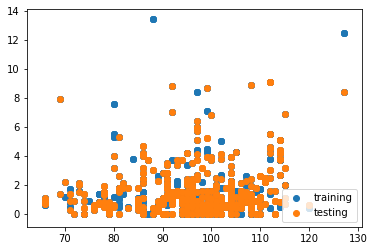

In [206]:
def data_scatter():
    """
    This function helps you visualize the training and testing sets by drawing a scatter plot of the data points.
    Feel free to change the function in any ways to create your own visuals. 
    """
    plt.figure()
    plt.scatter(X_train, y_train, label='training')
    plt.scatter(X_test, y_test, label='testing')
    plt.legend(loc=4)

# Remember to comment it out before submitting the notebook
data_scatter()

In [207]:
linregb = LinearRegression().fit(X_train.reshape(-1,1), y_train)

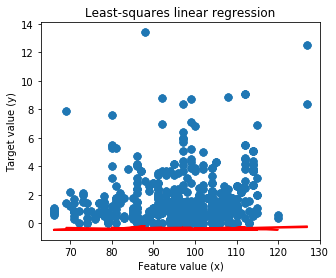

In [208]:
plt.figure(figsize=(5,4))
plt.scatter(aiq_blocksteals_merged['Reaction Time'].to_numpy(), aiq_blocksteals_merged['block_percentage'].to_numpy(), marker= 'o', s=50, alpha=0.8)
plt.plot(aiq_blocksteals_merged['Reaction Time'].to_numpy(), linregb.coef_ * aiq_blocksteals_merged['block_percentage'].to_numpy() + linregb.intercept_, 'r-')
plt.title('Least-squares linear regression')
plt.xlabel('Feature value (x)')
plt.ylabel('Target value (y)')
plt.show()

In [209]:
print('Block Percentage')
print('linear model intercept: {}'
     .format(linregb.intercept_))
print('linear model coeff:\n{}'
     .format(linregb.coef_))
print('R-squared score (training): {:.3f}'
     .format(linregb.score(X_train.reshape(-1,1), y_train)))
print('R-squared score (test): {:.3f}'
     .format(linregb.score(X_test.reshape(-1,1), y_test)))

Block Percentage
linear model intercept: -0.462610788061387
linear model coeff:
[0.02120499]
R-squared score (training): 0.020
R-squared score (test): 0.039


In [225]:
#Steals

In [226]:
X_trainS, X_testS, y_trainS, y_testS = train_test_split(aiq_blocksteals_merged['Reaction Time'].to_numpy(), aiq_blocksteals_merged['steal_percentage'].to_numpy(), random_state=0)

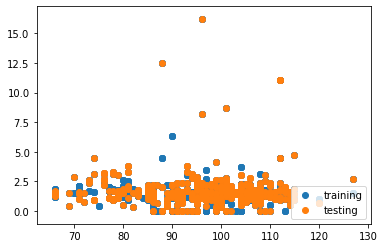

In [227]:
def data_scatterS():
    """
    This function helps you visualize the training and testing sets by drawing a scatter plot of the data points.
    Feel free to change the function in any ways to create your own visuals. 
    """
    plt.figure()
    plt.scatter(X_trainS, y_trainS, label='training')
    plt.scatter(X_testS, y_testS, label='testing')
    plt.legend(loc=4)

# Remember to comment it out before submitting the notebook
data_scatterS()

In [228]:
linregS = LinearRegression().fit(X_trainS.reshape(-1,1), y_trainS)

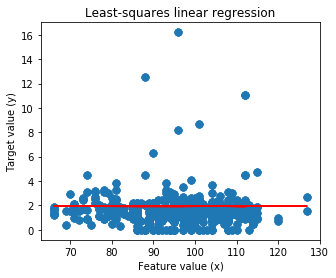

In [229]:
plt.figure(figsize=(5,4))
plt.scatter(aiq_blocksteals_merged['Reaction Time'].to_numpy(), aiq_blocksteals_merged['steal_percentage'].to_numpy(), marker= 'o', s=50, alpha=0.8)
plt.plot(aiq_blocksteals_merged['Reaction Time'].to_numpy(), linregS.coef_ * aiq_blocksteals_merged['steal_percentage'].to_numpy() + linregS.intercept_, 'r-')
plt.title('Least-squares linear regression')
plt.xlabel('Feature value (x)')
plt.ylabel('Target value (y)')
plt.show()

In [230]:
print('Steal Percentage')
print('linear model intercept: {}'
     .format(linregS.intercept_))
print('linear model coeff:\n{}'
     .format(linregS.coef_))
print('R-squared score (training): {:.3f}'
     .format(linregS.score(X_trainS.reshape(-1,1), y_trainS)))
print('R-squared score (test): {:.3f}'
     .format(linregS.score(X_testS.reshape(-1,1), y_testS)))

Steal Percentage
linear model intercept: 1.958028836187916
linear model coeff:
[-0.00429278]
R-squared score (training): 0.002
R-squared score (test): -0.004


Block Poly

In [240]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.datasets import make_friedman1
from sklearn.model_selection import train_test_split
import matplotlib.colors

degs = (1, 3, 7, 11, 15, 21)  # this will be useful later
#degs = (1,3)

def polylin(X_train,y_train):
    preds = None
    # YOUR CODE HERE
    preds = np.empty([0,100])
    for deg in degs:
        poly = PolynomialFeatures(degree=deg)
        X_F1_poly = poly.fit_transform(X_train.reshape(-1,1))
        linreg = LinearRegression().fit(X_F1_poly, y_train)
        preddeg = linreg.predict(poly.fit_transform(np.linspace(65,120,100).reshape(-1,1)))
        preds = np.append(preds,preddeg)
    #raise NotImplementedError()
    
    #return np.transpose(preds)
    return preds.reshape(6,100)

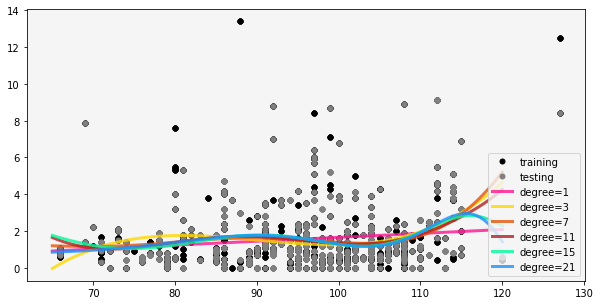

In [283]:
block_poly = polylin(X_train,y_train)
degs = (1, 3, 7, 11, 15, 21)
def plot_one(predictions):
    plt.figure(figsize=(10, 5))
    plt.rcParams['axes.facecolor'] = 'whitesmoke'
    plt.plot(X_train, y_train, 'o', label='training', markersize=5, color = 'black')
    plt.plot(X_test, y_test, 'o', label='testing', markersize=5, color = 'gray')
    colors = ['deeppink','gold',plt.cm.tab20c(4),
          'firebrick','mediumspringgreen','dodgerblue']

    #cmap=matplotlib.colors.ListedColormap(colors)

    x = np.arange(1,7)
    for i, deg in enumerate(degs):
        plt.plot(np.linspace(65, 120, 100), predictions[i], alpha=0.8, label=f"degree={deg}",color=colors[i],linewidth=3)
    plt.legend(loc=4)
    
    plt.savefig('PolynomialLinearRegression-BlockPercentageXReactionTime')

# Remember to comment it out before submitting the notebook
plot_one(block_poly)

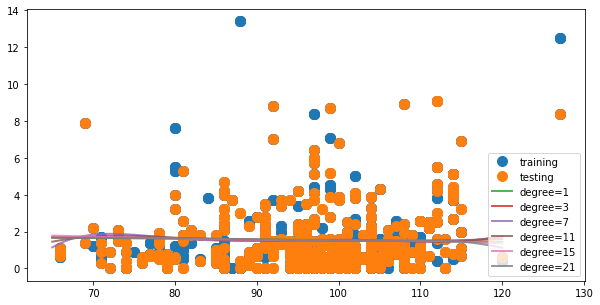

In [233]:
steal_poly = polylin(X_trainS,y_trainS)
degs = (1, 3, 7, 11, 15, 21)
def plot_one(predictions):
    plt.figure(figsize=(10, 5))
    plt.plot(X_train, y_train, 'o', label='training', markersize=10)
    plt.plot(X_test, y_test, 'o', label='testing', markersize=10)
    for i, deg in enumerate(degs):
        plt.plot(np.linspace(65, 120, 100), predictions[i], alpha=0.8, lw=2, label=f"degree={deg}")
    plt.legend(loc=4)

# Remember to comment it out before submitting the notebook
plot_one(steal_poly)